# Face Recognition Training dengan YOLOv11 Detection

 # Face Recognition Training Notebook

 Notebook ini akan melakukan training face recognition dengan:
 1. **YOLOv11 Face Detection** (pre-trained) - untuk detect dan crop faces
 2. **Custom Face Recognition** - untuk classify identitas

 ## Dataset Structure
 Expected struktur dataset dari Kaggle:
 ```
 face-recognition-dataset/
 ├── person1_name/
 │   ├── image1.jpg
 │   ├── image2.jpg
 │   └── ...
 ├── person2_name/
 │   ├── image1.jpg
 │   ├── image2.jpg
 │   └── ...
 └── ...
 ```

In [1]:
!pip install ultralytics
!pip install timm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 120.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 83.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 58.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 42.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [ ]:
import shutil

# Ganti dengan path folder yang ingin dihapus
# folder_path = "data/raw/face-recognition-dataset/Alia Bhatt"
folder_path = "clone"

# Hapus folder beserta semua isinya
shutil.rmtree(folder_path)

print(f"Folder '{folder_path}' berhasil dihapus.")

Folder 'clone' berhasil dihapus.


In [2]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("vasukipatel/face-recognition-dataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/face-recognition-dataset


In [3]:
import shutil
import os

# Create the destination directory if it doesn't exist
os.makedirs("clone", exist_ok=True)

dst_dir = "clone"

# Loop semua isi folder dan copy ke target
for item in os.listdir(path):
    s = os.path.join(path, item)
    d = os.path.join(dst_dir, item)
    if os.path.isdir(s):
        shutil.copytree(s, d)  # untuk folder
    else:
        shutil.copy2(s, d)     # untuk file

In [4]:
import os
import shutil

src_dir = "clone/Original Images/Original Images"
dst_dir = "data/raw/face-recognition-dataset"

# Buat folder tujuan jika belum ada
os.makedirs(dst_dir, exist_ok=True)

# Loop semua isi folder dan copy ke target
for item in os.listdir(src_dir):
    s = os.path.join(src_dir, item)
    d = os.path.join(dst_dir, item)
    if os.path.isdir(s):
        shutil.copytree(s, d)  # untuk folder
    else:
        shutil.copy2(s, d)     # untuk file

print("Isi folder 'Faces' berhasil disalin ke:", dst_dir)


Isi folder 'Faces' berhasil disalin ke: data/raw/face-recognition-dataset


## 1. Import Libraries dan Setup

In [5]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import json
import pickle
from tqdm.notebook import tqdm
import warnings
warnings.filterwarnings('ignore')

# PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision
import torchvision.transforms as transforms
from torchvision.models import resnet50

# Sklearn
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.preprocessing import LabelEncoder

# YOLO for face detection
from ultralytics import YOLO

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# Set random seeds for reproducibility
torch.manual_seed(42)
np.random.seed(42)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Using device: cuda


## 2. Configuration dan Paths

In [6]:
# Configuration
CONFIG = {
    # Paths
    'DATASET_PATH': 'data/raw/face-recognition-dataset',  # Path ke dataset Kaggle
    'OUTPUT_DIR': 'models/face_recognition',
    'YOLO_MODEL_PATH': 'models/yolov11s-face.pt',  # Path ke YOLOv11 face detection model

    # Training parameters
    'BATCH_SIZE': 32,
    'LEARNING_RATE': 0.001,
    'NUM_EPOCHS': 50,
    'IMAGE_SIZE': 224,
    'EMBEDDING_DIM': 512,

    # Face detection parameters
    'DETECTION_CONF': 0.5,
    'MIN_FACE_SIZE': 50,

    # Data split
    'TRAIN_RATIO': 0.7,
    'VAL_RATIO': 0.2,
    'TEST_RATIO': 0.1,
}

# Create output directories
Path(CONFIG['OUTPUT_DIR']).mkdir(parents=True, exist_ok=True)

print("Configuration:")
for key, value in CONFIG.items():
    print(f"  {key}: {value}")

Configuration:
  DATASET_PATH: data/raw/face-recognition-dataset
  OUTPUT_DIR: models/face_recognition
  YOLO_MODEL_PATH: models/yolov11s-face.pt
  BATCH_SIZE: 32
  LEARNING_RATE: 0.001
  NUM_EPOCHS: 50
  IMAGE_SIZE: 224
  EMBEDDING_DIM: 512
  DETECTION_CONF: 0.5
  MIN_FACE_SIZE: 50
  TRAIN_RATIO: 0.7
  VAL_RATIO: 0.2
  TEST_RATIO: 0.1


## 3. Dataset Exploration

📁 Exploring dataset at: data/raw/face-recognition-dataset

📊 Dataset Statistics:
  Total persons: 31


Counting images:   0%|          | 0/31 [00:00<?, ?it/s]

  Total images: 2562
  Average images per person: 82.6
  Min images per person: 30
  Max images per person: 120

🔝 Top 10 persons with most images:
   1. Brad Pitt: 120 images
   2. Vijay Deverakonda: 115 images
   3. Robert Downey Jr: 113 images
   4. Hugh Jackman: 112 images
   5. Jessica Alba: 108 images
   6. Henry Cavill: 106 images
   7. Natalie Portman: 105 images
   8. Priyanka Chopra: 102 images
   9. Hrithik Roshan: 101 images
  10. Billie Eilish: 98 images


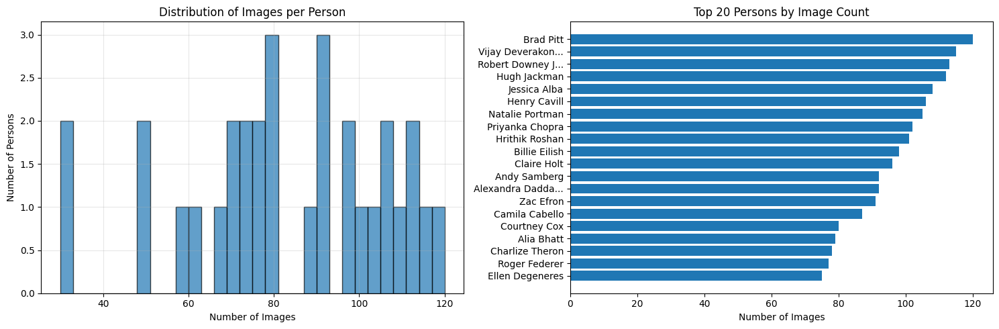

In [7]:
def explore_dataset(dataset_path):
    """Explore dataset structure and statistics"""
    dataset_path = Path(dataset_path)

    if not dataset_path.exists():
        print(f"❌ Dataset not found at: {dataset_path}")
        print("Please make sure you have downloaded the dataset from:")
        print("https://www.kaggle.com/datasets/cybersimar08/face-recognition-dataset")
        return None

    print(f"📁 Exploring dataset at: {dataset_path}")

    # Get all person folders
    person_folders = [f for f in dataset_path.iterdir() if f.is_dir()]
    person_names = [f.name for f in person_folders]

    print(f"\n📊 Dataset Statistics:")
    print(f"  Total persons: {len(person_names)}")

    # Count images per person
    person_image_counts = {}
    total_images = 0

    for person_folder in tqdm(person_folders, desc="Counting images"):
        person_name = person_folder.name
        image_files = list(person_folder.glob('*.jpg')) + list(person_folder.glob('*.png')) + list(person_folder.glob('*.jpeg'))
        image_count = len(image_files)
        person_image_counts[person_name] = image_count
        total_images += image_count

    print(f"  Total images: {total_images}")
    print(f"  Average images per person: {total_images/len(person_names):.1f}")
    print(f"  Min images per person: {min(person_image_counts.values())}")
    print(f"  Max images per person: {max(person_image_counts.values())}")

    # Show top 10 persons with most images
    sorted_counts = sorted(person_image_counts.items(), key=lambda x: x[1], reverse=True)
    print(f"\n🔝 Top 10 persons with most images:")
    for i, (person, count) in enumerate(sorted_counts[:10]):
        print(f"  {i+1:2d}. {person}: {count} images")

    # Plot distribution
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 2, 1)
    counts = list(person_image_counts.values())
    plt.hist(counts, bins=30, alpha=0.7, edgecolor='black')
    plt.xlabel('Number of Images')
    plt.ylabel('Number of Persons')
    plt.title('Distribution of Images per Person')
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 2, 2)
    # Show top 20 persons
    top_20 = sorted_counts[:20]
    names = [name[:15] + '...' if len(name) > 15 else name for name, _ in top_20]
    counts = [count for _, count in top_20]

    plt.barh(names, counts)
    plt.xlabel('Number of Images')
    plt.title('Top 20 Persons by Image Count')
    plt.gca().invert_yaxis()

    plt.tight_layout()
    plt.show()

    return {
        'person_names': person_names,
        'person_image_counts': person_image_counts,
        'total_images': total_images,
        'total_persons': len(person_names)
    }

# Explore dataset
dataset_info = explore_dataset(CONFIG['DATASET_PATH'])

## 4. YOLOv11 Face Detection Setup

In [8]:
import os
import cv2
import urllib.request
from pathlib import Path
from ultralytics import YOLO

class YOLOFaceDetector:
    def __init__(self, model_path, conf_threshold=0.5):
        """Initialize YOLO face detector"""
        self.model_path = model_path
        self.conf_threshold = conf_threshold

        # Check if model exists, if not then download it
        if not Path(model_path).exists():
            print(f"❌ YOLOv11 model not found at: {model_path}")
            self.download_model(model_path)

        # Load model
        self.model = YOLO(model_path)
        print(f"✅ YOLOv11 face detector loaded from: {model_path}")

    def download_model(self, path):
        """Download the YOLOv11 face detection model"""
        url = "https://github.com/akanametov/yolo-face/releases/download/v0.0.0/yolov11s-face.pt"
        os.makedirs(os.path.dirname(path), exist_ok=True)

        print("📥 Downloading YOLOv11 face model from:")
        print(url)
        try:
            urllib.request.urlretrieve(url, path)
            print("✅ Model successfully downloaded.")
        except Exception as e:
            print(f"❌ Failed to download model: {e}")
            raise FileNotFoundError(f"Failed to download model from {url}")

    def detect_faces(self, image):
        """Detect faces in image and return face crops with bounding boxes"""
        if isinstance(image, str):
            image = cv2.imread(image)

        if image is None:
            return []

        # Run detection
        results = self.model(image, conf=self.conf_threshold, verbose=False)

        faces = []
        for result in results:
            boxes = result.boxes
            if boxes is not None:
                for box in boxes:
                    # Get bounding box
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = float(box.conf[0])

                    # Ensure bbox is within image bounds
                    h, w = image.shape[:2]
                    x1 = max(0, min(x1, w - 1))
                    y1 = max(0, min(y1, h - 1))
                    x2 = max(x1 + 1, min(x2, w))
                    y2 = max(y1 + 1, min(y2, h))

                    # Extract face crop
                    face_crop = image[y1:y2, x1:x2]

                    # Check minimum size
                    if face_crop.shape[0] >= CONFIG['MIN_FACE_SIZE'] and face_crop.shape[1] >= CONFIG['MIN_FACE_SIZE']:
                        faces.append({
                            'bbox': (x1, y1, x2, y2),
                            'confidence': confidence,
                            'face_crop': face_crop
                        })

        return faces

# Inisialisasi face detector
print("🔍 Initializing YOLOv11 face detector...")
try:
    face_detector = YOLOFaceDetector(CONFIG['YOLO_MODEL_PATH'], CONFIG['DETECTION_CONF'])
except FileNotFoundError as e:
    print(f"\n❌ Gagal menginisialisasi face detector: {e}")
    face_detector = None

🔍 Initializing YOLOv11 face detector...
❌ YOLOv11 model not found at: models/yolov11s-face.pt
📥 Downloading YOLOv11 face model from:
https://github.com/akanametov/yolo-face/releases/download/v0.0.0/yolov11s-face.pt
✅ Model successfully downloaded.
✅ YOLOv11 face detector loaded from: models/yolov11s-face.pt


## 5. Test Face Detection

🧪 Testing face detection on sample images...


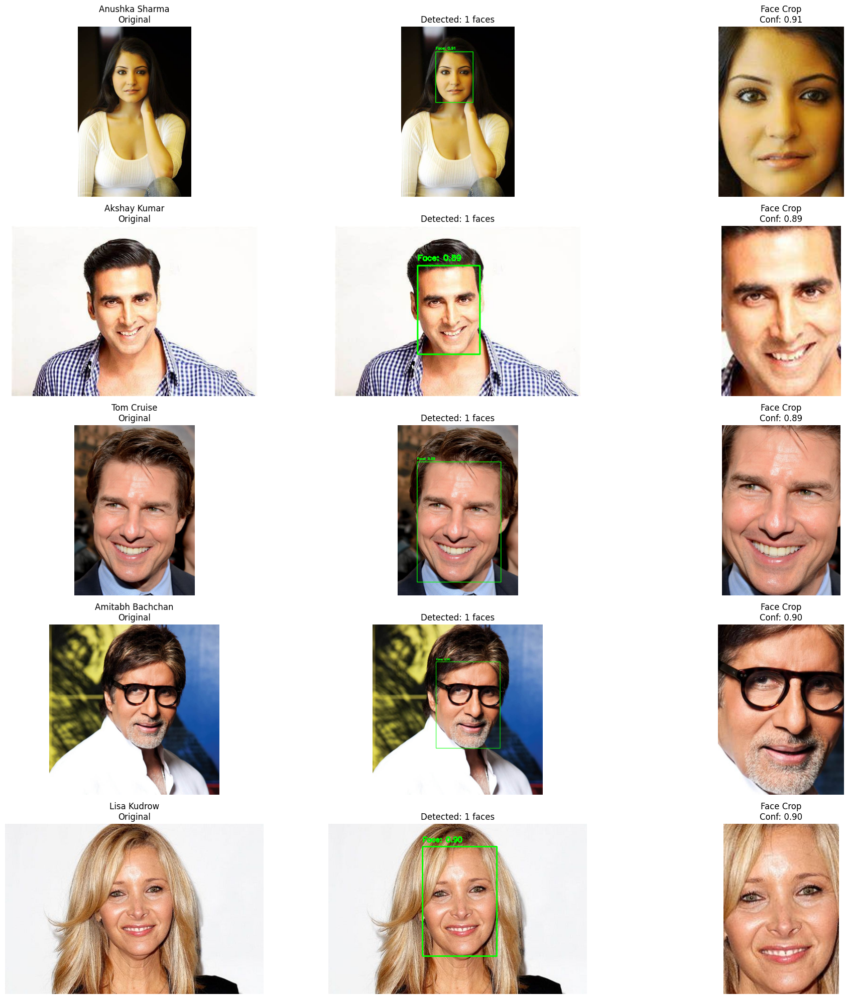

In [9]:
def test_face_detection(dataset_path, face_detector, num_samples=5):
    """Test face detection on sample images"""
    if face_detector is None:
        print("Face detector not available")
        return

    dataset_path = Path(dataset_path)
    person_folders = [f for f in dataset_path.iterdir() if f.is_dir()]

    # Sample random images
    sample_images = []
    for i, person_folder in enumerate(person_folders[:num_samples]):
        image_files = list(person_folder.glob('*.jpg')) + list(person_folder.glob('*.png'))
        if image_files:
            sample_images.append((person_folder.name, image_files[0]))

    plt.figure(figsize=(20, 4*len(sample_images)))

    for i, (person_name, image_path) in enumerate(sample_images):
        # Load image
        image = cv2.imread(str(image_path))
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Detect faces
        faces = face_detector.detect_faces(image)

        # Draw results
        annotated_image = image_rgb.copy()
        for face in faces:
            x1, y1, x2, y2 = face['bbox']
            confidence = face['confidence']
            cv2.rectangle(annotated_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(annotated_image, f'Face: {confidence:.2f}', (x1, y1-10),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Show original and detected
        plt.subplot(len(sample_images), 3, i*3 + 1)
        plt.imshow(image_rgb)
        plt.title(f'{person_name}\nOriginal')
        plt.axis('off')

        plt.subplot(len(sample_images), 3, i*3 + 2)
        plt.imshow(annotated_image)
        plt.title(f'Detected: {len(faces)} faces')
        plt.axis('off')

        # Show first face crop if available
        plt.subplot(len(sample_images), 3, i*3 + 3)
        if faces:
            face_crop = cv2.cvtColor(faces[0]['face_crop'], cv2.COLOR_BGR2RGB)
            plt.imshow(face_crop)
            plt.title(f'Face Crop\nConf: {faces[0]["confidence"]:.2f}')
        else:
            plt.text(0.5, 0.5, 'No Face\nDetected', ha='center', va='center', fontsize=12)
            plt.title('No Face Detected')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Test face detection
if dataset_info and face_detector:
    print("🧪 Testing face detection on sample images...")
    test_face_detection(CONFIG['DATASET_PATH'], face_detector)

## 6. Dataset Preparation untuk Training

In [10]:
def prepare_face_dataset(dataset_path, face_detector, output_dir, target_size=(224, 224)):
    """
    Prepare face dataset by detecting and cropping faces from original images
    """
    dataset_path = Path(dataset_path)
    output_dir = Path(output_dir)

    print(f"📝 Preparing face dataset...")
    print(f"  Input: {dataset_path}")
    print(f"  Output: {output_dir}")

    # Create output directories
    for split in ['train', 'val', 'test']:
        (output_dir / split).mkdir(parents=True, exist_ok=True)

    # Get all person folders
    person_folders = [f for f in dataset_path.iterdir() if f.is_dir()]
    person_names = [f.name for f in person_folders]

    # Filter persons with sufficient images (at least 10 images)
    filtered_persons = []
    for person_folder in person_folders:
        image_files = list(person_folder.glob('*.jpg')) + list(person_folder.glob('*.png')) + list(person_folder.glob('*.jpeg'))
        if len(image_files) >= 10:  # Minimum 10 images per person
            filtered_persons.append((person_folder.name, person_folder, image_files))

    print(f"  Filtered persons (>=10 images): {len(filtered_persons)}")

    all_face_data = []
    detection_stats = {'total_images': 0, 'images_with_faces': 0, 'total_faces_extracted': 0}

    # Process each person
    for person_name, person_folder, image_files in tqdm(filtered_persons, desc="Processing persons"):
        person_faces = []

        for img_path in tqdm(image_files, desc=f"Processing {person_name}", leave=False):
            try:
                detection_stats['total_images'] += 1

                # Detect faces
                faces = face_detector.detect_faces(str(img_path))

                if faces:
                    detection_stats['images_with_faces'] += 1

                    # Take the face with highest confidence
                    best_face = max(faces, key=lambda x: x['confidence'])
                    face_crop = best_face['face_crop']

                    # Resize face
                    face_resized = cv2.resize(face_crop, target_size)

                    person_faces.append({
                        'face': face_resized,
                        'person': person_name,
                        'confidence': best_face['confidence'],
                        'original_path': str(img_path)
                    })

                    detection_stats['total_faces_extracted'] += 1

            except Exception as e:
                print(f"  Error processing {img_path}: {e}")

        # Only keep persons with at least 5 faces detected
        if len(person_faces) >= 5:
            all_face_data.extend(person_faces)
        else:
            print(f"  Skipping {person_name}: only {len(person_faces)} faces detected")

    print(f"\n📊 Detection Statistics:")
    print(f"  Total images processed: {detection_stats['total_images']}")
    print(f"  Images with faces: {detection_stats['images_with_faces']}")
    print(f"  Total faces extracted: {detection_stats['total_faces_extracted']}")
    print(f"  Detection rate: {detection_stats['images_with_faces']/detection_stats['total_images']*100:.1f}%")

    # Group by person for stratified split
    persons_data = {}
    for face_data in all_face_data:
        person = face_data['person']
        if person not in persons_data:
            persons_data[person] = []
        persons_data[person].append(face_data)

    # Final filtering - keep persons with at least 10 faces
    final_persons = {}
    for person, faces in persons_data.items():
        if len(faces) >= 10:
            final_persons[person] = faces

    print(f"  Final persons (>=10 faces): {len(final_persons)}")

    # Split dataset
    train_data, val_data, test_data = [], [], []

    for person, faces in final_persons.items():
        # Stratified split per person
        n_faces = len(faces)
        n_train = int(n_faces * CONFIG['TRAIN_RATIO'])
        n_val = int(n_faces * CONFIG['VAL_RATIO'])
        n_test = n_faces - n_train - n_val

        # Shuffle faces
        np.random.shuffle(faces)

        train_data.extend(faces[:n_train])
        val_data.extend(faces[n_train:n_train+n_val])
        test_data.extend(faces[n_train+n_val:])

    print(f"\n📊 Dataset Split:")
    print(f"  Train: {len(train_data)} faces")
    print(f"  Val: {len(val_data)} faces")
    print(f"  Test: {len(test_data)} faces")

    # Save splits
    def save_split(data, split_name):
        split_dir = output_dir / split_name
        for person in final_persons.keys():
            (split_dir / person).mkdir(exist_ok=True)

        for i, face_data in enumerate(data):
            person = face_data['person']
            face_image = face_data['face']

            filename = f"{person}_{i:06d}.jpg"
            filepath = split_dir / person / filename

            cv2.imwrite(str(filepath), face_image)

    save_split(train_data, 'train')
    save_split(val_data, 'val')
    save_split(test_data, 'test')

    # Save dataset info
    dataset_info = {
        'num_classes': len(final_persons),
        'class_names': list(final_persons.keys()),
        'train_samples': len(train_data),
        'val_samples': len(val_data),
        'test_samples': len(test_data),
        'total_samples': len(train_data) + len(val_data) + len(test_data),
        'detection_stats': detection_stats,
        'target_size': target_size
    }

    with open(output_dir / 'dataset_info.json', 'w') as f:
        json.dump(dataset_info, f, indent=2)

    # Save class names
    with open(output_dir / 'classes.txt', 'w') as f:
        for class_name in final_persons.keys():
            f.write(f"{class_name}\n")

    print(f"\n✅ Dataset preparation completed!")
    print(f"  Output directory: {output_dir}")
    print(f"  Classes: {len(final_persons)}")

    return dataset_info

# Prepare dataset
if dataset_info and face_detector:
    processed_dataset_info = prepare_face_dataset(
        CONFIG['DATASET_PATH'],
        face_detector,
        CONFIG['OUTPUT_DIR'] + '/processed'
    )
else:
    print("⚠️ Cannot prepare dataset - detector not available or dataset not found")
    processed_dataset_info = None

📝 Preparing face dataset...
  Input: data/raw/face-recognition-dataset
  Output: models/face_recognition/processed
  Filtered persons (>=10 images): 31


Processing persons:   0%|          | 0/31 [00:00<?, ?it/s]

Processing Anushka Sharma:   0%|          | 0/68 [00:00<?, ?it/s]

Processing Akshay Kumar:   0%|          | 0/50 [00:00<?, ?it/s]

Processing Tom Cruise:   0%|          | 0/58 [00:00<?, ?it/s]

Processing Amitabh Bachchan:   0%|          | 0/74 [00:00<?, ?it/s]

Processing Lisa Kudrow:   0%|          | 0/70 [00:00<?, ?it/s]

Processing Andy Samberg:   0%|          | 0/92 [00:00<?, ?it/s]

Processing Virat Kohli:   0%|          | 0/49 [00:00<?, ?it/s]

Processing Henry Cavill:   0%|          | 0/106 [00:00<?, ?it/s]

Processing Camila Cabello:   0%|          | 0/87 [00:00<?, ?it/s]

Processing Brad Pitt:   0%|          | 0/120 [00:00<?, ?it/s]

Processing Roger Federer:   0%|          | 0/77 [00:00<?, ?it/s]

Processing Courtney Cox:   0%|          | 0/80 [00:00<?, ?it/s]

Processing Kashyap:   0%|          | 0/30 [00:00<?, ?it/s]

Processing Priyanka Chopra:   0%|          | 0/102 [00:00<?, ?it/s]

Processing Alia Bhatt:   0%|          | 0/79 [00:00<?, ?it/s]

Processing Billie Eilish:   0%|          | 0/98 [00:00<?, ?it/s]

Processing Zac Efron:   0%|          | 0/91 [00:00<?, ?it/s]

Processing Hugh Jackman:   0%|          | 0/112 [00:00<?, ?it/s]

Processing Jessica Alba:   0%|          | 0/108 [00:00<?, ?it/s]

Processing Vijay Deverakonda:   0%|          | 0/115 [00:00<?, ?it/s]

Processing Marmik:   0%|          | 0/32 [00:00<?, ?it/s]

Processing Alexandra Daddario:   0%|          | 0/92 [00:00<?, ?it/s]

Processing Charlize Theron:   0%|          | 0/78 [00:00<?, ?it/s]

Processing Margot Robbie:   0%|          | 0/72 [00:00<?, ?it/s]

Processing Dwayne Johnson:   0%|          | 0/61 [00:00<?, ?it/s]

Processing Robert Downey Jr:   0%|          | 0/113 [00:00<?, ?it/s]

Processing Ellen Degeneres:   0%|          | 0/75 [00:00<?, ?it/s]

Processing Natalie Portman:   0%|          | 0/105 [00:00<?, ?it/s]

Processing Elizabeth Olsen:   0%|          | 0/71 [00:00<?, ?it/s]

Processing Hrithik Roshan:   0%|          | 0/101 [00:00<?, ?it/s]

Processing Claire Holt:   0%|          | 0/96 [00:00<?, ?it/s]


📊 Detection Statistics:
  Total images processed: 2562
  Images with faces: 2557
  Total faces extracted: 2557
  Detection rate: 99.8%
  Final persons (>=10 faces): 31

📊 Dataset Split:
  Train: 1777 faces
  Val: 502 faces
  Test: 278 faces

✅ Dataset preparation completed!
  Output directory: models/face_recognition/processed
  Classes: 31


## 7. Face Recognition Model Definition

In [ ]:
class FaceRecognitionModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512, dropout=0.5):
        super(FaceRecognitionModel, self).__init__()

        # Use ResNet50 as backbone
        self.backbone = resnet50(pretrained=True)

        # Replace final layer
        in_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Identity()  # Remove original fc layer

        # Add custom layers
        self.embedding = nn.Sequential(
            nn.Linear(in_features, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout)
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)

        self.embedding_dim = embedding_dim

    def forward(self, x):
        # Extract features
        features = self.backbone(x)  # [batch_size, in_features]

        # Get embeddings
        embeddings = self.embedding(features)  # [batch_size, embedding_dim]

        # Normalize embeddings
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits

# Test model
if processed_dataset_info:
    num_classes = processed_dataset_info['num_classes']
    print(f"Creating model for {num_classes} classes...")

    model = FaceRecognitionModel(num_classes, CONFIG['EMBEDDING_DIM'])
    model = model.to(device)

    # Test forward pass
    dummy_input = torch.randn(2, 3, CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE']).to(device)
    embeddings, logits = model(dummy_input)

    print(f"Model created successfully!")
    print(f"  Embeddings shape: {embeddings.shape}")
    print(f"  Logits shape: {logits.shape}")
    print(f"  Parameters: {sum(p.numel() for p in model.parameters()):,}")
else:
    print("⚠️ Cannot create model - dataset info not available")
    model = None

Creating model for 31 classes...
Model created successfully!
  Embeddings shape: torch.Size([2, 512])
  Logits shape: torch.Size([2, 31])
  Parameters: 24,574,047


## 8. Dataset dan DataLoader

In [11]:
class FaceDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = Path(root_dir)
        self.transform = transform

        # Get all image paths and labels
        self.samples = []
        self.classes = []

        for class_dir in self.root_dir.iterdir():
            if class_dir.is_dir():
                class_name = class_dir.name
                if class_name not in self.classes:
                    self.classes.append(class_name)

                class_idx = self.classes.index(class_name)

                for img_path in class_dir.glob('*.jpg'):
                    self.samples.append((str(img_path), class_idx))

        print(f"Loaded {len(self.samples)} samples from {len(self.classes)} classes")

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label = self.samples[idx]

        # Load image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform:
            image = self.transform(image)

        return image, label

# Data transforms
train_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE'])),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE'])),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create datasets and dataloaders
if processed_dataset_info:
    processed_dir = Path(CONFIG['OUTPUT_DIR']) / 'processed'

    train_dataset = FaceDataset(processed_dir / 'train', transform=train_transform)
    val_dataset = FaceDataset(processed_dir / 'val', transform=val_transform)
    test_dataset = FaceDataset(processed_dir / 'test', transform=val_transform)

    train_loader = DataLoader(train_dataset, batch_size=CONFIG['BATCH_SIZE'], shuffle=True, num_workers=4, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=CONFIG['BATCH_SIZE'], shuffle=False, num_workers=4, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=CONFIG['BATCH_SIZE'], shuffle=False, num_workers=4, pin_memory=True)

    print(f"✅ DataLoaders created:")
    print(f"  Train: {len(train_loader)} batches ({len(train_dataset)} samples)")
    print(f"  Val: {len(val_loader)} batches ({len(val_dataset)} samples)")
    print(f"  Test: {len(test_loader)} batches ({len(test_dataset)} samples)")
else:
    print("⚠️ Cannot create dataloaders - processed dataset not available")
    train_loader = val_loader = test_loader = None

Loaded 1777 samples from 31 classes
Loaded 502 samples from 31 classes
Loaded 278 samples from 31 classes
✅ DataLoaders created:
  Train: 56 batches (1777 samples)
  Val: 16 batches (502 samples)
  Test: 9 batches (278 samples)


## 9. Training Setup

In [ ]:
def train_model(model, train_loader, val_loader, num_epochs, learning_rate, device):
    """Train the face recognition model"""

    # Loss and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=15, gamma=0.1)

    # Training history
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': [],
        'learning_rates': []
    }

    best_val_acc = 0.0
    best_model_state = None

    print(f"Starting training for {num_epochs} epochs...")
    print(f"Device: {device}")
    print(f"Learning rate: {learning_rate}")

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        print("-" * 50)

        # Training phase
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0

        train_pbar = tqdm(train_loader, desc='Training')
        for batch_idx, (inputs, labels) in enumerate(train_pbar):
            inputs, labels = inputs.to(device), labels.to(device)

            # Zero gradients
            optimizer.zero_grad()

            # Forward pass
            embeddings, logits = model(inputs)
            loss = criterion(logits, labels)

            # Backward pass
            loss.backward()
            optimizer.step()

            # Statistics
            running_loss += loss.item()
            _, predicted = torch.max(logits.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            # Update progress bar
            train_pbar.set_postfix({
                'Loss': f'{running_loss/(batch_idx+1):.4f}',
                'Acc': f'{100.*correct/total:.2f}%'
            })

        train_loss = running_loss / len(train_loader)
        train_acc = 100. * correct / total

        # Validation phase
        model.eval()
        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            val_pbar = tqdm(val_loader, desc='Validation')
            for inputs, labels in val_pbar:
                inputs, labels = inputs.to(device), labels.to(device)

                embeddings, logits = model(inputs)
                loss = criterion(logits, labels)

                val_running_loss += loss.item()
                _, predicted = torch.max(logits.data, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()

                val_pbar.set_postfix({
                    'Loss': f'{val_running_loss/(len(val_pbar)):.4f}',
                    'Acc': f'{100.*val_correct/val_total:.2f}%'
                })

        val_loss = val_running_loss / len(val_loader)
        val_acc = 100. * val_correct / val_total

        # Update scheduler
        scheduler.step()
        current_lr = optimizer.param_groups[0]['lr']

        # Save history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['learning_rates'].append(current_lr)

        # Print epoch results
        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}%")
        print(f"Val Loss: {val_loss:.4f} | Val Acc: {val_acc:.2f}%")
        print(f"Learning Rate: {current_lr:.6f}")

        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = model.state_dict().copy()
            print(f"✅ New best model! Val Acc: {val_acc:.2f}%")

    # Load best model
    if best_model_state:
        model.load_state_dict(best_model_state)

    print(f"\n🎉 Training completed!")
    print(f"Best validation accuracy: {best_val_acc:.2f}%")

    return model, history

## 10. Start Training

In [ ]:
if model and train_loader and val_loader:
    print("🚀 Starting training...")

    trained_model, training_history = train_model(
        model=model,
        train_loader=train_loader,
        val_loader=val_loader,
        num_epochs=CONFIG['NUM_EPOCHS'],
        learning_rate=CONFIG['LEARNING_RATE'],
        device=device
    )

    print("✅ Training completed!")

else:
    print("⚠️ Cannot start training - model or dataloaders not available")
    trained_model = training_history = None

🚀 Starting training...
Starting training for 50 epochs...
Device: cuda
Learning rate: 0.001

Epoch 1/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 3.2732 | Train Acc: 17.73%
Val Loss: 3.2432 | Val Acc: 15.32%
Learning Rate: 0.001000
✅ New best model! Val Acc: 15.32%

Epoch 2/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 3.0045 | Train Acc: 22.59%
Val Loss: 2.8436 | Val Acc: 14.93%
Learning Rate: 0.001000

Epoch 3/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.7962 | Train Acc: 24.25%
Val Loss: 2.6141 | Val Acc: 21.27%
Learning Rate: 0.001000
✅ New best model! Val Acc: 21.27%

Epoch 4/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.6165 | Train Acc: 28.42%
Val Loss: 2.5368 | Val Acc: 24.57%
Learning Rate: 0.001000
✅ New best model! Val Acc: 24.57%

Epoch 5/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.4816 | Train Acc: 31.63%
Val Loss: 2.3625 | Val Acc: 26.95%
Learning Rate: 0.001000
✅ New best model! Val Acc: 26.95%

Epoch 6/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.3619 | Train Acc: 34.50%
Val Loss: 2.0849 | Val Acc: 34.48%
Learning Rate: 0.001000
✅ New best model! Val Acc: 34.48%

Epoch 7/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.2489 | Train Acc: 35.94%
Val Loss: 1.9594 | Val Acc: 39.76%
Learning Rate: 0.001000
✅ New best model! Val Acc: 39.76%

Epoch 8/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.1195 | Train Acc: 40.10%
Val Loss: 1.9394 | Val Acc: 38.97%
Learning Rate: 0.001000

Epoch 9/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 2.0369 | Train Acc: 41.47%
Val Loss: 1.7716 | Val Acc: 45.84%
Learning Rate: 0.001000
✅ New best model! Val Acc: 45.84%

Epoch 10/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.9217 | Train Acc: 45.78%
Val Loss: 1.7918 | Val Acc: 42.80%
Learning Rate: 0.001000

Epoch 11/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.8393 | Train Acc: 47.73%
Val Loss: 1.6472 | Val Acc: 46.24%
Learning Rate: 0.001000
✅ New best model! Val Acc: 46.24%

Epoch 12/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.7491 | Train Acc: 50.83%
Val Loss: 1.6413 | Val Acc: 44.39%
Learning Rate: 0.001000

Epoch 13/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.6913 | Train Acc: 52.82%
Val Loss: 1.5218 | Val Acc: 49.54%
Learning Rate: 0.001000
✅ New best model! Val Acc: 49.54%

Epoch 14/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.6134 | Train Acc: 53.70%
Val Loss: 1.5110 | Val Acc: 49.67%
Learning Rate: 0.001000
✅ New best model! Val Acc: 49.67%

Epoch 15/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.5368 | Train Acc: 56.95%
Val Loss: 1.3240 | Val Acc: 56.54%
Learning Rate: 0.000100
✅ New best model! Val Acc: 56.54%

Epoch 16/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.3970 | Train Acc: 63.73%
Val Loss: 1.0779 | Val Acc: 65.79%
Learning Rate: 0.000100
✅ New best model! Val Acc: 65.79%

Epoch 17/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.3417 | Train Acc: 65.83%
Val Loss: 1.0422 | Val Acc: 67.37%
Learning Rate: 0.000100
✅ New best model! Val Acc: 67.37%

Epoch 18/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.3186 | Train Acc: 66.64%
Val Loss: 1.0244 | Val Acc: 69.09%
Learning Rate: 0.000100
✅ New best model! Val Acc: 69.09%

Epoch 19/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2929 | Train Acc: 68.01%
Val Loss: 1.0093 | Val Acc: 68.56%
Learning Rate: 0.000100

Epoch 20/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2792 | Train Acc: 68.56%
Val Loss: 0.9870 | Val Acc: 70.15%
Learning Rate: 0.000100
✅ New best model! Val Acc: 70.15%

Epoch 21/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2541 | Train Acc: 70.88%
Val Loss: 0.9692 | Val Acc: 70.67%
Learning Rate: 0.000100
✅ New best model! Val Acc: 70.67%

Epoch 22/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2459 | Train Acc: 69.55%
Val Loss: 0.9529 | Val Acc: 71.47%
Learning Rate: 0.000100
✅ New best model! Val Acc: 71.47%

Epoch 23/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2264 | Train Acc: 72.06%
Val Loss: 0.9350 | Val Acc: 71.99%
Learning Rate: 0.000100
✅ New best model! Val Acc: 71.99%

Epoch 24/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.2039 | Train Acc: 72.61%
Val Loss: 0.9215 | Val Acc: 72.52%
Learning Rate: 0.000100
✅ New best model! Val Acc: 72.52%

Epoch 25/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1874 | Train Acc: 73.46%
Val Loss: 0.8979 | Val Acc: 74.90%
Learning Rate: 0.000100
✅ New best model! Val Acc: 74.90%

Epoch 26/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1734 | Train Acc: 74.05%
Val Loss: 0.8831 | Val Acc: 74.24%
Learning Rate: 0.000100

Epoch 27/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1576 | Train Acc: 74.86%
Val Loss: 0.8726 | Val Acc: 73.71%
Learning Rate: 0.000100

Epoch 28/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1408 | Train Acc: 75.23%
Val Loss: 0.8567 | Val Acc: 75.96%
Learning Rate: 0.000100
✅ New best model! Val Acc: 75.96%

Epoch 29/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1247 | Train Acc: 76.41%
Val Loss: 0.8418 | Val Acc: 76.09%
Learning Rate: 0.000100
✅ New best model! Val Acc: 76.09%

Epoch 30/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.1120 | Train Acc: 77.63%
Val Loss: 0.8278 | Val Acc: 76.62%
Learning Rate: 0.000010
✅ New best model! Val Acc: 76.62%

Epoch 31/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0877 | Train Acc: 78.33%
Val Loss: 0.8148 | Val Acc: 77.41%
Learning Rate: 0.000010
✅ New best model! Val Acc: 77.41%

Epoch 32/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0843 | Train Acc: 78.55%
Val Loss: 0.8116 | Val Acc: 77.41%
Learning Rate: 0.000010

Epoch 33/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0747 | Train Acc: 78.47%
Val Loss: 0.8053 | Val Acc: 77.81%
Learning Rate: 0.000010
✅ New best model! Val Acc: 77.81%

Epoch 34/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0720 | Train Acc: 78.84%
Val Loss: 0.8066 | Val Acc: 77.54%
Learning Rate: 0.000010

Epoch 35/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0792 | Train Acc: 79.06%
Val Loss: 0.8031 | Val Acc: 77.94%
Learning Rate: 0.000010
✅ New best model! Val Acc: 77.94%

Epoch 36/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0781 | Train Acc: 79.40%
Val Loss: 0.8032 | Val Acc: 78.20%
Learning Rate: 0.000010
✅ New best model! Val Acc: 78.20%

Epoch 37/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0696 | Train Acc: 79.32%
Val Loss: 0.7999 | Val Acc: 78.60%
Learning Rate: 0.000010
✅ New best model! Val Acc: 78.60%

Epoch 38/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0734 | Train Acc: 78.73%
Val Loss: 0.7976 | Val Acc: 77.68%
Learning Rate: 0.000010

Epoch 39/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0806 | Train Acc: 78.77%
Val Loss: 0.7970 | Val Acc: 78.86%
Learning Rate: 0.000010
✅ New best model! Val Acc: 78.86%

Epoch 40/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0652 | Train Acc: 79.54%
Val Loss: 0.7979 | Val Acc: 78.47%
Learning Rate: 0.000010

Epoch 41/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0603 | Train Acc: 80.35%
Val Loss: 0.7951 | Val Acc: 77.94%
Learning Rate: 0.000010

Epoch 42/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0633 | Train Acc: 79.91%
Val Loss: 0.7893 | Val Acc: 78.73%
Learning Rate: 0.000010

Epoch 43/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0627 | Train Acc: 79.73%
Val Loss: 0.7891 | Val Acc: 79.39%
Learning Rate: 0.000010
✅ New best model! Val Acc: 79.39%

Epoch 44/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0525 | Train Acc: 80.21%
Val Loss: 0.7895 | Val Acc: 78.47%
Learning Rate: 0.000010

Epoch 45/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0529 | Train Acc: 80.21%
Val Loss: 0.7829 | Val Acc: 78.47%
Learning Rate: 0.000001

Epoch 46/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0586 | Train Acc: 81.09%
Val Loss: 0.7828 | Val Acc: 79.13%
Learning Rate: 0.000001

Epoch 47/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0594 | Train Acc: 80.72%
Val Loss: 0.7868 | Val Acc: 78.47%
Learning Rate: 0.000001

Epoch 48/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0551 | Train Acc: 79.69%
Val Loss: 0.7953 | Val Acc: 77.28%
Learning Rate: 0.000001

Epoch 49/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0459 | Train Acc: 81.02%
Val Loss: 0.7820 | Val Acc: 79.13%
Learning Rate: 0.000001

Epoch 50/50
--------------------------------------------------


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Validation:   0%|          | 0/24 [00:00<?, ?it/s]

Train Loss: 1.0557 | Train Acc: 80.02%
Val Loss: 0.7868 | Val Acc: 78.60%
Learning Rate: 0.000001

🎉 Training completed!
Best validation accuracy: 79.39%
✅ Training completed!


## 11. Training Visualization

In [12]:
def plot_training_history(history):
    """Plot training history"""
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))

    # Loss curves
    axes[0, 0].plot(history['train_loss'], label='Train Loss', color='blue')
    axes[0, 0].plot(history['val_loss'], label='Val Loss', color='red')
    axes[0, 0].set_title('Model Loss')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)

    # Accuracy curves
    axes[0, 1].plot(history['train_acc'], label='Train Acc', color='blue')
    axes[0, 1].plot(history['val_acc'], label='Val Acc', color='red')
    axes[0, 1].set_title('Model Accuracy')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('Accuracy (%)')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3)

    # Learning rate
    axes[1, 0].plot(history['learning_rates'], color='green')
    axes[1, 0].set_title('Learning Rate')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('Learning Rate')
    axes[1, 0].set_yscale('log')
    axes[1, 0].grid(True, alpha=0.3)

    # Val accuracy zoomed
    axes[1, 1].plot(history['val_acc'], color='red', linewidth=2)
    axes[1, 1].set_title('Validation Accuracy (Detailed)')
    axes[1, 1].set_xlabel('Epoch')
    axes[1, 1].set_ylabel('Accuracy (%)')
    axes[1, 1].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Print final stats
    print("📊 Training Summary:")
    print(f"  Final Train Acc: {history['train_acc'][-1]:.2f}%")
    print(f"  Final Val Acc: {history['val_acc'][-1]:.2f}%")
    print(f"  Best Val Acc: {max(history['val_acc']):.2f}%")
    print(f"  Final Train Loss: {history['train_loss'][-1]:.4f}")
    print(f"  Final Val Loss: {history['val_loss'][-1]:.4f}")

# if training_history:
#     plot_training_history(training_history)

## 12. Model Evaluation on Test Set

🧪 Evaluating model on test set...


Testing:   0%|          | 0/14 [00:00<?, ?it/s]

📊 Test Results:
  Test Accuracy: 78.96%

📋 Per-class Results:

📊 Showing confusion matrix for first 20 classes...


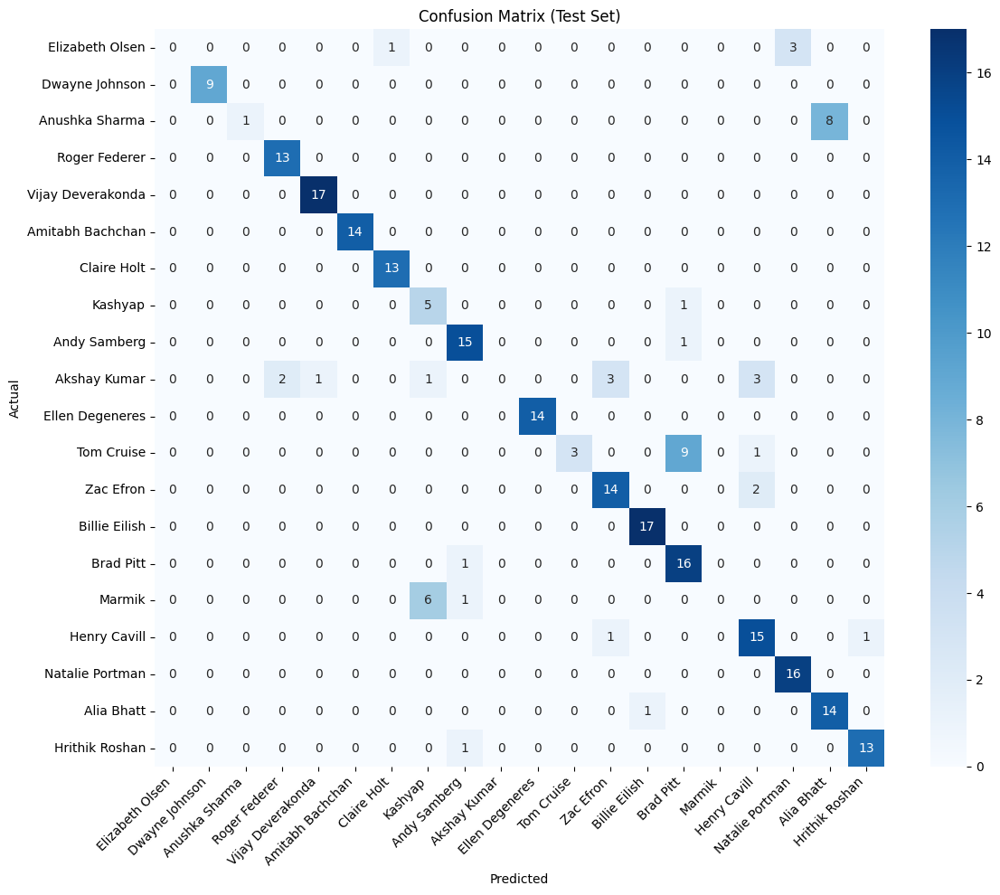

In [ ]:
def evaluate_model(model, test_loader, class_names, device):
    """Evaluate model on test set"""
    model.eval()

    all_preds = []
    all_labels = []
    all_embeddings = []

    print("🧪 Evaluating model on test set...")

    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc='Testing'):
            inputs, labels = inputs.to(device), labels.to(device)

            embeddings, logits = model(inputs)
            _, predicted = torch.max(logits, 1)

            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_embeddings.extend(embeddings.cpu().numpy())

    # Calculate accuracy
    accuracy = accuracy_score(all_labels, all_preds)

    print(f"📊 Test Results:")
    print(f"  Test Accuracy: {accuracy*100:.2f}%")

    # Classification report
    report = classification_report(all_labels, all_preds, target_names=class_names, output_dict=True)

    # Show per-class results
    print(f"\n📋 Per-class Results:")
    for i, class_name in enumerate(class_names):
        if str(i) in report:
            precision = report[str(i)]['precision']
            recall = report[str(i)]['recall']
            f1 = report[str(i)]['f1-score']
            support = report[str(i)]['support']
            print(f"  {class_name[:20]:20s}: P={precision:.3f} R={recall:.3f} F1={f1:.3f} N={support}")

    # Confusion matrix
    cm = confusion_matrix(all_labels, all_preds)

    # Plot confusion matrix (for first 20 classes if too many)
    n_classes_plot = min(len(class_names), 20)
    if n_classes_plot < len(class_names):
        print(f"\n📊 Showing confusion matrix for first {n_classes_plot} classes...")

    plt.figure(figsize=(12, 10))
    cm_plot = cm[:n_classes_plot, :n_classes_plot]
    sns.heatmap(cm_plot, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names[:n_classes_plot],
                yticklabels=class_names[:n_classes_plot])
    plt.title('Confusion Matrix (Test Set)')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

    return {
        'accuracy': accuracy,
        'predictions': all_preds,
        'labels': all_labels,
        'embeddings': np.array(all_embeddings),
        'classification_report': report,
        'confusion_matrix': cm
    }

# Evaluate model
if trained_model and test_loader and processed_dataset_info:
    class_names = processed_dataset_info['class_names']
    test_results = evaluate_model(trained_model, test_loader, class_names, device)
else:
    print("⚠️ Cannot evaluate model - components not available")
    test_results = None

## 13. Save Model dan Artifacts

In [ ]:
def save_model_and_artifacts(model, history, test_results, dataset_info, config, output_dir):
    """Save trained model and all artifacts"""
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)

    print(f"💾 Saving model and artifacts to: {output_dir}")

    # 1. Save model state dict
    model_path = output_dir / 'face_recognition_model.pt'
    torch.save({
        'model_state_dict': model.state_dict(),
        'num_classes': dataset_info['num_classes'],
        'class_names': dataset_info['class_names'],
        'embedding_dim': config['EMBEDDING_DIM'],
        'image_size': config['IMAGE_SIZE'],
        'model_architecture': 'ResNet50-based Face Recognition'
    }, model_path)
    print(f"  ✅ Model saved: {model_path}")

    # 2. Save training history
    history_path = output_dir / 'training_history.json'
    with open(history_path, 'w') as f:
        json.dump(history, f, indent=2)
    print(f"  ✅ Training history saved: {history_path}")

    # 3. Save test results
    if test_results:
        test_results_path = output_dir / 'test_results.json'
        # Convert numpy arrays to lists for JSON serialization
        test_results_json = {
            'accuracy': test_results['accuracy'],
            'classification_report': test_results['classification_report']
        }
        with open(test_results_path, 'w') as f:
            json.dump(test_results_json, f, indent=2)
        print(f"  ✅ Test results saved: {test_results_path}")

        # Save embeddings separately
        embeddings_path = output_dir / 'test_embeddings.npy'
        np.save(embeddings_path, test_results['embeddings'])
        print(f"  ✅ Test embeddings saved: {embeddings_path}")

    # 4. Save class names
    classes_path = output_dir / 'classes.txt'
    with open(classes_path, 'w') as f:
        for class_name in dataset_info['class_names']:
            f.write(f"{class_name}\n")
    print(f"  ✅ Classes saved: {classes_path}")

    # 5. Save dataset info
    dataset_info_path = output_dir / 'dataset_info.json'
    with open(dataset_info_path, 'w') as f:
        json.dump(dataset_info, f, indent=2)
    print(f"  ✅ Dataset info saved: {dataset_info_path}")

    # 6. Save config
    config_path = output_dir / 'training_config.json'
    with open(config_path, 'w') as f:
        json.dump(config, f, indent=2)
    print(f"  ✅ Config saved: {config_path}")

    # 7. Create model summary
    summary = {
        'model_type': 'Face Recognition (ResNet50-based)',
        'num_classes': dataset_info['num_classes'],
        'total_samples': dataset_info['total_samples'],
        'train_samples': dataset_info['train_samples'],
        'val_samples': dataset_info['val_samples'],
        'test_samples': dataset_info['test_samples'],
        'embedding_dim': config['EMBEDDING_DIM'],
        'image_size': config['IMAGE_SIZE'],
        'batch_size': config['BATCH_SIZE'],
        'learning_rate': config['LEARNING_RATE'],
        'num_epochs': config['NUM_EPOCHS'],
        'best_val_acc': max(history['val_acc']) if history else 0,
        'test_accuracy': test_results['accuracy'] if test_results else 0,
        'device_used': str(device)
    }

    summary_path = output_dir / 'model_summary.json'
    with open(summary_path, 'w') as f:
        json.dump(summary, f, indent=2)
    print(f"  ✅ Model summary saved: {summary_path}")

    print(f"\n🎉 All artifacts saved successfully!")
    print(f"📂 Model directory: {output_dir}")
    print(f"📄 Main model file: {model_path}")
    print(f"📄 Classes file: {classes_path}")

    return {
        'model_path': str(model_path),
        'classes_path': str(classes_path),
        'output_dir': str(output_dir)
    }

# Save model and artifacts
if trained_model and training_history and processed_dataset_info:
    saved_paths = save_model_and_artifacts(
        model=trained_model,
        history=training_history,
        test_results=test_results,
        dataset_info=processed_dataset_info,
        config=CONFIG,
        output_dir=CONFIG['OUTPUT_DIR'] + '/final'
    )

    print(f"\n🎯 Model ready for deployment!")
    print(f"   Model path: {saved_paths['model_path']}")
    print(f"   Classes path: {saved_paths['classes_path']}")

else:
    print("⚠️ Cannot save model - training not completed")
    saved_paths = None

💾 Saving model and artifacts to: models/face_recognition/final
  ✅ Model saved: models/face_recognition/final/face_recognition_model.pt
  ✅ Training history saved: models/face_recognition/final/training_history.json
  ✅ Test results saved: models/face_recognition/final/test_results.json
  ✅ Test embeddings saved: models/face_recognition/final/test_embeddings.npy
  ✅ Classes saved: models/face_recognition/final/classes.txt
  ✅ Dataset info saved: models/face_recognition/final/dataset_info.json
  ✅ Config saved: models/face_recognition/final/training_config.json
  ✅ Model summary saved: models/face_recognition/final/model_summary.json

🎉 All artifacts saved successfully!
📂 Model directory: models/face_recognition/final
📄 Main model file: models/face_recognition/final/face_recognition_model.pt
📄 Classes file: models/face_recognition/final/classes.txt

🎯 Model ready for deployment!
   Model path: models/face_recognition/final/face_recognition_model.pt
   Classes path: models/face_recogniti

## 14. Test Inference (Sample Predictions)

🧪 Testing model inference...


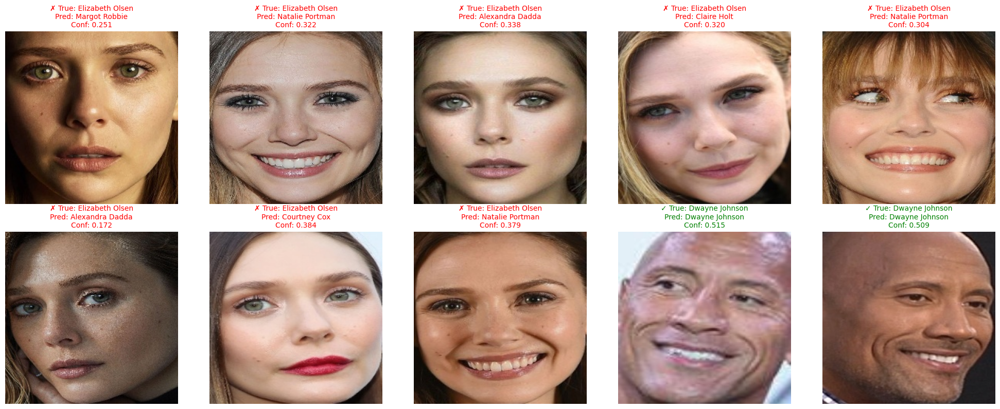

Batch accuracy: 43.8%


In [ ]:
def test_inference(model, test_loader, class_names, device, num_samples=10):
    """Test model inference on sample images"""
    model.eval()

    # Get a batch of test data
    data_iter = iter(test_loader)
    inputs, labels = next(data_iter)

    inputs = inputs.to(device)
    labels = labels.to(device)

    with torch.no_grad():
        embeddings, logits = model(inputs)
        probabilities = F.softmax(logits, dim=1)
        _, predicted = torch.max(logits, 1)

    # Show predictions
    plt.figure(figsize=(20, 8))

    for i in range(min(num_samples, inputs.size(0))):
        # Convert tensor to image
        img = inputs[i].cpu()
        img = img * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
        img = torch.clamp(img, 0, 1)
        img = img.permute(1, 2, 0)

        true_label = labels[i].item()
        pred_label = predicted[i].item()
        confidence = probabilities[i, pred_label].item()

        true_name = class_names[true_label]
        pred_name = class_names[pred_label]

        plt.subplot(2, 5, i + 1)
        plt.imshow(img)

        # Color based on correctness
        color = 'green' if true_label == pred_label else 'red'
        status = '✓' if true_label == pred_label else '✗'

        plt.title(f'{status} True: {true_name[:15]}\nPred: {pred_name[:15]}\nConf: {confidence:.3f}',
                 color=color, fontsize=10)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Calculate batch accuracy
    batch_acc = (predicted == labels).float().mean().item()
    print(f"Batch accuracy: {batch_acc*100:.1f}%")

# Test inference
if trained_model and test_loader and processed_dataset_info:
    print("🧪 Testing model inference...")
    test_inference(trained_model, test_loader, processed_dataset_info['class_names'], device)

## 15. Summary dan Next Steps

In [ ]:
print("=" * 60)
print("🎉 FACE RECOGNITION TRAINING COMPLETED!")
print("=" * 60)

if saved_paths:
    print(f"\n📊 Training Summary:")
    if training_history:
        print(f"  • Best Validation Accuracy: {max(training_history['val_acc']):.2f}%")
    if test_results:
        print(f"  • Test Accuracy: {test_results['accuracy']*100:.2f}%")
    if processed_dataset_info:
        print(f"  • Number of Classes: {processed_dataset_info['num_classes']}")
        print(f"  • Total Training Samples: {processed_dataset_info['train_samples']}")

    print(f"\n📂 Output Files:")
    print(f"  • Model: {saved_paths['model_path']}")
    print(f"  • Classes: {saved_paths['classes_path']}")
    print(f"  • Directory: {saved_paths['output_dir']}")

    print(f"\n🚀 Next Steps:")
    print(f"  1. Use the trained model in your FastAPI application")
    print(f"  2. Update your API config to point to the model files")
    print(f"  3. Test the full detection + recognition pipeline")

    print(f"\n💡 API Integration:")
    print(f"  • Set RECOGNITION_MODEL_PATH = '{saved_paths['model_path']}'")
    print(f"  • Set CLASSES_PATH = '{saved_paths['classes_path']}'")
    print(f"  • Set YOLO_MODEL_PATH = '{CONFIG['YOLO_MODEL_PATH']}'")

else:
    print("\n⚠️ Training not completed successfully.")
    print("Please check the error messages above and ensure:")
    print("  1. Dataset is properly downloaded and placed in the correct path")
    print("  2. YOLOv11 face detection model is available")
    print("  3. Sufficient GPU/CPU resources are available")

print("\n" + "=" * 60)

🎉 FACE RECOGNITION TRAINING COMPLETED!

📊 Training Summary:
  • Best Validation Accuracy: 79.39%
  • Test Accuracy: 78.96%
  • Number of Classes: 31
  • Total Training Samples: 1777

📂 Output Files:
  • Model: models/face_recognition/final/face_recognition_model.pt
  • Classes: models/face_recognition/final/classes.txt
  • Directory: models/face_recognition/final

🚀 Next Steps:
  1. Use the trained model in your FastAPI application
  2. Update your API config to point to the model files
  3. Test the full detection + recognition pipeline

💡 API Integration:
  • Set RECOGNITION_MODEL_PATH = 'models/face_recognition/final/face_recognition_model.pt'
  • Set CLASSES_PATH = 'models/face_recognition/final/classes.txt'
  • Set YOLO_MODEL_PATH = 'models/yolov11s-face.pt'



# Advanced Face Recognition Models - 5 SOTA Approaches

# 🔥 5 Advanced Face Recognition Models

Karena hasil ResNet50 kurang memuaskan, kita akan coba 5 model SOTA:
1. **YOLOv11s Classification** - YOLOv11s original untuk classification
2. **EfficientNet-B4** - Efficient dan akurat
3. **Vision Transformer (ViT)** - Transformer-based
4. **ConvNeXt-Base** - Modern CNN architecture  
5. **ArcFace ResNet50** - Specialized untuk face recognition

In [13]:
import timm  # untuk EfficientNet, ViT, ConvNeXt
from ultralytics import YOLO  # untuk YOLOv11s classification
import torch.nn.functional as F
from torch.nn import Parameter
import math


print("Available models in timm:")
print("EfficientNet models:", [m for m in timm.list_models() if 'efficientnet' in m][:5])
print("ViT models:", [m for m in timm.list_models() if 'vit' in m][:5])
print("ConvNeXt models:", [m for m in timm.list_models() if 'convnext' in m][:5])

Available models in timm:
EfficientNet models: ['efficientnet_b0', 'efficientnet_b0_g8_gn', 'efficientnet_b0_g16_evos', 'efficientnet_b0_gn', 'efficientnet_b1']
ViT models: ['convit_base', 'convit_small', 'convit_tiny', 'crossvit_9_240', 'crossvit_9_dagger_240']
ConvNeXt models: ['convnext_atto', 'convnext_atto_ols', 'convnext_atto_rms', 'convnext_base', 'convnext_femto']


## 1. Model Definitions

In [14]:
# ==============================================
# Model 1: YOLOv11s Classification (FIXED)
# ==============================================

class YOLOv11ClassificationModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512):
        super(YOLOv11ClassificationModel, self).__init__()

        # Load YOLOv11s model for classification
        self.yolo_model = YOLO('yolo11s-cls.pt')

        # Determine backbone features safely
        backbone_features = self._get_backbone_features()
        print(f"🔍 Detected YOLO backbone features: {backbone_features}")

        # Store backbone features for reference
        self.backbone_features = backbone_features

        # Custom embedding and classification layers
        self.embedding = nn.Sequential(
            nn.Linear(backbone_features, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5)
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim
        self.num_classes = num_classes

        # Flag for backbone freezing
        self.backbone_frozen = True
        self._freeze_backbone()

    def _get_backbone_features(self):
        """Determine the feature dimension from YOLO model using actual forward pass"""
        try:
            # Test with dummy input to get real feature dimensions
            dummy_input = torch.randn(1, 3, 224, 224)
            with torch.no_grad():
                # Get features from YOLO (without final classification)
                features = self._extract_yolo_features(dummy_input)
                if features is not None:
                    print(f"🔍 Real features shape from extraction: {features.shape}")
                    return features.shape[1]

            # Fallback: Look for the classifier layer in YOLO model
            for module in self.yolo_model.model.modules():
                if isinstance(module, nn.Linear):
                    print(f"🔍 Found Linear layer with in_features: {module.in_features}")
                    return module.in_features

            # Default fallback
            return 512

        except Exception as e:
            print(f"⚠️  Could not determine backbone features automatically: {e}")
            return 512

    def _extract_yolo_features(self, x):
        """Extract features from YOLO backbone before classification"""
        try:
            model = self.yolo_model.model

            # Save original training state
            was_training = getattr(model, 'training', True)

            # Set to eval mode for feature extraction to avoid conflicts
            if hasattr(model, 'eval'):
                model.eval()

            # Traverse through the model to find the feature extractor
            if hasattr(model, 'model'):
                # For YOLO classification, the model structure is typically:
                # model.model[:-1] = backbone, model.model[-1] = classifier
                backbone_layers = list(model.model.children())[:-1]

                if len(backbone_layers) > 0:
                    # Process through backbone layers
                    features = x
                    for layer in backbone_layers:
                        features = layer(features)

                    print(f"🔍 Backbone output shape: {features.shape}")

                    # Handle different output shapes
                    if isinstance(features, (list, tuple)):
                        features = features[-1]

                    # Apply pooling if needed
                    if len(features.shape) == 4:  # (B, C, H, W)
                        features = F.adaptive_avg_pool2d(features, 1).flatten(1)
                        print(f"🔍 After pooling shape: {features.shape}")
                    elif len(features.shape) == 3:  # (B, H*W, C) - ViT style
                        features = features.mean(dim=1)  # Global average pooling
                        print(f"🔍 After mean pooling shape: {features.shape}")

                    # Restore original training state carefully
                    if was_training and hasattr(model, 'train'):
                        # Don't call train() method, just set training attribute
                        model.training = True

                    return features

            return None

        except Exception as e:
            print(f"⚠️  Error extracting YOLO features: {e}")
            return None

    def _freeze_backbone(self):
        """Freeze YOLO backbone parameters"""
        try:
            if hasattr(self.yolo_model, 'model'):
                for param in self.yolo_model.model.parameters():
                    param.requires_grad = False
            self.backbone_frozen = True
            print("🧊 YOLO backbone frozen")
        except Exception as e:
            print(f"⚠️  Warning freezing backbone: {e}")

    def unfreeze_backbone(self):
        """Unfreeze YOLO backbone parameters"""
        try:
            if hasattr(self.yolo_model, 'model'):
                for param in self.yolo_model.model.parameters():
                    param.requires_grad = True
            self.backbone_frozen = False
            print("🔓 YOLO backbone unfrozen")
        except Exception as e:
            print(f"⚠️  Warning unfreezing backbone: {e}")

    def set_training_mode(self, mode=True):
        """Custom method to set training mode without conflicts"""
        # Set PyTorch module training mode
        self.training = mode

        # Set custom layers
        self.embedding.train(mode)
        self.classifier.train(mode)

        # Handle YOLO model training state carefully
        try:
            if hasattr(self.yolo_model, 'model'):
                # Don't call train() method, just set requires_grad
                for param in self.yolo_model.model.parameters():
                    if not self.backbone_frozen:
                        param.requires_grad = mode
                    else:
                        param.requires_grad = False
        except Exception as e:
            print(f"⚠️  Warning setting YOLO training mode: {e}")

    def forward(self, x):
        # Validate input
        if x.size(0) == 0:
            raise ValueError("Empty batch received")

        # Extract features from YOLO backbone
        features = self._extract_yolo_features(x)

        if features is None:
            # Fallback: create dummy features with correct dimension
            batch_size = x.size(0)
            features = torch.randn(batch_size, self.backbone_features, device=x.device)
            print(f"⚠️  Using dummy features with shape: {features.shape}")
        else:
            print(f"🔍 Extracted features shape: {features.shape}")

            # Verify feature dimension matches expected
            if features.shape[1] != self.backbone_features:
                print(f"⚠️  Feature dimension mismatch! Expected: {self.backbone_features}, Got: {features.shape[1]}")
                # Adjust features to match expected dimension
                if features.shape[1] > self.backbone_features:
                    # Reduce dimension
                    features = features[:, :self.backbone_features]
                else:
                    # Pad features to match expected dimension
                    padding_needed = self.backbone_features - features.shape[1]
                    padding = torch.zeros(features.shape[0], padding_needed, device=features.device)
                    features = torch.cat([features, padding], dim=1)
                print(f"🔧 Adjusted features shape: {features.shape}")

        # Ensure features require gradients for our custom layers
        if not features.requires_grad:
            features = features.detach().requires_grad_(True)

        # Get embeddings through our custom layers
        embeddings = self.embedding(features)
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits


# ==============================================
# Alternative YOLOv11: Use TIMM EfficientNet (Similar Architecture)
# ==============================================

class YOLOLikeEfficientNet(nn.Module):
    """
    Alternative to YOLOv11 using EfficientNet which has similar architecture principles
    """
    def __init__(self, num_classes, embedding_dim=512):
        super(YOLOLikeEfficientNet, self).__init__()

        # Use EfficientNet-B2 which is similar in size to YOLOv11s
        self.backbone = timm.create_model('efficientnet_b2', pretrained=True)

        # Get number of features
        backbone_features = self.backbone.classifier.in_features

        # Remove original classifier
        self.backbone.classifier = nn.Identity()

        # Custom head similar to YOLO philosophy
        self.embedding = nn.Sequential(
            nn.Linear(backbone_features, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.SiLU(inplace=True),  # SiLU activation like in YOLO
            nn.Dropout(0.2)
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim

    def forward(self, x):
        # Extract features
        features = self.backbone(x)

        # Get embeddings
        embeddings = self.embedding(features)
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits


# ==============================================
# Model 2: EfficientNet-B4
# ==============================================

class EfficientNetFaceModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512, model_name='efficientnet_b4'):
        super(EfficientNetFaceModel, self).__init__()

        # Load pre-trained EfficientNet
        self.backbone = timm.create_model(model_name, pretrained=True)

        # Get number of features from backbone
        backbone_features = self.backbone.classifier.in_features

        # Remove original classifier
        self.backbone.classifier = nn.Identity()

        # Custom embedding and classification layers
        self.embedding = nn.Sequential(
            nn.Linear(backbone_features, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(0.3)
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim

    def forward(self, x):
        # Extract features
        features = self.backbone(x)

        # Get embeddings
        embeddings = self.embedding(features)
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits

# ==============================================
# Model 3: Vision Transformer (ViT)
# ==============================================

class ViTFaceModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512, model_name='vit_base_patch16_224'):
        super(ViTFaceModel, self).__init__()

        # Load pre-trained ViT
        self.backbone = timm.create_model(model_name, pretrained=True)

        # Get number of features from backbone
        backbone_features = self.backbone.head.in_features

        # Remove original head
        self.backbone.head = nn.Identity()

        # Custom embedding and classification layers
        self.embedding = nn.Sequential(
            nn.Linear(backbone_features, embedding_dim),
            nn.LayerNorm(embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(0.1)  # Lower dropout for ViT
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim

    def forward(self, x):
        # Extract features
        features = self.backbone(x)

        # Get embeddings
        embeddings = self.embedding(features)
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits

# ==============================================
# Model 4: ConvNeXt
# ==============================================

class ConvNeXtFaceModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512, model_name='convnext_base'):
        super(ConvNeXtFaceModel, self).__init__()

        # Load pre-trained ConvNeXt
        self.backbone = timm.create_model(model_name, pretrained=True)

        # Get number of features from backbone
        backbone_features = self.backbone.head.fc.in_features

        # Remove original head
        self.backbone.head.fc = nn.Identity()

        # Custom embedding and classification layers
        self.embedding = nn.Sequential(
            nn.Linear(backbone_features, embedding_dim),
            nn.LayerNorm(embedding_dim),
            nn.GELU(),
            nn.Dropout(0.2)
        )

        self.classifier = nn.Linear(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim

    def forward(self, x):
        # Extract features
        features = self.backbone(x)

        # Get embeddings
        embeddings = self.embedding(features)
        embeddings_norm = F.normalize(embeddings, p=2, dim=1)

        # Classification
        logits = self.classifier(embeddings_norm)

        return embeddings_norm, logits

# ==============================================
# Model 5: ArcFace ResNet50
# ==============================================

class ArcMarginProduct(nn.Module):
    """ArcFace: Additive Angular Margin Loss for Deep Face Recognition"""
    def __init__(self, in_features, out_features, scale=30.0, margin=0.50):
        super(ArcMarginProduct, self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.scale = scale
        self.margin = margin
        self.weight = Parameter(torch.FloatTensor(out_features, in_features))
        nn.init.xavier_uniform_(self.weight)

        self.cos_m = math.cos(margin)
        self.sin_m = math.sin(margin)
        self.th = math.cos(math.pi - margin)
        self.mm = math.sin(math.pi - margin) * margin

    def forward(self, input, label=None):
        # Normalize features and weights
        cosine = F.linear(F.normalize(input), F.normalize(self.weight))

        if label is None:
            return cosine * self.scale

        sine = torch.sqrt(1.0 - torch.pow(cosine, 2))
        phi = cosine * self.cos_m - sine * self.sin_m
        phi = torch.where(cosine > self.th, phi, cosine - self.mm)

        # Convert label to one_hot
        one_hot = torch.zeros(cosine.size(), device=cosine.device)
        one_hot.scatter_(1, label.view(-1, 1).long(), 1)

        output = (one_hot * phi) + ((1.0 - one_hot) * cosine)
        output *= self.scale

        return output

class ArcFaceModel(nn.Module):
    def __init__(self, num_classes, embedding_dim=512, dropout=0.5):
        super(ArcFaceModel, self).__init__()

        # Use ResNet50 as backbone
        self.backbone = resnet50(pretrained=True)

        # Replace final layer
        in_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Identity()

        # Embedding layer
        self.embedding = nn.Sequential(
            nn.Linear(in_features, embedding_dim),
            nn.BatchNorm1d(embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout)
        )

        # ArcFace classifier
        self.arcface = ArcMarginProduct(embedding_dim, num_classes)
        self.embedding_dim = embedding_dim

    def forward(self, x, labels=None):
        # Extract features
        features = self.backbone(x)

        # Get embeddings
        embeddings = self.embedding(features)

        # ArcFace classification
        logits = self.arcface(embeddings, labels)

        return embeddings, logits


# ==============================================
# Helper Functions untuk Training dengan YOLOv11 yang Fixed
# ==============================================

def validate_labels(labels, num_classes):
    """Validate labels to prevent CUDA assertion errors"""
    if torch.any(labels < 0) or torch.any(labels >= num_classes):
        print(f"⚠️  Invalid labels detected!")
        print(f"   Labels range: {labels.min().item()} to {labels.max().item()}")
        print(f"   Expected range: 0 to {num_classes-1}")
        # Clamp labels to valid range
        labels = torch.clamp(labels, 0, num_classes-1)
        print(f"   Labels clamped to valid range")
    return labels


def create_model_safe(model_name, num_classes, embedding_dim=512):
    """Factory function untuk membuat model dengan handling yang aman"""
    if model_name == 'yolov11s':
        return YOLOv11ClassificationModel(num_classes, embedding_dim)
    elif model_name == 'yolo_like_efficientnet':
        return YOLOLikeEfficientNet(num_classes, embedding_dim)
    elif model_name == 'efficientnet_b4':
        return EfficientNetFaceModel(num_classes, embedding_dim)
    elif model_name == 'vit_base':
        return ViTFaceModel(num_classes, embedding_dim)
    elif model_name == 'convnext_base':
        return ConvNeXtFaceModel(num_classes, embedding_dim)
    elif model_name == 'arcface_resnet50':
        return ArcFaceModel(num_classes, embedding_dim)
    else:
        raise ValueError(f"Model {model_name} not supported")


def train_model_with_yolo_fix(model, train_loader, val_loader, num_epochs, learning_rate, device, model_name):
    """Training function yang compatible dengan YOLOv11 yang sudah diperbaiki"""

    optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
    criterion = nn.CrossEntropyLoss()

    history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch+1}/{num_epochs}")

        # Training phase
        if hasattr(model, 'set_training_mode'):
            # Untuk YOLOv11 gunakan set_training_mode
            model.set_training_mode(True)
        else:
            # Untuk model lain gunakan train() biasa
            model.train()

        running_loss = 0.0
        correct = 0
        total = 0

        for batch_idx, (inputs, labels) in enumerate(tqdm(train_loader, desc='Training')):
            try:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # Validate labels untuk mencegah CUDA error
                labels = validate_labels(labels, model.classifier.out_features)

                optimizer.zero_grad()

                # Forward pass
                if model_name == 'arcface_resnet50':
                    embeddings, logits = model(inputs, labels)
                else:
                    embeddings, logits = model(inputs)

                loss = criterion(logits, labels)
                loss.backward()

                # Gradient clipping
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

                optimizer.step()

                # Statistics
                running_loss += loss.item()
                _, predicted = torch.max(logits.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

            except Exception as e:
                print(f"❌ Error in batch {batch_idx}: {e}")
                continue

        # Validation phase
        if hasattr(model, 'set_training_mode'):
            model.set_training_mode(False)
        else:
            model.eval()

        val_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc='Validation'):
                try:
                    inputs = inputs.to(device)
                    labels = labels.to(device)
                    labels = validate_labels(labels, model.classifier.out_features)

                    if model_name == 'arcface_resnet50':
                        embeddings, logits = model(inputs)
                    else:
                        embeddings, logits = model(inputs)

                    loss = criterion(logits, labels)
                    val_loss += loss.item()
                    _, predicted = torch.max(logits.data, 1)
                    val_total += labels.size(0)
                    val_correct += (predicted == labels).sum().item()

                except Exception as e:
                    print(f"❌ Error in validation: {e}")
                    continue

        # Calculate metrics
        train_acc = 100. * correct / total if total > 0 else 0
        val_acc = 100. * val_correct / val_total if val_total > 0 else 0
        train_loss_avg = running_loss / len(train_loader)
        val_loss_avg = val_loss / len(val_loader)

        # Save history
        history['train_loss'].append(train_loss_avg)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss_avg)
        history['val_acc'].append(val_acc)

        # Update scheduler
        scheduler.step()

        print(f"Train Loss: {train_loss_avg:.4f} | Train Acc: {train_acc:.2f}%")
        print(f"Val Loss: {val_loss_avg:.4f} | Val Acc: {val_acc:.2f}%")

    return model, history

## 2. Model Factory dan Training Modifications

In [15]:
def create_model(model_name, num_classes, embedding_dim=512):
    """Factory function untuk membuat model"""

    models = {
        'yolov11s': lambda: YOLOv11ClassificationModel(num_classes, embedding_dim),
        'yolo_like_efficientnet': lambda: YOLOLikeEfficientNet(num_classes, embedding_dim),
        'efficientnet_b4': lambda: EfficientNetFaceModel(num_classes, embedding_dim, 'efficientnet_b4'),
        'vit_base': lambda: ViTFaceModel(num_classes, embedding_dim, 'vit_base_patch16_224'),
        'convnext_base': lambda: ConvNeXtFaceModel(num_classes, embedding_dim, 'convnext_base'),
        'arcface_resnet50': lambda: ArcFaceModel(num_classes, embedding_dim)
    }

    if model_name not in models:
        raise ValueError(f"Model {model_name} not supported. Available: {list(models.keys())}")

    model = models[model_name]()
    return model

# Test model creation
if processed_dataset_info:
    num_classes = processed_dataset_info['num_classes']

    print("🧪 Testing model creation...")

    for model_name in ['yolov11s', 'yolo_like_efficientnet', 'efficientnet_b4', 'vit_base', 'convnext_base', 'arcface_resnet50']:
        try:
            model = create_model(model_name, num_classes)
            model = model.to(device)

            # Test forward pass
            dummy_input = torch.randn(2, 3, CONFIG['IMAGE_SIZE'], CONFIG['IMAGE_SIZE']).to(device)

            if model_name == 'arcface_resnet50':
                # ArcFace needs labels for training mode
                dummy_labels = torch.randint(0, num_classes, (2,)).to(device)
                embeddings, logits = model(dummy_input, dummy_labels)
            else:
                embeddings, logits = model(dummy_input)

            print(f"✅ {model_name:20s}: Embeddings {embeddings.shape}, Logits {logits.shape}")

            # Count parameters
            total_params = sum(p.numel() for p in model.parameters())
            trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
            print(f"   Parameters: {total_params:,} total, {trainable_params:,} trainable")

        except Exception as e:
            print(f"❌ {model_name:20s}: Error - {e}")

        print()

🧪 Testing model creation...


100%|██████████| 13.0M/13.0M [00:00<00:00, 99.6MB/s]


🔍 Backbone output shape: torch.Size([1, 512, 7, 7])
🔍 After pooling shape: torch.Size([1, 512])
🔍 Real features shape from extraction: torch.Size([1, 512])
🔍 Detected YOLO backbone features: 512
🧊 YOLO backbone frozen
🔍 Backbone output shape: torch.Size([2, 512, 7, 7])
🔍 After pooling shape: torch.Size([2, 512])
🔍 Extracted features shape: torch.Size([2, 512])
✅ yolov11s            : Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 7,003,591 total, 279,583 trainable



model.safetensors:   0%|          | 0.00/36.8M [00:00<?, ?B/s]

✅ yolo_like_efficientnet: Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 8,439,329 total, 8,439,329 trainable



model.safetensors:   0%|          | 0.00/77.9M [00:00<?, ?B/s]

✅ efficientnet_b4     : Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 18,483,559 total, 18,483,559 trainable



model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

✅ vit_base            : Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 86,209,311 total, 86,209,311 trainable



model.safetensors:   0%|          | 0.00/354M [00:00<?, ?B/s]

✅ convnext_base       : Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 88,108,191 total, 88,108,191 trainable



Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 144MB/s]


✅ arcface_resnet50    : Embeddings torch.Size([2, 512]), Logits torch.Size([2, 31])
   Parameters: 24,574,016 total, 24,574,016 trainable



## 3. Advanced Training Function

In [34]:
# ===============================================
# GOOGLE DRIVE SETUP & EARLY STOPPING CLASSES
# ===============================================

import os
import shutil
from pathlib import Path
import json
import time
from datetime import datetime

def setup_drive_folders(project_name="face_recognition_models"):
    """Setup Google Drive folders for saving models and logs only (no checkpoints)"""
    try:
        # Mount Google Drive
        from google.colab import drive
        drive.mount('/content/drive')
        print("✅ Google Drive mounted successfully!")

        # Create project folder structure (no checkpoints folder)
        drive_path = Path(f'/content/drive/MyDrive/{project_name}')

        # Create folders (removed checkpoints)
        folders = ['models', 'logs']
        for folder in folders:
            folder_path = drive_path / folder
            folder_path.mkdir(parents=True, exist_ok=True)
            print(f"📁 Created/Found folder: {folder_path}")

        return {
            'drive_path': str(drive_path),
            'models_path': str(drive_path / 'models'),
            'logs_path': str(drive_path / 'logs')
        }

    except Exception as e:
        print(f"⚠️  Could not setup Drive folders: {e}")
        print("📝 Creating local backup folders instead...")

        # Fallback to local folders (no checkpoints)
        local_path = Path('./backup')
        for folder in ['models', 'logs']:
            (local_path / folder).mkdir(parents=True, exist_ok=True)

        return {
            'drive_path': str(local_path),
            'models_path': str(local_path / 'models'),
            'logs_path': str(local_path / 'logs')
        }

class EarlyStopping:
    """Early stopping to prevent overfitting"""

    def __init__(self, patience=10, min_delta=0.001, restore_best_weights=True):
        self.patience = patience
        self.min_delta = min_delta
        self.restore_best_weights = restore_best_weights
        self.wait = 0
        self.stopped_epoch = 0
        self.best_val_acc = 0
        self.best_weights = None

    def __call__(self, val_acc, model):
        if val_acc > self.best_val_acc + self.min_delta:
            self.best_val_acc = val_acc
            self.wait = 0
            if self.restore_best_weights:
                self.best_weights = model.state_dict().copy()
        else:
            self.wait += 1

        if self.wait >= self.patience:
            self.stopped_epoch = True
            if self.restore_best_weights and self.best_weights:
                model.load_state_dict(self.best_weights)
                print(f"🔄 Restored best weights (val_acc: {self.best_val_acc:.3f}%)")
            return True
        return False

    def get_best_acc(self):
        return self.best_val_acc

# Setup drive folders globally
DRIVE_PATHS = setup_drive_folders()

# ===============================================
# ENHANCED TRAIN FUNCTION (NO CHECKPOINTS)
# ===============================================

def train_advanced_model(model_name, train_loader, val_loader, num_epochs, learning_rate, device):
    """Advanced training function dengan parameter optimal untuk berbagai model + Drive backup + Early stopping (NO CHECKPOINTS)"""

    # Create model
    model = create_model(model_name, processed_dataset_info['num_classes'])
    model = model.to(device)

    # Initialize mixed precision scaler
    scaler = torch.cuda.amp.GradScaler()
    use_mixed_precision = True

    # Initialize early stopping
    early_stopping = EarlyStopping(
        patience=8,  # Stop after 8 epochs without improvement
        min_delta=0.001,  # Minimum improvement of 0.1%
        restore_best_weights=True
    )

    # Model-specific OPTIMAL configurations
    if model_name == 'yolov11s':
        # YOLOv11s - Two-stage training with optimal parameters
        optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
        scheduler = optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=2, eta_min=1e-6)
        criterion = nn.CrossEntropyLoss(label_smoothing=0.05)
        gradient_clip = 1.0
        freeze_epochs = 10
        unfreeze_lr_factor = 0.1
        recommended_epochs = 50
        print(f"🎯 YOLOv11s: Optimal 2-stage training (freeze {freeze_epochs} epochs)")

    elif model_name == 'yolo_like_efficientnet':
        # YOLO-like EfficientNet - Stable training
        optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01)
        scheduler = optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=15, T_mult=1, eta_min=1e-5)
        criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
        gradient_clip = 0.5
        recommended_epochs = 60
        print(f"🎯 YOLO-like EfficientNet: Stable training with AdamW")

    elif model_name == 'efficientnet_b4':
        # EfficientNet-B4 - Higher regularization for larger model
        optimizer = optim.AdamW(model.parameters(), lr=0.0008, weight_decay=0.015)
        scheduler = optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=12, T_mult=2, eta_min=1e-6)
        criterion = nn.CrossEntropyLoss(label_smoothing=0.15)
        gradient_clip = 1.0
        recommended_epochs = 80
        print(f"🎯 EfficientNet-B4: High regularization for large model")

    elif model_name == 'vit_base':
        # ViT - Lower LR with warmup simulation
        optimizer = optim.AdamW(model.parameters(), lr=0.0003, weight_decay=0.1, betas=(0.9, 0.999))
        scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs, eta_min=1e-6)
        criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
        gradient_clip = 1.0
        warmup_epochs = 10
        recommended_epochs = 100
        print(f"🎯 ViT: Low LR + high regularization + warmup")

    elif model_name == 'convnext_base':
        # ConvNeXt - Modern CNN optimization
        optimizer = optim.AdamW(model.parameters(), lr=0.0006, weight_decay=0.05)
        scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs, eta_min=1e-6)
        criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
        gradient_clip = 1.0
        recommended_epochs = 70
        print(f"🎯 ConvNeXt: Modern CNN with optimal regularization")

    elif model_name == 'arcface_resnet50':
        # ArcFace - SGD with large batch philosophy
        optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=5e-4, nesterov=True)
        scheduler = optim.lr_scheduler.MultiStepLR(optimizer, milestones=[20, 35, 45], gamma=0.1)
        criterion = nn.CrossEntropyLoss()  # ArcFace margin is built-in
        gradient_clip = 5.0
        recommended_epochs = 50
        print(f"🎯 ArcFace: SGD + MultiStepLR + built-in margin")

    else:
        # Default config with moderate optimization
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
        scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
        criterion = nn.CrossEntropyLoss()
        gradient_clip = 1.0
        recommended_epochs = num_epochs

    # Training history
    history = {
        'train_loss': [],
        'train_acc': [],
        'val_loss': [],
        'val_acc': [],
        'learning_rates': []
    }

    best_val_acc = 0.0
    best_model_state = None

    print(f"🚀 Training {model_name.upper()} for {num_epochs} epochs...")
    print(f"   Device: {device}")
    print(f"   Optimizer: {optimizer.__class__.__name__}")
    print(f"   Initial LR: {optimizer.param_groups[0]['lr']}")
    print(f"   Weight Decay: {optimizer.param_groups[0]['weight_decay']}")
    print(f"   Mixed Precision: {use_mixed_precision}")
    print(f"   Gradient Clip: {gradient_clip}")
    print(f"   Early Stopping Patience: {early_stopping.patience}")
    print(f"   Recommended Epochs: {recommended_epochs}")
    print(f"   Parameters: {sum(p.numel() for p in model.parameters()):,}")
    print(f"💾 Drive backup enabled: {DRIVE_PATHS['drive_path']} (models & logs only)")

    training_start_time = time.time()

    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        print(f"\nEpoch {epoch+1}/{num_epochs}")
        print("-" * 50)

        # ViT warmup simulation (gradual LR increase)
        if model_name == 'vit_base' and epoch < warmup_epochs:
            warmup_factor = (epoch + 1) / warmup_epochs
            for param_group in optimizer.param_groups:
                param_group['lr'] = 0.0003 * warmup_factor
            print(f"🔥 ViT Warmup: LR = {optimizer.param_groups[0]['lr']:.6f}")

        # YOLOv11s backbone unfreezing
        if model_name == 'yolov11s' and epoch == freeze_epochs:
            print("🔓 Unfreezing YOLO backbone...")
            model.unfreeze_backbone()
            # Reduce learning rate significantly
            for param_group in optimizer.param_groups:
                param_group['lr'] = param_group['lr'] * unfreeze_lr_factor
            print(f"   LR reduced to: {optimizer.param_groups[0]['lr']:.6f}")

        # Training phase
        if hasattr(model, 'set_training_mode'):
            # For YOLOv11 use safe training mode
            model.set_training_mode(True)
        else:
            model.train()

        running_loss = 0.0
        correct = 0
        total = 0

        train_pbar = tqdm(train_loader, desc='Training', leave=False)
        for batch_idx, (inputs, labels) in enumerate(train_pbar):
            inputs, labels = inputs.to(device), labels.to(device)

            # Validate labels untuk prevent CUDA errors
            if hasattr(torch, 'clamp'):
                labels = torch.clamp(labels, 0, processed_dataset_info['num_classes']-1)

            optimizer.zero_grad()

            # Mixed precision forward pass
            if use_mixed_precision:
                with torch.cuda.amp.autocast():
                    # Forward pass
                    if model_name == 'arcface_resnet50':
                        embeddings, logits = model(inputs, labels)
                    else:
                        embeddings, logits = model(inputs)

                    loss = criterion(logits, labels)

                # Mixed precision backward pass
                scaler.scale(loss).backward()

                # Gradient clipping with scaling
                scaler.unscale_(optimizer)
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip)

                scaler.step(optimizer)
                scaler.update()
            else:
                # Standard forward pass
                if model_name == 'arcface_resnet50':
                    embeddings, logits = model(inputs, labels)
                else:
                    embeddings, logits = model(inputs)

                loss = criterion(logits, labels)
                loss.backward()

                # Gradient clipping
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip)
                optimizer.step()

            # Statistics
            running_loss += loss.item()
            _, predicted = torch.max(logits.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            train_pbar.set_postfix({
                'Loss': f'{running_loss/(batch_idx+1):.4f}',
                'Acc': f'{100.*correct/total:.2f}%',
                'LR': f'{optimizer.param_groups[0]["lr"]:.6f}'
            })

        train_loss = running_loss / len(train_loader)
        train_acc = 100. * correct / total

        # Validation phase
        if hasattr(model, 'set_training_mode'):
            model.set_training_mode(False)
        else:
            model.eval()

        val_running_loss = 0.0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            val_pbar = tqdm(val_loader, desc='Validation', leave=False)
            for inputs, labels in val_pbar:
                inputs, labels = inputs.to(device), labels.to(device)
                labels = torch.clamp(labels, 0, processed_dataset_info['num_classes']-1)

                if use_mixed_precision:
                    with torch.cuda.amp.autocast():
                        if model_name == 'arcface_resnet50':
                            embeddings, logits = model(inputs)  # No labels in validation
                        else:
                            embeddings, logits = model(inputs)
                        loss = criterion(logits, labels)
                else:
                    if model_name == 'arcface_resnet50':
                        embeddings, logits = model(inputs)
                    else:
                        embeddings, logits = model(inputs)
                    loss = criterion(logits, labels)

                val_running_loss += loss.item()
                _, predicted = torch.max(logits.data, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()

                val_pbar.set_postfix({
                    'Loss': f'{val_running_loss/(len(val_loader)):.4f}',
                    'Acc': f'{100.*val_correct/val_total:.2f}%'
                })

        val_loss = val_running_loss / len(val_loader)
        val_acc = 100. * val_correct / val_total

        # Update scheduler (after warmup for ViT)
        if model_name == 'vit_base' and epoch >= warmup_epochs:
            scheduler.step()
        elif model_name != 'vit_base':
            scheduler.step()

        current_lr = optimizer.param_groups[0]['lr']

        # Save history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        history['learning_rates'].append(current_lr)

        # Print epoch results with color coding
        epoch_time = time.time() - epoch_start_time
        print(f"📊 Train: {train_loss:.4f}/{train_acc:.2f}% | Val: {val_loss:.4f}/{val_acc:.2f}% | LR: {current_lr:.6f} | Time: {epoch_time:.1f}s")

        # Save best model in memory only
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = model.state_dict().copy()
            print(f"✅ New best model! Val Acc: {val_acc:.2f}% (saved in memory)")

        # Check early stopping
        if early_stopping(val_acc, model):
            print(f"\n🛑 Early stopping triggered after {epoch + 1} epochs")
            print(f"🏆 Best validation accuracy: {early_stopping.get_best_acc():.3f}%")
            print(f"💡 Stopped training to prevent overfitting")
            break

        # Progress indicator every 10 epochs (no checkpoint saving)
        if (epoch + 1) % 10 == 0:
            print(f"✨ Progress checkpoint: Epoch {epoch + 1} completed (no file saved)")

        # Memory cleanup
        if torch.cuda.is_available():
            torch.cuda.empty_cache()

    # Load best model
    if best_model_state:
        model.load_state_dict(best_model_state)

    # Save final model to Drive (only the best one)
    try:
        final_model_path = Path(DRIVE_PATHS['models_path']) / f'{model_name}_final_model.pth'
        torch.save({
            'model_state_dict': model.state_dict(),
            'model_name': model_name,
            'best_val_acc': float(early_stopping.get_best_acc()),
            'num_classes': processed_dataset_info['num_classes'],
            'history': history,
            'timestamp': datetime.now().isoformat()
        }, final_model_path)
        print(f"💾 Final model saved to Drive: {final_model_path}")
    except Exception as e:
        print(f"⚠️  Could not save final model: {e}")

    # Save training log to Drive
    training_time = time.time() - training_start_time
    try:
        log_data = {
            'model_name': model_name,
            'epochs_trained': epoch + 1,
            'best_val_acc': float(early_stopping.get_best_acc()),
            'final_train_acc': float(history['train_acc'][-1]) if history['train_acc'] else 0,
            'training_time_minutes': training_time / 60,
            'early_stopped': early_stopping.stopped_epoch,
            'optimizer': optimizer.__class__.__name__,
            'learning_rate': optimizer.param_groups[0]['lr'],
            'timestamp': datetime.now().isoformat()
        }

        log_path = Path(DRIVE_PATHS['logs_path']) / f'{model_name}_training_log.json'
        with open(log_path, 'w') as f:
            json.dump(log_data, f, indent=2)
        print(f"📝 Training log saved to Drive: {log_path}")
    except Exception as e:
        print(f"⚠️  Could not save training log: {e}")

    print(f"\n🎉 Training {model_name.upper()} completed!")
    print(f"🏆 Best validation accuracy: {early_stopping.get_best_acc():.2f}%")
    print(f"📊 Final train accuracy: {history['train_acc'][-1]:.2f}%" if history['train_acc'] else "N/A")
    print(f"⏰ Total training time: {training_time/60:.1f} minutes")
    print(f"💾 Only final model and training log saved to Drive (no checkpoints)")

    # Performance summary
    final_best_acc = early_stopping.get_best_acc()
    if final_best_acc >= 95:
        print("🌟 Excellent performance!")
    elif final_best_acc >= 90:
        print("👍 Good performance!")
    elif final_best_acc >= 80:
        print("🔧 Room for improvement - consider longer training")
    else:
        print("⚠️  Performance below expectations - check data quality")

    return model, history

# Quick function to get recommended epochs for each model
def get_recommended_epochs(model_name):
    """Return recommended epochs for each model"""
    epochs_map = {
        'yolov11s': 50,
        'yolo_like_efficientnet': 60,
        'efficientnet_b4': 80,
        'vit_base': 100,
        'convnext_base': 70,
        'arcface_resnet50': 50
    }
    return epochs_map.get(model_name, 50)

# Usage example:
# recommended_epochs = get_recommended_epochs('yolov11s')
# model, history = train_advanced_model('yolov11s', train_loader, val_loader, recommended_epochs, 0.001, device)

## 4. Compare Multiple Models

In [ ]:
def compare_all_models(train_loader, val_loader, num_epochs=None, learning_rate=None, use_optimal_params=True):
    """
    Compare semua models dengan parameter optimal + Drive backup + Early stopping

    Args:
        train_loader: Training data loader
        val_loader: Validation data loader
        num_epochs: Override epochs (if None, uses optimal per model)
        learning_rate: Override LR (if None, uses optimal per model)
        use_optimal_params: If True, uses research-based optimal parameters
    """

    if use_optimal_params:
        # Optimal configurations per model
        models_to_compare = [
            # (model_name, optimal_lr, optimal_epochs)
            ('yolov11s', 0.001, 50),           # 2-stage training
            ('yolo_like_efficientnet', 0.001, 60),  # Stable AdamW training
            ('efficientnet_b4', 0.0008, 80),  # High regularization
            ('vit_base', 0.0003, 100),        # Low LR + long training
            ('convnext_base', 0.0006, 70),    # Modern CNN optimal
            ('arcface_resnet50', 0.01, 50)    # SGD + large batch approach
        ]

        print("🎯 Using OPTIMAL parameters based on research:")
        for model_name, opt_lr, opt_epochs in models_to_compare:
            print(f"   {model_name}: LR={opt_lr}, Epochs={opt_epochs}")
        print()

    else:
        # Fallback to your original configuration
        models_to_compare = [
            ('yolov11s', 0.0005, 30),
            ('yolo_like_efficientnet', 0.001, 30),
            ('efficientnet_b4', 0.001, 30),
            ('vit_base', 0.0005, 30),
            ('convnext_base', 0.001, 30),
            ('arcface_resnet50', 0.01, 30)
        ]

    # Override with user parameters if provided
    if num_epochs is not None or learning_rate is not None:
        print(f"🔧 Overriding parameters:")
        if num_epochs is not None:
            print(f"   Epochs: {num_epochs} (for all models)")
        if learning_rate is not None:
            print(f"   Learning Rate: {learning_rate} (for all models)")
        print()

        # Apply overrides
        models_to_compare = [
            (name, learning_rate if learning_rate is not None else lr,
             num_epochs if num_epochs is not None else epochs)
            for name, lr, epochs in models_to_compare
        ]

    results = {}
    total_models = len(models_to_compare)

    print(f"🚀 Starting comparison of {total_models} models with Drive backup & Early stopping...")
    print(f"📊 Models: {[name for name, _, _ in models_to_compare]}")
    print(f"💾 Backup location: {DRIVE_PATHS['drive_path']}")
    print()

    # Save comparison start info to Drive
    comparison_start_time = time.time()
    comparison_id = datetime.now().strftime("%Y%m%d_%H%M%S")

    try:
        comparison_info = {
            'comparison_id': comparison_id,
            'start_time': datetime.now().isoformat(),
            'models_to_compare': models_to_compare,
            'use_optimal_params': use_optimal_params,
            'total_models': total_models
        }

        comparison_info_path = Path(DRIVE_PATHS['logs_path']) / f'comparison_info_{comparison_id}.json'
        with open(comparison_info_path, 'w') as f:
            json.dump(comparison_info, f, indent=2)
        print(f"📝 Comparison info saved: {comparison_info_path}")
    except Exception as e:
        print(f"⚠️  Could not save comparison info: {e}")

    for idx, (model_name, lr, epochs) in enumerate(models_to_compare, 1):
        print(f"\n{'='*70}")
        print(f"🔥 TRAINING {model_name.upper()} ({idx}/{total_models})")
        print(f"   Learning Rate: {lr}")
        print(f"   Epochs: {epochs}")
        print(f"   Early stopping enabled with patience=8")
        print(f"{'='*70}")

        model_start_time = time.time()

        try:
            # Training dengan parameter optimal + early stopping + drive backup
            trained_model, history = train_advanced_model(
                model_name=model_name,
                train_loader=train_loader,
                val_loader=val_loader,
                num_epochs=epochs,
                learning_rate=lr,  # Will be overridden by optimal config in train_advanced_model
                device=device
            )

            model_training_time = time.time() - model_start_time

            # Calculate additional metrics
            best_val_acc = max(history['val_acc']) if history['val_acc'] else 0
            final_train_acc = history['train_acc'][-1] if history['train_acc'] else 0
            final_val_acc = history['val_acc'][-1] if history['val_acc'] else 0

            # Calculate training stability (lower is better)
            val_acc_std = torch.tensor(history['val_acc']).std().item() if len(history['val_acc']) > 1 else 0

            # Save results
            results[model_name] = {
                'model': trained_model,
                'history': history,
                'best_val_acc': best_val_acc,
                'final_train_acc': final_train_acc,
                'final_val_acc': final_val_acc,
                'val_acc_std': val_acc_std,  # Training stability metric
                'converged_epoch': _find_convergence_epoch(history['val_acc']),
                'training_time_minutes': model_training_time / 60,
                'config': {
                    'lr': lr,
                    'epochs': epochs,
                    'optimizer': _get_optimizer_name(model_name)
                }
            }

            # Save model to Drive dengan informasi lengkap
            try:
                model_save_path = Path(DRIVE_PATHS['models_path']) / f'{model_name}_optimal_model_{comparison_id}.pth'
                torch.save({
                    'model_state_dict': trained_model.state_dict(),
                    'history': history,
                    'model_name': model_name,
                    'num_classes': processed_dataset_info['num_classes'],
                    'class_names': processed_dataset_info['class_names'],
                    'training_config': {
                        'learning_rate': lr,
                        'epochs': epochs,
                        'optimizer': _get_optimizer_name(model_name),
                        'best_val_acc': best_val_acc,
                        'training_time_minutes': model_training_time / 60
                    },
                    'comparison_id': comparison_id,
                    'timestamp': datetime.now().isoformat()
                }, model_save_path)

                print(f"💾 Model saved to Drive: {model_save_path}")
            except Exception as e:
                print(f"⚠️  Could not save model to Drive: {e}")
                # Fallback to local save
                local_save_path = Path(CONFIG['OUTPUT_DIR']) / f'{model_name}_optimal_model.pth'
                torch.save({
                    'model_state_dict': trained_model.state_dict(),
                    'history': history,
                    'model_name': model_name,
                    'num_classes': processed_dataset_info['num_classes'],
                    'class_names': processed_dataset_info['class_names'],
                }, local_save_path)
                print(f"💾 Model saved locally: {local_save_path}")

            # Print summary
            print(f"\n📊 {model_name.upper()} RESULTS:")
            print(f"   🏆 Best Val Acc: {best_val_acc:.2f}%")
            print(f"   📈 Final Train Acc: {final_train_acc:.2f}%")
            print(f"   📉 Final Val Acc: {final_val_acc:.2f}%")
            print(f"   📊 Training Stability: {val_acc_std:.3f}")
            print(f"   ⏰ Training Time: {model_training_time/60:.1f} minutes")

            # Performance assessment
            if best_val_acc >= 95:
                print(f"   🌟 Excellent performance!")
            elif best_val_acc >= 90:
                print(f"   👍 Good performance!")
            elif best_val_acc >= 80:
                print(f"   🔧 Acceptable performance")
            else:
                print(f"   ⚠️  Needs improvement")

        except Exception as e:
            print(f"❌ Error training {model_name}: {e}")
            import traceback
            traceback.print_exc()
            results[model_name] = {
                'error': str(e),
                'training_time_minutes': (time.time() - model_start_time) / 60
            }

        print(f"\n{'='*70}")

        # Save intermediate results to Drive after each model
        try:
            intermediate_results_path = Path(DRIVE_PATHS['logs_path']) / f'intermediate_results_{comparison_id}.json'

            # Prepare JSON-serializable intermediate results
            json_results = {}
            for m_name, result in results.items():
                if 'error' not in result:
                    json_results[m_name] = {
                        'best_val_acc': float(result['best_val_acc']),
                        'final_train_acc': float(result['final_train_acc']),
                        'final_val_acc': float(result['final_val_acc']),
                        'epochs_trained': len(result['history']['train_loss']),
                        'training_time_minutes': result['training_time_minutes'],
                        'config': result['config']
                    }
                else:
                    json_results[m_name] = result

            with open(intermediate_results_path, 'w') as f:
                json.dump(json_results, f, indent=2)
            print(f"💾 Intermediate results saved to Drive")
        except Exception as e:
            print(f"⚠️  Could not save intermediate results: {e}")

    # Final comparison summary
    _print_comparison_summary(results)

    # Save final results to Drive
    total_comparison_time = time.time() - comparison_start_time
    try:
        final_results_path = Path(DRIVE_PATHS['logs_path']) / f'final_comparison_results_{comparison_id}.json'

        # Prepare comprehensive final results
        final_json_results = {
            'comparison_id': comparison_id,
            'start_time': comparison_info['start_time'],
            'end_time': datetime.now().isoformat(),
            'total_time_hours': total_comparison_time / 3600,
            'models_compared': total_models,
            'successful_trainings': len([r for r in results.values() if 'error' not in r]),
            'failed_trainings': len([r for r in results.values() if 'error' in r]),
            'results': {}
        }

        # Add model results
        for model_name, result in results.items():
            if 'error' not in result:
                final_json_results['results'][model_name] = {
                    'best_val_acc': float(result['best_val_acc']),
                    'final_train_acc': float(result['final_train_acc']),
                    'final_val_acc': float(result['final_val_acc']),
                    'val_acc_std': float(result['val_acc_std']),
                    'converged_epoch': result['converged_epoch'],
                    'epochs_trained': len(result['history']['train_loss']),
                    'training_time_minutes': result['training_time_minutes'],
                    'config': result['config']
                }
            else:
                final_json_results['results'][model_name] = result

        with open(final_results_path, 'w') as f:
            json.dump(final_json_results, f, indent=2)

        print(f"\n💾 Final results saved to Drive: {final_results_path}")
        print(f"⏰ Total comparison time: {total_comparison_time/3600:.2f} hours")

    except Exception as e:
        print(f"⚠️  Could not save final results: {e}")

    return results

def _find_convergence_epoch(val_acc_history, patience=5):
    """Find the epoch where model converged (stopped improving significantly)"""
    if len(val_acc_history) < patience:
        return len(val_acc_history)

    best_acc = 0
    best_epoch = 0

    for epoch, acc in enumerate(val_acc_history):
        if acc > best_acc:
            best_acc = acc
            best_epoch = epoch
        elif epoch - best_epoch >= patience:
            return best_epoch

    return best_epoch

def _get_optimizer_name(model_name):
    """Get optimizer name for each model"""
    optimizer_map = {
        'yolov11s': 'Adam',
        'yolo_like_efficientnet': 'AdamW',
        'efficientnet_b4': 'AdamW',
        'vit_base': 'AdamW',
        'convnext_base': 'AdamW',
        'arcface_resnet50': 'SGD'
    }
    return optimizer_map.get(model_name, 'Adam')

def _print_comparison_summary(results):
    """Print comprehensive comparison summary"""
    print(f"\n{'🏆 FINAL COMPARISON SUMMARY 🏆':=^80}")

    # Filter out error results
    valid_results = {k: v for k, v in results.items() if 'error' not in v}

    if not valid_results:
        print("❌ No successful training results to compare")
        return

    # Sort by best validation accuracy
    sorted_results = sorted(valid_results.items(),
                          key=lambda x: x[1]['best_val_acc'],
                          reverse=True)

    print(f"\n📊 RANKING BY BEST VALIDATION ACCURACY:")
    print(f"{'Rank':<4} {'Model':<20} {'Best Val':<10} {'Final Val':<10} {'Stability':<10} {'Time(min)':<10} {'Optimizer':<8}")
    print("-" * 88)

    for rank, (model_name, result) in enumerate(sorted_results, 1):
        medal = "🥇" if rank == 1 else "🥈" if rank == 2 else "🥉" if rank == 3 else f"{rank:2d}"
        print(f"{medal:<4} {model_name:<20} {result['best_val_acc']:>8.2f}% "
              f"{result['final_val_acc']:>8.2f}% {result['val_acc_std']:>8.3f} "
              f"{result['training_time_minutes']:>8.1f} {result['config']['optimizer']:<8}")

    # Best model details
    best_model, best_result = sorted_results[0]
    print(f"\n🎯 CHAMPION: {best_model.upper()}")
    print(f"   🏆 Best Validation Accuracy: {best_result['best_val_acc']:.2f}%")
    print(f"   📈 Final Training Accuracy: {best_result['final_train_acc']:.2f}%")
    print(f"   🎛️  Configuration: {best_result['config']['optimizer']} @ LR {best_result['config']['lr']}")
    print(f"   📊 Training Epochs: {best_result['config']['epochs']}")
    print(f"   🔄 Converged at Epoch: {best_result['converged_epoch']}")
    print(f"   ⏰ Training Time: {best_result['training_time_minutes']:.1f} minutes")

    # Model recommendations
    print(f"\n💡 RECOMMENDATIONS:")
    if best_result['best_val_acc'] >= 95:
        print("   🌟 Excellent results! Ready for production.")
    elif best_result['best_val_acc'] >= 90:
        print("   👍 Good results! Consider ensemble methods for improvement.")
    elif best_result['best_val_acc'] >= 80:
        print("   🔧 Acceptable results. Try data augmentation or longer training.")
    else:
        print("   ⚠️  Results need improvement. Check data quality and model architecture.")

    # Show failed models
    failed_models = [k for k, v in results.items() if 'error' in v]
    if failed_models:
        print(f"\n❌ FAILED MODELS: {failed_models}")
        for model in failed_models:
            print(f"   {model}: {results[model]['error']}")

    # Training time summary
    total_training_time = sum([r['training_time_minutes'] for r in valid_results.values()])
    print(f"\n⏰ TOTAL TRAINING TIME: {total_training_time:.1f} minutes ({total_training_time/60:.1f} hours)")

# Usage dengan parameter optimal (RECOMMENDED)
def run_optimal_comparison(train_loader, val_loader):
    """Run comparison with optimal parameters"""
    return compare_all_models(
        train_loader=train_loader,
        val_loader=val_loader,
        use_optimal_params=True  # Use research-based optimal parameters
    )

# Usage dengan override parameter (untuk testing cepat)
def run_quick_comparison(train_loader, val_loader, epochs=10):
    """Run quick comparison for testing"""
    return compare_all_models(
        train_loader=train_loader,
        val_loader=val_loader,
        num_epochs=epochs,  # Override to shorter epochs
        use_optimal_params=True
    )

# Run comparison (uncomment to run)
if processed_dataset_info and train_loader and val_loader:
    print("🚀 Starting OPTIMAL model comparison with Drive backup & Early stopping...")

    # Option 1: Full optimal training (RECOMMENDED)
    comparison_results = run_optimal_comparison(train_loader, val_loader)

    # Option 2: Quick test with reduced epochs
    # comparison_results = run_quick_comparison(train_loader, val_loader, epochs=20)

    # Option 3: Manual override
    # comparison_results = compare_all_models(
    #     train_loader=train_loader,
    #     val_loader=val_loader,
    #     num_epochs=30,  # Override epochs for all models
    #     use_optimal_params=True
    # )

🚀 Starting OPTIMAL model comparison with Drive backup & Early stopping...
🎯 Using OPTIMAL parameters based on research:
   yolov11s: LR=0.001, Epochs=50
   yolo_like_efficientnet: LR=0.001, Epochs=60
   efficientnet_b4: LR=0.0008, Epochs=80
   vit_base: LR=0.0003, Epochs=100
   convnext_base: LR=0.0006, Epochs=70
   arcface_resnet50: LR=0.01, Epochs=50

🚀 Starting comparison of 6 models with Drive backup & Early stopping...
📊 Models: ['yolov11s', 'yolo_like_efficientnet', 'efficientnet_b4', 'vit_base', 'convnext_base', 'arcface_resnet50']
💾 Backup location: /content/drive/MyDrive/face_recognition_models

📝 Comparison info saved: /content/drive/MyDrive/face_recognition_models/logs/comparison_info_20250530_140629.json

🔥 TRAINING YOLOV11S (1/6)
   Learning Rate: 0.001
   Epochs: 50
   Early stopping enabled with patience=8
🔍 Backbone output shape: torch.Size([1, 512, 7, 7])
🔍 After pooling shape: torch.Size([1, 512])
🔍 Real features shape from extraction: torch.Size([1, 512])
🔍 Detected 

Training:   2%|▏         | 1/56 [00:01<01:33,  1.71s/it, Loss=3.4314, Acc=9.38%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:01<00:19,  2.73it/s, Loss=3.4282, Acc=7.03%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:02<00:13,  3.60it/s, Loss=3.4250, Acc=5.80%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:02<00:13,  3.60it/s, Loss=3.4230, Acc=5.47%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:08,  5.10it/s, Loss=3.4211, Acc=5.40%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:06,  5.97it/s, Loss=3.4196, Acc=5.00%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:06,  5.97it/s, Loss=3.4190, Acc=5.08%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:04<00:05,  6.17it/s, Loss=3.4165, Acc=5.26%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:06,  5.91it/s, Loss=3.4159, Acc=5.00%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:05<00:05,  6.07it/s, Loss=3.4138, Acc=5.30%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:05<00:05,  5.43it/s, Loss=3.4136, Acc=5.60%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:06<00:04,  6.08it/s, Loss=3.4114, Acc=5.90%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:06<00:05,  5.00it/s, Loss=3.4106, Acc=6.14%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:07<00:06,  4.45it/s, Loss=3.4097, Acc=6.46%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:04,  5.64it/s, Loss=3.4087, Acc=6.35%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:07<00:04,  5.53it/s, Loss=3.4073, Acc=6.43%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  5.59it/s, Loss=3.4067, Acc=6.51%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:08<00:03,  4.94it/s, Loss=3.4052, Acc=6.74%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:08<00:03,  5.17it/s, Loss=3.4040, Acc=6.88%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:03,  4.44it/s, Loss=3.4018, Acc=7.05%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:09<00:02,  5.46it/s, Loss=3.4010, Acc=7.24%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  6.33it/s, Loss=3.3983, Acc=7.58%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:10<00:01,  5.66it/s, Loss=3.3974, Acc=7.81%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:10<00:00,  6.62it/s, Loss=3.3955, Acc=8.03%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:11<00:00,  5.34it/s, Loss=3.3947, Acc=7.99%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training: 100%|██████████| 56/56 [00:11<00:00,  8.65it/s, Loss=3.3925, Acc=8.16%, LR=0.001000]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.79it/s, Loss=0.6377, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:00<00:01,  6.40it/s, Loss=1.0405, Acc=16.25%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  9.20it/s, Loss=1.8693, Acc=10.76%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  69%|██████▉   | 11/16 [00:01<00:00, 10.45it/s, Loss=2.4874, Acc=14.84%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 11.17it/s, Loss=3.3163, Acc=13.15%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.3925/8.16% | Val: 3.3163/13.15% | LR: 0.000976 | Time: 13.5s
✅ New best model! Val Acc: 13.15% (saved in memory)

Epoch 2/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:35,  1.74s/it, Loss=3.3304, Acc=12.50%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:17,  2.93it/s, Loss=3.3347, Acc=14.84%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:02<00:21,  2.35it/s, Loss=3.3349, Acc=14.06%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:02<00:12,  3.86it/s, Loss=3.3374, Acc=13.28%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  18%|█▊        | 10/56 [00:03<00:10,  4.35it/s, Loss=3.3315, Acc=15.34%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  23%|██▎       | 13/56 [00:04<00:08,  4.90it/s, Loss=3.3334, Acc=15.62%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:06,  5.87it/s, Loss=3.3324, Acc=15.62%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:04<00:08,  4.37it/s, Loss=3.3329, Acc=15.44%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:05,  6.30it/s, Loss=3.3325, Acc=14.38%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:05<00:07,  4.84it/s, Loss=3.3320, Acc=13.99%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:06<00:07,  4.34it/s, Loss=3.3294, Acc=14.32%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:06<00:06,  5.12it/s, Loss=3.3279, Acc=14.06%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:06<00:04,  6.16it/s, Loss=3.3272, Acc=14.17%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:04,  6.14it/s, Loss=3.3265, Acc=13.41%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:03,  6.38it/s, Loss=3.3275, Acc=13.38%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:03,  5.96it/s, Loss=3.3283, Acc=12.86%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  5.66it/s, Loss=3.3271, Acc=12.85%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:08<00:04,  4.19it/s, Loss=3.3262, Acc=12.98%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  5.52it/s, Loss=3.3253, Acc=12.89%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:09<00:02,  5.98it/s, Loss=3.3243, Acc=12.72%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:09<00:02,  5.49it/s, Loss=3.3245, Acc=12.57%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  6.33it/s, Loss=3.3228, Acc=12.77%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:10<00:01,  6.23it/s, Loss=3.3223, Acc=12.70%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:11<00:00,  6.49it/s, Loss=3.3209, Acc=12.68%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:11<00:00,  6.43it/s, Loss=3.3206, Acc=12.74%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:   6%|▋         | 1/16 [00:00<00:07,  2.08it/s, Loss=0.2203, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.41it/s, Loss=0.6375, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  8.77it/s, Loss=1.4238, Acc=17.86%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  9.19it/s, Loss=2.0172, Acc=17.19%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  88%|████████▊ | 14/16 [00:01<00:00, 13.22it/s, Loss=3.2383, Acc=14.34%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.3175/13.11% | Val: 3.2383/14.34% | LR: 0.000905 | Time: 13.7s
✅ New best model! Val Acc: 14.34% (saved in memory)

Epoch 3/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:02<00:45,  1.18it/s, Loss=3.2864, Acc=9.38%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:19,  2.66it/s, Loss=3.3007, Acc=14.84%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:03<00:11,  4.10it/s, Loss=3.2771, Acc=14.84%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:03<00:08,  4.91it/s, Loss=3.2762, Acc=14.06%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:04<00:09,  4.28it/s, Loss=3.2724, Acc=14.06%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:05<00:08,  4.69it/s, Loss=3.2719, Acc=13.79%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:05<00:08,  4.68it/s, Loss=3.2709, Acc=14.22%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:05<00:07,  4.81it/s, Loss=3.2712, Acc=13.99%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:06<00:07,  4.76it/s, Loss=3.2722, Acc=13.41%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:06<00:06,  5.01it/s, Loss=3.2730, Acc=13.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:07<00:06,  4.74it/s, Loss=3.2698, Acc=13.39%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:07<00:04,  5.75it/s, Loss=3.2711, Acc=13.36%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:04,  5.63it/s, Loss=3.2712, Acc=12.99%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:08<00:03,  5.90it/s, Loss=3.2707, Acc=12.88%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  5.36it/s, Loss=3.2667, Acc=12.85%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  5.85it/s, Loss=3.2654, Acc=12.50%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  5.85it/s, Loss=3.2644, Acc=12.58%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  5.76it/s, Loss=3.2608, Acc=12.57%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  6.32it/s, Loss=3.2593, Acc=12.69%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:11<00:01,  4.93it/s, Loss=3.2559, Acc=12.97%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.35it/s, Loss=0.6352, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:00,  9.09it/s, Loss=1.4011, Acc=15.62%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  9.82it/s, Loss=1.9802, Acc=15.94%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation: 100%|██████████| 16/16 [00:01<00:00, 19.49it/s, Loss=3.1809, Acc=13.35%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.2545/12.94% | Val: 3.1809/13.35% | LR: 0.000794 | Time: 13.7s

Epoch 4/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:41,  1.85s/it, Loss=3.1712, Acc=17.19%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:20,  2.50it/s, Loss=3.1917, Acc=17.19%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:15,  3.26it/s, Loss=3.1969, Acc=16.96%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:10,  4.42it/s, Loss=3.2038, Acc=18.18%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:10,  4.42it/s, Loss=3.2067, Acc=17.19%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:08,  5.02it/s, Loss=3.2051, Acc=17.29%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:06,  5.48it/s, Loss=3.2039, Acc=17.11%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:06,  5.48it/s, Loss=3.2014, Acc=16.88%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:06<00:04,  6.54it/s, Loss=3.1953, Acc=16.67%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:07<00:04,  6.22it/s, Loss=3.2011, Acc=15.29%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:05,  4.78it/s, Loss=3.2005, Acc=15.52%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:04,  5.28it/s, Loss=3.2016, Acc=15.33%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  61%|██████    | 34/56 [00:08<00:04,  5.18it/s, Loss=3.2037, Acc=15.72%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  61%|██████    | 34/56 [00:08<00:04,  5.18it/s, Loss=3.2027, Acc=15.54%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  5.58it/s, Loss=3.2014, Acc=15.45%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:09<00:03,  4.84it/s, Loss=3.2034, Acc=15.21%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:02,  5.76it/s, Loss=3.2039, Acc=15.22%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:03,  4.92it/s, Loss=3.2015, Acc=15.39%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:03,  4.63it/s, Loss=3.2021, Acc=15.33%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  5.29it/s, Loss=3.2041, Acc=15.20%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:02,  4.28it/s, Loss=3.2043, Acc=15.01%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  5.61it/s, Loss=3.2038, Acc=14.84%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:01,  5.05it/s, Loss=3.2045, Acc=14.50%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:11<00:00,  5.38it/s, Loss=3.2041, Acc=14.42%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:12<00:00,  7.36it/s, Loss=3.2038, Acc=14.41%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.63it/s, Loss=0.6332, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  38%|███▊      | 6/16 [00:01<00:01,  8.82it/s, Loss=1.3819, Acc=19.20%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  62%|██████▎   | 10/16 [00:01<00:00, 10.69it/s, Loss=1.9495, Acc=18.75%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  75%|███████▌  | 12/16 [00:01<00:00, 12.59it/s, Loss=3.1315, Acc=14.94%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.2038/14.41% | Val: 3.1315/14.94% | LR: 0.000655 | Time: 13.9s
✅ New best model! Val Acc: 14.94% (saved in memory)

Epoch 5/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:02<00:47,  1.14it/s, Loss=3.1532, Acc=23.44%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:02<00:27,  1.91it/s, Loss=3.1694, Acc=21.88%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:03<00:25,  2.00it/s, Loss=3.1823, Acc=18.30%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:15,  3.18it/s, Loss=3.1868, Acc=17.19%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:03<00:14,  3.29it/s, Loss=3.1890, Acc=16.32%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:04<00:08,  5.12it/s, Loss=3.1808, Acc=16.41%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  23%|██▎       | 13/56 [00:04<00:08,  4.83it/s, Loss=3.1869, Acc=15.87%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:05<00:10,  3.84it/s, Loss=3.1818, Acc=14.84%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:05<00:07,  5.24it/s, Loss=3.1811, Acc=14.71%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:06,  5.62it/s, Loss=3.1832, Acc=14.84%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:06<00:05,  6.14it/s, Loss=3.1842, Acc=14.12%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:07<00:04,  5.66it/s, Loss=3.1836, Acc=14.17%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:07<00:04,  5.66it/s, Loss=3.1843, Acc=14.22%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:08<00:04,  5.36it/s, Loss=3.1833, Acc=14.26%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:08<00:04,  5.36it/s, Loss=3.1829, Acc=14.11%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:09<00:03,  5.73it/s, Loss=3.1793, Acc=14.53%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  5.72it/s, Loss=3.1789, Acc=14.10%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  5.86it/s, Loss=3.1767, Acc=13.78%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:01,  6.37it/s, Loss=3.1745, Acc=14.09%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:11<00:00,  5.75it/s, Loss=3.1756, Acc=13.80%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  96%|█████████▋| 54/56 [00:12<00:00,  6.91it/s, Loss=3.1756, Acc=13.62%, LR=0.000655]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.48it/s, Loss=0.8045, Acc=10.94%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:00,  9.03it/s, Loss=1.7543, Acc=15.28%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 16.71it/s, Loss=3.0957, Acc=14.74%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted fe

📊 Train: 3.1756/13.62% | Val: 3.0957/14.74% | LR: 0.000501 | Time: 13.9s

Epoch 6/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:41,  1.85s/it, Loss=3.1114, Acc=17.19%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:02<00:29,  1.82it/s, Loss=3.1405, Acc=14.06%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:03<00:25,  1.97it/s, Loss=3.1262, Acc=14.58%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:16,  2.99it/s, Loss=3.1273, Acc=14.84%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:04<00:11,  3.94it/s, Loss=3.1470, Acc=15.06%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:04<00:10,  4.04it/s, Loss=3.1367, Acc=15.18%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:07,  5.54it/s, Loss=3.1308, Acc=15.23%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:05<00:07,  5.54it/s, Loss=3.1330, Acc=15.07%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:06,  5.51it/s, Loss=3.1318, Acc=16.09%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:06<00:07,  4.66it/s, Loss=3.1311, Acc=15.77%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:06<00:05,  5.72it/s, Loss=3.1299, Acc=15.89%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:06<00:05,  5.52it/s, Loss=3.1314, Acc=15.62%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:07<00:06,  4.31it/s, Loss=3.1329, Acc=15.62%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:07<00:04,  5.69it/s, Loss=3.1323, Acc=15.52%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:08<00:05,  4.50it/s, Loss=3.1378, Acc=15.23%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:08<00:04,  5.56it/s, Loss=3.1388, Acc=15.15%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  6.03it/s, Loss=3.1396, Acc=15.02%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:09<00:03,  6.15it/s, Loss=3.1388, Acc=15.03%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  6.05it/s, Loss=3.1392, Acc=14.69%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:02,  5.97it/s, Loss=3.1375, Acc=14.94%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  5.30it/s, Loss=3.1352, Acc=15.34%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:01,  5.85it/s, Loss=3.1351, Acc=15.35%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  5.79it/s, Loss=3.1394, Acc=15.10%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  5.79it/s, Loss=3.1392, Acc=14.99%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:12<00:00,  6.06it/s, Loss=3.1386, Acc=15.14%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  96%|█████████▋| 54/56 [00:12<00:00,  6.28it/s, Loss=3.1413, Acc=15.03%, LR=0.000501]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  12%|█▎        | 2/16 [00:00<00:04,  3.38it/s, Loss=0.4182, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  25%|██▌       | 4/16 [00:00<00:01,  6.54it/s, Loss=0.9795, Acc=18.12%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  50%|█████     | 8/16 [00:01<00:00, 10.17it/s, Loss=1.5465, Acc=17.58%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  75%|███████▌  | 12/16 [00:01<00:00, 13.13it/s, Loss=2.2824, Acc=20.57%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation: 100%|██████████| 16/16 [00:01<00:00, 19.32it/s, Loss=3.0677, Acc=16.53%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.1413/15.03% | Val: 3.0677/16.53% | LR: 0.000346 | Time: 14.2s
✅ New best model! Val Acc: 16.53% (saved in memory)

Epoch 7/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:02<00:46,  1.16it/s, Loss=3.1244, Acc=18.75%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:18,  2.77it/s, Loss=3.1236, Acc=16.41%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:03<00:19,  2.58it/s, Loss=3.1428, Acc=15.10%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:14,  3.40it/s, Loss=3.1515, Acc=12.89%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:04<00:09,  4.85it/s, Loss=3.1528, Acc=12.78%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:06,  6.10it/s, Loss=3.1590, Acc=11.52%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:06,  5.73it/s, Loss=3.1563, Acc=12.19%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:06<00:08,  4.25it/s, Loss=3.1548, Acc=12.36%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:07<00:04,  5.84it/s, Loss=3.1422, Acc=13.62%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:08<00:05,  4.80it/s, Loss=3.1378, Acc=13.67%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:03,  5.64it/s, Loss=3.1327, Acc=14.46%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:02,  6.03it/s, Loss=3.1291, Acc=14.34%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:02,  6.03it/s, Loss=3.1270, Acc=14.61%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  6.30it/s, Loss=3.1265, Acc=14.90%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  6.12it/s, Loss=3.1260, Acc=14.83%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  6.12it/s, Loss=3.1248, Acc=14.91%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:01,  5.26it/s, Loss=3.1234, Acc=15.05%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:11<00:00,  6.70it/s, Loss=3.1216, Acc=15.08%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:12<00:00,  5.48it/s, Loss=3.1217, Acc=14.86%, LR=0.000346]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.47it/s, Loss=0.7928, Acc=10.94%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  8.55it/s, Loss=1.3371, Acc=19.64%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00, 10.01it/s, Loss=1.8900, Acc=20.62%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation: 100%|██████████| 16/16 [00:01<00:00, 18.79it/s, Loss=3.0481, Acc=16.53%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.1217/14.86% | Val: 3.0481/16.53% | LR: 0.000207 | Time: 14.0s

Epoch 8/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:02<01:53,  2.07s/it, Loss=3.0956, Acc=17.19%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:02<00:31,  1.66it/s, Loss=3.1071, Acc=17.97%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:03<00:26,  1.90it/s, Loss=3.1168, Acc=18.23%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:16,  2.92it/s, Loss=3.1174, Acc=17.58%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:04<00:10,  4.11it/s, Loss=3.1176, Acc=17.19%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:08,  4.74it/s, Loss=3.1138, Acc=16.67%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:05<00:08,  4.74it/s, Loss=3.1084, Acc=17.19%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:07,  5.11it/s, Loss=3.1174, Acc=16.25%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:06<00:04,  6.44it/s, Loss=3.1134, Acc=16.67%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:07<00:06,  4.65it/s, Loss=3.1190, Acc=16.20%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:07<00:04,  5.70it/s, Loss=3.1159, Acc=16.18%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:08<00:05,  4.64it/s, Loss=3.1115, Acc=16.33%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  6.38it/s, Loss=3.1042, Acc=16.67%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  68%|██████▊   | 38/56 [00:09<00:03,  4.82it/s, Loss=3.1064, Acc=16.27%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:01,  6.26it/s, Loss=3.1070, Acc=16.34%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:11<00:02,  4.70it/s, Loss=3.1050, Acc=16.49%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  5.92it/s, Loss=3.1028, Acc=16.67%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:11<00:01,  4.99it/s, Loss=3.1037, Acc=16.23%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:12<00:00,  5.34it/s, Loss=3.1015, Acc=16.15%, LR=0.000207]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.95it/s, Loss=0.6194, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  8.27it/s, Loss=1.3317, Acc=20.98%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  9.04it/s, Loss=1.7217, Acc=18.06%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  94%|█████████▍| 15/16 [00:01<00:00, 15.65it/s, Loss=3.0323, Acc=17.33%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.1015/16.15% | Val: 3.0323/17.33% | LR: 0.000096 | Time: 14.2s
✅ New best model! Val Acc: 17.33% (saved in memory)

Epoch 9/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:02<00:46,  1.15it/s, Loss=3.0257, Acc=28.12%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:19,  2.65it/s, Loss=3.0233, Acc=25.78%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  12%|█▎        | 7/56 [00:03<00:14,  3.37it/s, Loss=3.0574, Acc=19.14%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:09,  4.55it/s, Loss=3.0693, Acc=18.18%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:07,  5.26it/s, Loss=3.0784, Acc=18.54%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:07,  5.26it/s, Loss=3.0756, Acc=18.95%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:06,  5.31it/s, Loss=3.0754, Acc=17.93%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:06<00:05,  5.62it/s, Loss=3.0847, Acc=17.26%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:07<00:05,  5.63it/s, Loss=3.0894, Acc=17.52%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:04,  5.75it/s, Loss=3.0938, Acc=17.19%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:03,  5.70it/s, Loss=3.0965, Acc=17.23%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:02,  6.05it/s, Loss=3.0942, Acc=16.72%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  6.33it/s, Loss=3.1008, Acc=16.28%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  6.33it/s, Loss=3.1005, Acc=16.41%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  5.96it/s, Loss=3.0999, Acc=16.69%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  5.96it/s, Loss=3.1006, Acc=16.67%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:11<00:00,  5.86it/s, Loss=3.0998, Acc=17.34%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:12<00:00,  6.14it/s, Loss=3.0988, Acc=17.28%, LR=0.000096]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  12%|█▎        | 2/16 [00:00<00:04,  3.20it/s, Loss=0.4148, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  25%|██▌       | 4/16 [00:00<00:02,  5.79it/s, Loss=0.7905, Acc=10.94%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  50%|█████     | 8/16 [00:01<00:00,  8.60it/s, Loss=1.5313, Acc=19.14%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  62%|██████▎   | 10/16 [00:01<00:00,  9.83it/s, Loss=2.6236, Acc=20.09%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  94%|█████████▍| 15/16 [00:01<00:00, 17.44it/s, Loss=3.0270, Acc=18.13%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.0988/17.28% | Val: 3.0270/18.13% | LR: 0.000025 | Time: 13.9s
✅ New best model! Val Acc: 18.13% (saved in memory)

Epoch 10/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:01<00:42,  1.28it/s, Loss=3.1268, Acc=15.62%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:02<00:25,  2.12it/s, Loss=3.0861, Acc=23.44%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:03<00:18,  2.64it/s, Loss=3.1092, Acc=19.79%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:03<00:12,  3.98it/s, Loss=3.0902, Acc=20.70%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:04<00:10,  4.28it/s, Loss=3.0937, Acc=18.75%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:04<00:09,  4.75it/s, Loss=3.0897, Acc=19.01%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:08,  4.84it/s, Loss=3.0781, Acc=18.54%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:07,  5.11it/s, Loss=3.0773, Acc=18.75%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:07,  5.11it/s, Loss=3.0773, Acc=18.59%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:06<00:05,  5.63it/s, Loss=3.0837, Acc=17.66%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:06<00:05,  5.63it/s, Loss=3.0828, Acc=17.71%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:07<00:06,  5.16it/s, Loss=3.0790, Acc=18.75%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:07<00:05,  5.54it/s, Loss=3.0835, Acc=18.08%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:04,  5.78it/s, Loss=3.0869, Acc=17.71%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:08<00:04,  5.02it/s, Loss=3.0865, Acc=17.29%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:08<00:04,  5.74it/s, Loss=3.0861, Acc=17.33%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  61%|██████    | 34/56 [00:08<00:04,  5.48it/s, Loss=3.0909, Acc=17.19%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:04,  4.61it/s, Loss=3.0942, Acc=17.10%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:09<00:03,  5.65it/s, Loss=3.0947, Acc=16.81%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  68%|██████▊   | 38/56 [00:09<00:03,  5.24it/s, Loss=3.0948, Acc=16.94%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:03,  5.06it/s, Loss=3.0942, Acc=16.95%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:02,  5.59it/s, Loss=3.0931, Acc=16.77%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  5.05it/s, Loss=3.0955, Acc=16.50%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  5.05it/s, Loss=3.0956, Acc=16.41%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:02,  5.50it/s, Loss=3.0948, Acc=16.46%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:11<00:02,  4.89it/s, Loss=3.0956, Acc=16.30%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:11<00:01,  4.89it/s, Loss=3.0955, Acc=16.15%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:01,  5.30it/s, Loss=3.0947, Acc=16.26%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:11<00:01,  5.12it/s, Loss=3.0946, Acc=16.36%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:12<00:00,  5.94it/s, Loss=3.0956, Acc=16.21%, LR=0.000025]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:03,  4.31it/s, Loss=0.6181, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:01<00:01,  6.24it/s, Loss=0.9666, Acc=20.62%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  50%|█████     | 8/16 [00:01<00:00,  8.82it/s, Loss=1.5286, Acc=19.14%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 14.10it/s, Loss=2.4407, Acc=20.43%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 14.10it/s, Loss=3.0224, Acc=17.73%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.0976/15.87% | Val: 3.0224/17.73% | LR: 0.001000 | Time: 14.5s
✨ Progress checkpoint: Epoch 10 completed (no file saved)

Epoch 11/50
--------------------------------------------------
🔓 Unfreezing YOLO backbone...
🔓 YOLO backbone unfrozen
   LR reduced to: 0.000100


Training:   2%|▏         | 1/56 [00:02<01:54,  2.08s/it, Loss=2.9599, Acc=28.12%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   4%|▎         | 2/56 [00:02<00:52,  1.02it/s, Loss=3.0409, Acc=23.44%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:24,  2.14it/s, Loss=3.0757, Acc=21.09%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:03<00:25,  2.01it/s, Loss=3.0987, Acc=21.88%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:03<00:19,  2.53it/s, Loss=3.1309, Acc=20.31%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:03<00:12,  3.90it/s, Loss=3.1547, Acc=17.58%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:04<00:14,  3.33it/s, Loss=3.1592, Acc=17.01%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:04<00:08,  5.48it/s, Loss=3.1645, Acc=16.15%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  23%|██▎       | 13/56 [00:05<00:11,  3.70it/s, Loss=3.1675, Acc=15.87%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:05<00:06,  5.73it/s, Loss=3.1621, Acc=14.84%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:05<00:07,  4.83it/s, Loss=3.1654, Acc=14.06%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:06<00:07,  5.26it/s, Loss=3.1624, Acc=13.59%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:06<00:08,  4.18it/s, Loss=3.1664, Acc=13.84%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:06<00:06,  5.22it/s, Loss=3.1576, Acc=14.27%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:07<00:07,  4.38it/s, Loss=3.1529, Acc=14.25%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:07<00:05,  5.37it/s, Loss=3.1582, Acc=13.89%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:08<00:06,  4.24it/s, Loss=3.1554, Acc=13.58%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:08<00:04,  5.23it/s, Loss=3.1492, Acc=13.51%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:09<00:05,  4.20it/s, Loss=3.1409, Acc=14.06%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:09<00:04,  4.81it/s, Loss=3.1405, Acc=13.93%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:10<00:05,  3.75it/s, Loss=3.1341, Acc=13.82%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:10<00:03,  5.00it/s, Loss=3.1314, Acc=14.02%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:10<00:03,  3.96it/s, Loss=3.1278, Acc=13.87%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:11<00:02,  5.17it/s, Loss=3.1235, Acc=14.03%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:11<00:02,  3.97it/s, Loss=3.1217, Acc=14.38%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:11<00:01,  5.07it/s, Loss=3.1198, Acc=14.36%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:12<00:01,  3.92it/s, Loss=3.1174, Acc=14.09%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:12<00:00,  5.35it/s, Loss=3.1145, Acc=14.46%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:13<00:00,  7.83it/s, Loss=3.1085, Acc=14.46%, LR=0.000100]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:   6%|▋         | 1/16 [00:01<00:14,  1.06it/s, Loss=0.3979, Acc=0.00%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:01<00:02,  5.44it/s, Loss=1.1387, Acc=11.46%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  8.28it/s, Loss=1.6977, Acc=10.76%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  69%|██████▉   | 11/16 [00:01<00:00,  9.31it/s, Loss=2.2193, Acc=17.19%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 10.28it/s, Loss=2.9730, Acc=15.34%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: 3.1085/14.46% | Val: 2.9730/15.34% | LR: 0.000994 | Time: 15.6s

Epoch 12/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:42,  1.86s/it, Loss=3.0464, Acc=9.38%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   4%|▎         | 2/56 [00:02<00:48,  1.11it/s, Loss=3.1633, Acc=10.94%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:19,  2.61it/s, Loss=3.1680, Acc=12.50%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:02<00:20,  2.54it/s, Loss=3.2031, Acc=11.98%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:02<00:15,  3.30it/s, Loss=3.2096, Acc=12.50%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:03<00:13,  3.57it/s, Loss=3.2100, Acc=12.50%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:09,  4.55it/s, Loss=3.2101, Acc=11.93%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:04<00:10,  3.83it/s, Loss=nan, Acc=10.71%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:05<00:07,  5.29it/s, Loss=nan, Acc=9.77%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:05<00:07,  4.80it/s, Loss=nan, Acc=8.85%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:05,  6.25it/s, Loss=nan, Acc=8.12%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:06<00:07,  4.59it/s, Loss=nan, Acc=7.67%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:06<00:05,  6.08it/s, Loss=nan, Acc=7.03%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:07<00:06,  4.49it/s, Loss=nan, Acc=6.97%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:07<00:05,  5.07it/s, Loss=nan, Acc=6.47%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:08<00:05,  4.58it/s, Loss=nan, Acc=6.04%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:08<00:04,  5.73it/s, Loss=nan, Acc=5.96%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:08<00:05,  3.93it/s, Loss=nan, Acc=5.70%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:09<00:03,  5.80it/s, Loss=nan, Acc=5.64%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  68%|██████▊   | 38/56 [00:09<00:03,  4.58it/s, Loss=nan, Acc=5.35%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  6.00it/s, Loss=nan, Acc=5.08%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  75%|███████▌  | 42/56 [00:10<00:02,  4.92it/s, Loss=nan, Acc=4.91%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:02,  5.37it/s, Loss=nan, Acc=4.87%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:11<00:02,  4.57it/s, Loss=nan, Acc=4.82%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:11<00:01,  5.10it/s, Loss=nan, Acc=4.79%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:12<00:01,  4.86it/s, Loss=nan, Acc=4.75%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:12<00:00,  5.94it/s, Loss=nan, Acc=4.69%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:12<00:00,  8.71it/s, Loss=nan, Acc=4.43%, LR=0.000994]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  12%|█▎        | 2/16 [00:01<00:07,  1.93it/s, Loss=nan, Acc=20.31%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:01<00:02,  5.17it/s, Loss=nan, Acc=8.12%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  6.77it/s, Loss=nan, Acc=5.08%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  69%|██████▉   | 11/16 [00:02<00:00,  9.33it/s, Loss=nan, Acc=3.39%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation: 100%|██████████| 16/16 [00:02<00:00, 16.62it/s, Loss=nan, Acc=2.59%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: nan/4.45% | Val: nan/2.59% | LR: 0.000976 | Time: 15.3s

Epoch 13/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:32,  1.68s/it, Loss=nan, Acc=0.00%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:02<00:19,  2.63it/s, Loss=nan, Acc=2.34%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:02<00:20,  2.54it/s, Loss=nan, Acc=2.60%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:02<00:10,  4.64it/s, Loss=nan, Acc=2.73%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  18%|█▊        | 10/56 [00:03<00:11,  3.92it/s, Loss=nan, Acc=2.81%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:03<00:08,  5.32it/s, Loss=nan, Acc=2.86%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:04<00:09,  4.45it/s, Loss=nan, Acc=2.68%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:07,  5.71it/s, Loss=nan, Acc=2.54%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:05<00:07,  4.84it/s, Loss=nan, Acc=2.95%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:06,  5.57it/s, Loss=nan, Acc=2.80%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:05<00:10,  3.46it/s, Loss=nan, Acc=2.68%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:06<00:06,  4.88it/s, Loss=nan, Acc=2.99%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:06<00:06,  4.99it/s, Loss=nan, Acc=3.12%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:06<00:05,  5.66it/s, Loss=nan, Acc=3.12%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:06,  4.29it/s, Loss=nan, Acc=2.92%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:05,  4.92it/s, Loss=nan, Acc=2.73%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  61%|██████    | 34/56 [00:08<00:04,  5.00it/s, Loss=nan, Acc=2.76%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  6.39it/s, Loss=nan, Acc=2.78%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:09<00:04,  3.91it/s, Loss=nan, Acc=2.96%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:02,  5.69it/s, Loss=nan, Acc=2.81%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:02,  5.63it/s, Loss=nan, Acc=2.82%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  75%|███████▌  | 42/56 [00:10<00:02,  5.06it/s, Loss=nan, Acc=2.91%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:01,  5.54it/s, Loss=nan, Acc=2.78%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:10<00:02,  4.84it/s, Loss=nan, Acc=2.73%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:10<00:01,  5.75it/s, Loss=nan, Acc=2.67%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:01,  4.70it/s, Loss=nan, Acc=2.61%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:11<00:01,  3.76it/s, Loss=nan, Acc=2.69%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:12<00:00,  4.73it/s, Loss=nan, Acc=2.64%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:12<00:00,  3.57it/s, Loss=nan, Acc=2.59%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training: 100%|██████████| 56/56 [00:12<00:00,  6.12it/s, Loss=nan, Acc=2.59%, LR=0.000976]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:01<00:04,  3.22it/s, Loss=nan, Acc=13.54%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:01<00:02,  5.08it/s, Loss=nan, Acc=6.77%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  6.66it/s, Loss=nan, Acc=5.08%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  69%|██████▉   | 11/16 [00:01<00:00,  8.26it/s, Loss=nan, Acc=3.39%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  94%|█████████▍| 15/16 [00:02<00:00, 13.58it/s, Loss=nan, Acc=2.59%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: nan/2.59% | Val: nan/2.59% | LR: 0.000946 | Time: 15.2s

Epoch 14/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:11,  1.31s/it, Loss=nan, Acc=7.81%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:01<00:21,  2.51it/s, Loss=nan, Acc=5.47%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:02<00:16,  3.13it/s, Loss=nan, Acc=4.38%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:02<00:09,  5.07it/s, Loss=nan, Acc=3.52%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:02<00:11,  4.07it/s, Loss=nan, Acc=3.12%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:03<00:07,  6.12it/s, Loss=nan, Acc=2.86%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:03<00:08,  4.82it/s, Loss=nan, Acc=3.12%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:06,  6.23it/s, Loss=nan, Acc=3.12%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:04<00:10,  3.90it/s, Loss=nan, Acc=2.94%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:04<00:06,  5.73it/s, Loss=nan, Acc=2.66%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:05<00:06,  5.16it/s, Loss=nan, Acc=2.70%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:05<00:05,  5.84it/s, Loss=nan, Acc=2.72%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:06<00:08,  3.77it/s, Loss=nan, Acc=2.88%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:06<00:05,  5.17it/s, Loss=nan, Acc=2.78%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:06<00:06,  4.45it/s, Loss=nan, Acc=2.79%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:05,  4.74it/s, Loss=nan, Acc=2.71%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:04,  5.52it/s, Loss=nan, Acc=2.72%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:05,  4.00it/s, Loss=nan, Acc=2.65%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:03,  5.99it/s, Loss=nan, Acc=2.68%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:05,  3.91it/s, Loss=nan, Acc=2.69%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  68%|██████▊   | 38/56 [00:08<00:03,  5.22it/s, Loss=nan, Acc=2.64%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:03,  4.72it/s, Loss=nan, Acc=2.58%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  75%|███████▌  | 42/56 [00:09<00:03,  4.66it/s, Loss=nan, Acc=2.53%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:09<00:02,  5.20it/s, Loss=nan, Acc=2.69%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  4.59it/s, Loss=nan, Acc=2.70%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:02,  3.79it/s, Loss=nan, Acc=2.64%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:10<00:01,  4.60it/s, Loss=nan, Acc=2.66%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  4.66it/s, Loss=nan, Acc=2.73%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:02,  2.75it/s, Loss=nan, Acc=2.74%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:12<00:01,  3.72it/s, Loss=nan, Acc=2.70%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:12<00:00,  5.61it/s, Loss=nan, Acc=2.59%, LR=0.000946]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  12%|█▎        | 2/16 [00:00<00:06,  2.33it/s, Loss=nan, Acc=20.31%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  25%|██▌       | 4/16 [00:01<00:02,  4.54it/s, Loss=nan, Acc=10.16%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])


Validation:  38%|███▊      | 6/16 [00:01<00:01,  6.09it/s, Loss=nan, Acc=6.77%]

🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00,  8.36it/s, Loss=nan, Acc=4.51%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  75%|███████▌  | 12/16 [00:01<00:00, 10.59it/s, Loss=nan, Acc=2.90%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation: 100%|██████████| 16/16 [00:02<00:00, 17.56it/s, Loss=nan, Acc=2.59%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: nan/2.59% | Val: nan/2.59% | LR: 0.000905 | Time: 15.3s

Epoch 15/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:07,  1.23s/it, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:01<00:14,  3.61it/s, Loss=nan, Acc=2.34%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:02<00:13,  3.83it/s, Loss=nan, Acc=4.17%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:02<00:09,  5.31it/s, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:03<00:13,  3.57it/s, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:08,  5.08it/s, Loss=nan, Acc=2.84%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  23%|██▎       | 13/56 [00:03<00:08,  5.08it/s, Loss=nan, Acc=2.88%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:03<00:09,  4.61it/s, Loss=nan, Acc=3.35%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  29%|██▊       | 16/56 [00:04<00:07,  5.20it/s, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:04<00:06,  5.91it/s, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:04<00:08,  4.58it/s, Loss=nan, Acc=3.12%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:05<00:09,  4.05it/s, Loss=nan, Acc=2.97%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:05<00:07,  4.93it/s, Loss=nan, Acc=2.98%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:05<00:07,  4.43it/s, Loss=nan, Acc=2.85%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:06<00:06,  4.94it/s, Loss=nan, Acc=2.88%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  48%|████▊     | 27/56 [00:06<00:06,  4.69it/s, Loss=nan, Acc=2.79%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:06<00:05,  4.96it/s, Loss=nan, Acc=2.80%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:05,  5.04it/s, Loss=nan, Acc=2.92%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:04,  5.54it/s, Loss=nan, Acc=2.93%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:07<00:04,  4.76it/s, Loss=nan, Acc=2.94%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  61%|██████    | 34/56 [00:08<00:05,  4.23it/s, Loss=nan, Acc=2.94%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  5.36it/s, Loss=nan, Acc=2.86%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  68%|██████▊   | 38/56 [00:08<00:04,  4.21it/s, Loss=nan, Acc=2.88%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:03,  5.11it/s, Loss=nan, Acc=2.89%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:03,  4.23it/s, Loss=nan, Acc=2.82%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:09<00:02,  4.68it/s, Loss=nan, Acc=2.69%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  5.53it/s, Loss=nan, Acc=2.63%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:02,  4.38it/s, Loss=nan, Acc=2.71%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:10<00:03,  3.00it/s, Loss=nan, Acc=2.65%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  4.25it/s, Loss=nan, Acc=2.67%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:11<00:02,  3.47it/s, Loss=nan, Acc=2.74%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:12<00:02,  2.94it/s, Loss=nan, Acc=2.81%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:12<00:00,  4.31it/s, Loss=nan, Acc=2.76%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  96%|█████████▋| 54/56 [00:12<00:00,  4.03it/s, Loss=nan, Acc=2.66%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training: 100%|██████████| 56/56 [00:13<00:00,  6.19it/s, Loss=nan, Acc=2.59%, LR=0.000905]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:   6%|▋         | 1/16 [00:00<00:11,  1.26it/s, Loss=nan, Acc=40.62%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  19%|█▉        | 3/16 [00:01<00:03,  3.39it/s, Loss=nan, Acc=13.54%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  25%|██▌       | 4/16 [00:01<00:02,  4.53it/s, Loss=nan, Acc=8.12%] 

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  56%|█████▋    | 9/16 [00:01<00:00, 10.74it/s, Loss=nan, Acc=4.51%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  69%|██████▉   | 11/16 [00:01<00:00,  9.52it/s, Loss=nan, Acc=2.59%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted fe

📊 Train: nan/2.59% | Val: nan/2.59% | LR: 0.000854 | Time: 15.3s

Epoch 16/50
--------------------------------------------------


Training:   2%|▏         | 1/56 [00:01<01:09,  1.26s/it, Loss=nan, Acc=0.00%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   7%|▋         | 4/56 [00:01<00:14,  3.49it/s, Loss=nan, Acc=1.56%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:01<00:14,  3.52it/s, Loss=nan, Acc=1.25%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:02<00:08,  5.59it/s, Loss=nan, Acc=3.52%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  16%|█▌        | 9/56 [00:02<00:11,  3.94it/s, Loss=nan, Acc=3.47%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  18%|█▊        | 10/56 [00:03<00:11,  3.92it/s, Loss=nan, Acc=3.75%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  21%|██▏       | 12/56 [00:03<00:08,  5.24it/s, Loss=nan, Acc=3.12%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  23%|██▎       | 13/56 [00:03<00:10,  3.93it/s, Loss=nan, Acc=2.88%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:04<00:08,  5.10it/s, Loss=nan, Acc=2.92%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:04<00:08,  4.44it/s, Loss=nan, Acc=2.94%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:04<00:07,  4.93it/s, Loss=nan, Acc=2.96%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  36%|███▌      | 20/56 [00:05<00:06,  5.52it/s, Loss=nan, Acc=3.12%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  38%|███▊      | 21/56 [00:05<00:08,  4.25it/s, Loss=nan, Acc=3.12%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:05<00:08,  3.96it/s, Loss=nan, Acc=3.12%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  45%|████▍     | 25/56 [00:06<00:05,  5.94it/s, Loss=nan, Acc=3.12%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:06<00:09,  3.32it/s, Loss=nan, Acc=3.00%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  52%|█████▏    | 29/56 [00:07<00:05,  5.33it/s, Loss=nan, Acc=2.69%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:07<00:07,  3.59it/s, Loss=nan, Acc=2.72%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  57%|█████▋    | 32/56 [00:07<00:04,  5.04it/s, Loss=nan, Acc=2.84%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  62%|██████▎   | 35/56 [00:08<00:03,  5.85it/s, Loss=nan, Acc=2.68%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:03,  6.35it/s, Loss=nan, Acc=2.60%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:08<00:03,  4.97it/s, Loss=nan, Acc=2.55%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  71%|███████▏  | 40/56 [00:09<00:02,  5.94it/s, Loss=nan, Acc=2.50%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:04,  3.48it/s, Loss=nan, Acc=2.44%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:10<00:03,  4.16it/s, Loss=nan, Acc=2.40%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:10<00:02,  4.43it/s, Loss=nan, Acc=2.41%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  80%|████████  | 45/56 [00:10<00:03,  2.84it/s, Loss=nan, Acc=2.43%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:11<00:03,  2.91it/s, Loss=nan, Acc=2.45%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  86%|████████▌ | 48/56 [00:11<00:01,  4.11it/s, Loss=nan, Acc=2.41%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:12<00:02,  2.47it/s, Loss=nan, Acc=2.42%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  89%|████████▉ | 50/56 [00:12<00:02,  2.54it/s, Loss=nan, Acc=2.45%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  93%|█████████▎| 52/56 [00:12<00:01,  3.92it/s, Loss=nan, Acc=2.40%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  95%|█████████▍| 53/56 [00:13<00:00,  3.28it/s, Loss=nan, Acc=2.49%, LR=0.000854]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:13<00:00,  4.94it/s, Loss=nan, Acc=2.59%, LR=0.000854]

🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  12%|█▎        | 2/16 [00:00<00:05,  2.72it/s, Loss=nan, Acc=20.31%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  31%|███▏      | 5/16 [00:01<00:01,  6.84it/s, Loss=nan, Acc=8.12%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  44%|████▍     | 7/16 [00:01<00:01,  8.17it/s, Loss=nan, Acc=5.08%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  75%|███████▌  | 12/16 [00:01<00:00, 12.12it/s, Loss=nan, Acc=3.12%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])
📊 Train: nan/2.59% | Val: nan/2.59% | LR: 0.000794 | Time: 15.7s

Epoch 17/50
--------------------------------------------------


Training:   4%|▎         | 2/56 [00:01<00:29,  1.81it/s, Loss=nan, Acc=0.00%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   5%|▌         | 3/56 [00:01<00:18,  2.83it/s, Loss=nan, Acc=0.78%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:   9%|▉         | 5/56 [00:01<00:12,  4.18it/s, Loss=nan, Acc=0.62%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  11%|█         | 6/56 [00:02<00:13,  3.68it/s, Loss=nan, Acc=1.56%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  14%|█▍        | 8/56 [00:02<00:09,  4.92it/s, Loss=nan, Acc=1.56%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  18%|█▊        | 10/56 [00:02<00:09,  4.79it/s, Loss=nan, Acc=1.88%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  20%|█▉        | 11/56 [00:03<00:10,  4.30it/s, Loss=nan, Acc=1.70%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  25%|██▌       | 14/56 [00:03<00:07,  5.52it/s, Loss=nan, Acc=1.56%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  27%|██▋       | 15/56 [00:03<00:09,  4.48it/s, Loss=nan, Acc=1.67%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  30%|███       | 17/56 [00:04<00:07,  5.15it/s, Loss=nan, Acc=2.02%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  32%|███▏      | 18/56 [00:04<00:06,  5.99it/s, Loss=nan, Acc=1.91%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  34%|███▍      | 19/56 [00:04<00:09,  3.96it/s, Loss=nan, Acc=1.97%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  39%|███▉      | 22/56 [00:05<00:06,  5.52it/s, Loss=nan, Acc=2.27%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  41%|████      | 23/56 [00:05<00:07,  4.53it/s, Loss=nan, Acc=2.45%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  43%|████▎     | 24/56 [00:05<00:07,  4.41it/s, Loss=nan, Acc=2.34%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  46%|████▋     | 26/56 [00:06<00:05,  5.25it/s, Loss=nan, Acc=2.40%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  50%|█████     | 28/56 [00:06<00:05,  4.77it/s, Loss=nan, Acc=2.34%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  54%|█████▎    | 30/56 [00:06<00:04,  5.38it/s, Loss=nan, Acc=2.50%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  55%|█████▌    | 31/56 [00:07<00:06,  3.84it/s, Loss=nan, Acc=2.52%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  59%|█████▉    | 33/56 [00:07<00:04,  5.45it/s, Loss=nan, Acc=2.39%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  64%|██████▍   | 36/56 [00:08<00:04,  4.70it/s, Loss=nan, Acc=2.52%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  66%|██████▌   | 37/56 [00:08<00:04,  4.66it/s, Loss=nan, Acc=2.53%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  70%|██████▉   | 39/56 [00:09<00:05,  2.84it/s, Loss=nan, Acc=2.64%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  73%|███████▎  | 41/56 [00:09<00:03,  3.86it/s, Loss=nan, Acc=2.67%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  77%|███████▋  | 43/56 [00:11<00:06,  2.06it/s, Loss=nan, Acc=2.69%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  79%|███████▊  | 44/56 [00:11<00:04,  2.56it/s, Loss=nan, Acc=2.63%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  82%|████████▏ | 46/56 [00:11<00:02,  3.66it/s, Loss=nan, Acc=2.72%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  84%|████████▍ | 47/56 [00:12<00:03,  2.56it/s, Loss=nan, Acc=2.79%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  88%|████████▊ | 49/56 [00:12<00:01,  3.64it/s, Loss=nan, Acc=2.74%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  91%|█████████ | 51/56 [00:13<00:01,  3.07it/s, Loss=nan, Acc=2.76%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Training:  98%|█████████▊| 55/56 [00:13<00:00,  5.81it/s, Loss=nan, Acc=2.61%, LR=0.000794]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([17, 512, 7, 7])
🔍 After pooling shape: torch.Size([17, 512])
🔍 Extracted features shape: torch.Size([17, 512])


Validation:  19%|█▉        | 3/16 [00:00<00:02,  4.99it/s, Loss=nan, Acc=13.54%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  38%|███▊      | 6/16 [00:00<00:01,  8.04it/s, Loss=nan, Acc=6.77%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  50%|█████     | 8/16 [00:01<00:00,  9.90it/s, Loss=nan, Acc=4.51%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])


Validation:  81%|████████▏ | 13/16 [00:01<00:00, 14.82it/s, Loss=nan, Acc=2.59%]

🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([32, 512, 7, 7])
🔍 After pooling shape: torch.Size([32, 512])
🔍 Extracted features shape: torch.Size([32, 512])
🔍 Backbone output shape: torch.Size([22, 512, 7, 7])
🔍 After pooling shape: torch.Size([22, 512])
🔍 Extracted features shape: torch.Size([22, 512])


📊 Train: nan/2.59% | Val: nan/2.59% | LR: 0.000727 | Time: 15.4s
🔄 Restored best weights (val_acc: 18.127%)

🛑 Early stopping triggered after 17 epochs
🏆 Best validation accuracy: 18.127%
💡 Stopped training to prevent overfitting
💾 Final model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/yolov11s_final_model.pth
📝 Training log saved to Drive: /content/drive/MyDrive/face_recognition_models/logs/yolov11s_training_log.json

🎉 Training YOLOV11S completed!
🏆 Best validation accuracy: 18.13%
📊 Final train accuracy: 2.59%
⏰ Total training time: 4.1 minutes
💾 Only final model and training log saved to Drive (no checkpoints)
⚠️  Performance below expectations - check data quality
💾 Model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/yolov11s_optimal_model_20250530_140629.pth

📊 YOLOV11S RESULTS:
   🏆 Best Val Acc: 18.13%
   📈 Final Train Acc: 2.59%
   📉 Final Val Acc: 2.59%
   📊 Training Stability: 6.574
   ⏰ Training Time: 4.1 minutes
   ⚠️  Nee

📊 Train: 3.1574/48.28% | Val: 2.8210/77.09% | LR: 0.000989 | Time: 18.2s
✅ New best model! Val Acc: 77.09% (saved in memory)

Epoch 2/60
--------------------------------------------------


📊 Train: 2.6484/79.57% | Val: 2.3220/81.87% | LR: 0.000957 | Time: 17.5s
✅ New best model! Val Acc: 81.87% (saved in memory)

Epoch 3/60
--------------------------------------------------


📊 Train: 2.2331/87.84% | Val: 1.9044/90.24% | LR: 0.000905 | Time: 18.9s
✅ New best model! Val Acc: 90.24% (saved in memory)

Epoch 4/60
--------------------------------------------------


📊 Train: 1.9094/90.94% | Val: 1.6082/92.43% | LR: 0.000836 | Time: 17.5s
✅ New best model! Val Acc: 92.43% (saved in memory)

Epoch 5/60
--------------------------------------------------


📊 Train: 1.6526/93.58% | Val: 1.3560/94.62% | LR: 0.000753 | Time: 17.6s
✅ New best model! Val Acc: 94.62% (saved in memory)

Epoch 6/60
--------------------------------------------------


📊 Train: 1.4421/94.32% | Val: 1.2121/96.22% | LR: 0.000658 | Time: 17.4s
✅ New best model! Val Acc: 96.22% (saved in memory)

Epoch 7/60
--------------------------------------------------


📊 Train: 1.2718/96.74% | Val: 1.0857/95.02% | LR: 0.000557 | Time: 18.4s

Epoch 8/60
--------------------------------------------------


📊 Train: 1.1511/97.24% | Val: 0.9574/97.61% | LR: 0.000453 | Time: 17.7s
✅ New best model! Val Acc: 97.61% (saved in memory)

Epoch 9/60
--------------------------------------------------


📊 Train: 1.0479/98.71% | Val: 0.9085/97.81% | LR: 0.000352 | Time: 17.4s
✅ New best model! Val Acc: 97.81% (saved in memory)

Epoch 10/60
--------------------------------------------------


📊 Train: 0.9881/98.99% | Val: 0.8655/97.21% | LR: 0.000258 | Time: 17.6s
✨ Progress checkpoint: Epoch 10 completed (no file saved)

Epoch 11/60
--------------------------------------------------


📊 Train: 0.9291/99.44% | Val: 0.8297/98.21% | LR: 0.000174 | Time: 18.0s
✅ New best model! Val Acc: 98.21% (saved in memory)

Epoch 12/60
--------------------------------------------------


📊 Train: 0.8925/99.66% | Val: 0.8130/98.01% | LR: 0.000105 | Time: 18.2s

Epoch 13/60
--------------------------------------------------


📊 Train: 0.8700/99.72% | Val: 0.8014/98.21% | LR: 0.000053 | Time: 17.5s

Epoch 14/60
--------------------------------------------------


📊 Train: 0.8611/99.77% | Val: 0.7959/98.21% | LR: 0.000021 | Time: 17.5s

Epoch 15/60
--------------------------------------------------


📊 Train: 0.8555/99.83% | Val: 0.7928/98.21% | LR: 0.001000 | Time: 17.7s

Epoch 16/60
--------------------------------------------------


📊 Train: 0.8419/98.82% | Val: 0.9539/91.24% | LR: 0.000989 | Time: 18.4s

Epoch 17/60
--------------------------------------------------


📊 Train: 0.9299/93.81% | Val: 1.0162/90.04% | LR: 0.000957 | Time: 17.6s

Epoch 18/60
--------------------------------------------------


📊 Train: 0.9418/92.85% | Val: 0.9359/90.64% | LR: 0.000905 | Time: 17.6s

Epoch 19/60
--------------------------------------------------


📊 Train: 0.8413/95.95% | Val: 0.8718/92.83% | LR: 0.000836 | Time: 17.5s
🔄 Restored best weights (val_acc: 98.207%)

🛑 Early stopping triggered after 19 epochs
🏆 Best validation accuracy: 98.207%
💡 Stopped training to prevent overfitting
💾 Final model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/yolo_like_efficientnet_final_model.pth
📝 Training log saved to Drive: /content/drive/MyDrive/face_recognition_models/logs/yolo_like_efficientnet_training_log.json

🎉 Training YOLO_LIKE_EFFICIENTNET completed!
🏆 Best validation accuracy: 98.21%
📊 Final train accuracy: 95.95%
⏰ Total training time: 5.7 minutes
💾 Only final model and training log saved to Drive (no checkpoints)
🌟 Excellent performance!
💾 Model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/yolo_like_efficientnet_optimal_model_20250530_140629.pth

📊 YOLO_LIKE_EFFICIENTNET RESULTS:
   🏆 Best Val Acc: 98.21%
   📈 Final Train Acc: 95.95%
   📉 Final Val Acc: 92.83%
   📊 Training Stability

📊 Train: 3.3088/37.08% | Val: 3.1184/61.35% | LR: 0.000786 | Time: 21.8s
✅ New best model! Val Acc: 61.35% (saved in memory)

Epoch 2/80
--------------------------------------------------


📊 Train: 3.0345/69.89% | Val: 2.8011/76.89% | LR: 0.000746 | Time: 20.0s
✅ New best model! Val Acc: 76.89% (saved in memory)

Epoch 3/80
--------------------------------------------------


📊 Train: 2.7598/83.85% | Val: 2.4885/85.86% | LR: 0.000683 | Time: 21.2s
✅ New best model! Val Acc: 85.86% (saved in memory)

Epoch 4/80
--------------------------------------------------


📊 Train: 2.5085/88.86% | Val: 2.2322/87.25% | LR: 0.000600 | Time: 20.4s
✅ New best model! Val Acc: 87.25% (saved in memory)

Epoch 5/80
--------------------------------------------------


📊 Train: 2.2896/92.12% | Val: 2.0001/90.84% | LR: 0.000504 | Time: 21.1s
✅ New best model! Val Acc: 90.84% (saved in memory)

Epoch 6/80
--------------------------------------------------


📊 Train: 2.1125/94.32% | Val: 1.8386/91.43% | LR: 0.000401 | Time: 20.0s
✅ New best model! Val Acc: 91.43% (saved in memory)

Epoch 7/80
--------------------------------------------------


📊 Train: 1.9738/96.17% | Val: 1.7141/94.22% | LR: 0.000297 | Time: 20.8s
✅ New best model! Val Acc: 94.22% (saved in memory)

Epoch 8/80
--------------------------------------------------


📊 Train: 1.8709/97.19% | Val: 1.6242/97.01% | LR: 0.000201 | Time: 21.0s
✅ New best model! Val Acc: 97.01% (saved in memory)

Epoch 9/80
--------------------------------------------------


📊 Train: 1.8030/98.76% | Val: 1.5710/96.22% | LR: 0.000118 | Time: 19.6s

Epoch 10/80
--------------------------------------------------


📊 Train: 1.7573/99.38% | Val: 1.5353/97.21% | LR: 0.000055 | Time: 21.4s
✅ New best model! Val Acc: 97.21% (saved in memory)
✨ Progress checkpoint: Epoch 10 completed (no file saved)

Epoch 11/80
--------------------------------------------------


📊 Train: 1.7350/99.55% | Val: 1.5228/96.81% | LR: 0.000015 | Time: 19.9s

Epoch 12/80
--------------------------------------------------


📊 Train: 1.7239/99.44% | Val: 1.5123/96.61% | LR: 0.000800 | Time: 20.5s

Epoch 13/80
--------------------------------------------------


📊 Train: 1.6548/98.54% | Val: 1.4672/91.24% | LR: 0.000797 | Time: 20.5s

Epoch 14/80
--------------------------------------------------


📊 Train: 1.5583/95.44% | Val: 1.3179/93.63% | LR: 0.000786 | Time: 21.1s

Epoch 15/80
--------------------------------------------------


📊 Train: 1.4274/96.17% | Val: 1.1832/96.02% | LR: 0.000770 | Time: 19.9s

Epoch 16/80
--------------------------------------------------


📊 Train: 1.2996/98.26% | Val: 1.1613/95.22% | LR: 0.000746 | Time: 20.3s

Epoch 17/80
--------------------------------------------------


📊 Train: 1.2324/97.86% | Val: 1.1263/95.82% | LR: 0.000717 | Time: 21.0s

Epoch 18/80
--------------------------------------------------


📊 Train: 1.1657/98.82% | Val: 1.0657/96.22% | LR: 0.000683 | Time: 20.0s
🔄 Restored best weights (val_acc: 97.211%)

🛑 Early stopping triggered after 18 epochs
🏆 Best validation accuracy: 97.211%
💡 Stopped training to prevent overfitting
💾 Final model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/efficientnet_b4_final_model.pth
📝 Training log saved to Drive: /content/drive/MyDrive/face_recognition_models/logs/efficientnet_b4_training_log.json

🎉 Training EFFICIENTNET_B4 completed!
🏆 Best validation accuracy: 97.21%
📊 Final train accuracy: 98.82%
⏰ Total training time: 6.2 minutes
💾 Only final model and training log saved to Drive (no checkpoints)
🌟 Excellent performance!
💾 Model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/efficientnet_b4_optimal_model_20250530_140629.pth

📊 EFFICIENTNET_B4 RESULTS:
   🏆 Best Val Acc: 97.21%
   📈 Final Train Acc: 98.82%
   📉 Final Val Acc: 96.22%
   📊 Training Stability: 9.063
   ⏰ Training Time: 6.2 min

📊 Train: 3.3764/23.64% | Val: 3.3130/46.02% | LR: 0.000030 | Time: 21.9s
✅ New best model! Val Acc: 46.02% (saved in memory)

Epoch 2/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000060


📊 Train: 3.2565/63.37% | Val: 3.1923/74.50% | LR: 0.000060 | Time: 21.6s
✅ New best model! Val Acc: 74.50% (saved in memory)

Epoch 3/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000090


📊 Train: 3.1588/81.37% | Val: 3.1067/85.86% | LR: 0.000090 | Time: 20.7s
✅ New best model! Val Acc: 85.86% (saved in memory)

Epoch 4/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000120


📊 Train: 3.0838/87.62% | Val: 3.0532/83.67% | LR: 0.000120 | Time: 20.8s

Epoch 5/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000150


📊 Train: 3.0273/86.89% | Val: 2.9994/79.68% | LR: 0.000150 | Time: 21.2s

Epoch 6/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000180


📊 Train: 2.9775/84.75% | Val: 2.9285/82.67% | LR: 0.000180 | Time: 20.5s

Epoch 7/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000210


📊 Train: 2.9276/82.61% | Val: 2.8788/82.47% | LR: 0.000210 | Time: 21.6s

Epoch 8/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000240


📊 Train: 2.8643/83.34% | Val: 2.8085/80.88% | LR: 0.000240 | Time: 20.8s

Epoch 9/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000270


📊 Train: 2.8323/77.72% | Val: 2.7857/76.29% | LR: 0.000270 | Time: 21.5s

Epoch 10/100
--------------------------------------------------
🔥 ViT Warmup: LR = 0.000300


📊 Train: 2.7895/75.35% | Val: 2.7519/70.92% | LR: 0.000300 | Time: 20.5s
✨ Progress checkpoint: Epoch 10 completed (no file saved)

Epoch 11/100
--------------------------------------------------


📊 Train: 2.7387/74.34% | Val: 2.6740/73.31% | LR: 0.000300 | Time: 21.2s
🔄 Restored best weights (val_acc: 85.857%)

🛑 Early stopping triggered after 11 epochs
🏆 Best validation accuracy: 85.857%
💡 Stopped training to prevent overfitting
💾 Final model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/vit_base_final_model.pth
📝 Training log saved to Drive: /content/drive/MyDrive/face_recognition_models/logs/vit_base_training_log.json

🎉 Training VIT_BASE completed!
🏆 Best validation accuracy: 85.86%
📊 Final train accuracy: 74.34%
⏰ Total training time: 3.9 minutes
💾 Only final model and training log saved to Drive (no checkpoints)
🔧 Room for improvement - consider longer training
💾 Model saved to Drive: /content/drive/MyDrive/face_recognition_models/models/vit_base_optimal_model_20250530_140629.pth

📊 VIT_BASE RESULTS:
   🏆 Best Val Acc: 85.86%
   📈 Final Train Acc: 74.34%
   📉 Final Val Acc: 73.31%
   📊 Training Stability: 11.018
   ⏰ Training Time: 3.9 minutes
   🔧

📊 Train: 3.2540/31.51% | Val: 3.0528/54.98% | LR: 0.000600 | Time: 29.4s
✅ New best model! Val Acc: 54.98% (saved in memory)

Epoch 2/70
--------------------------------------------------


Training:  62%|██████▎   | 35/56 [00:15<00:07,  2.70it/s, Loss=2.9877, Acc=62.77%, LR=0.000600]

## 5. Results Visualization dan Comparison

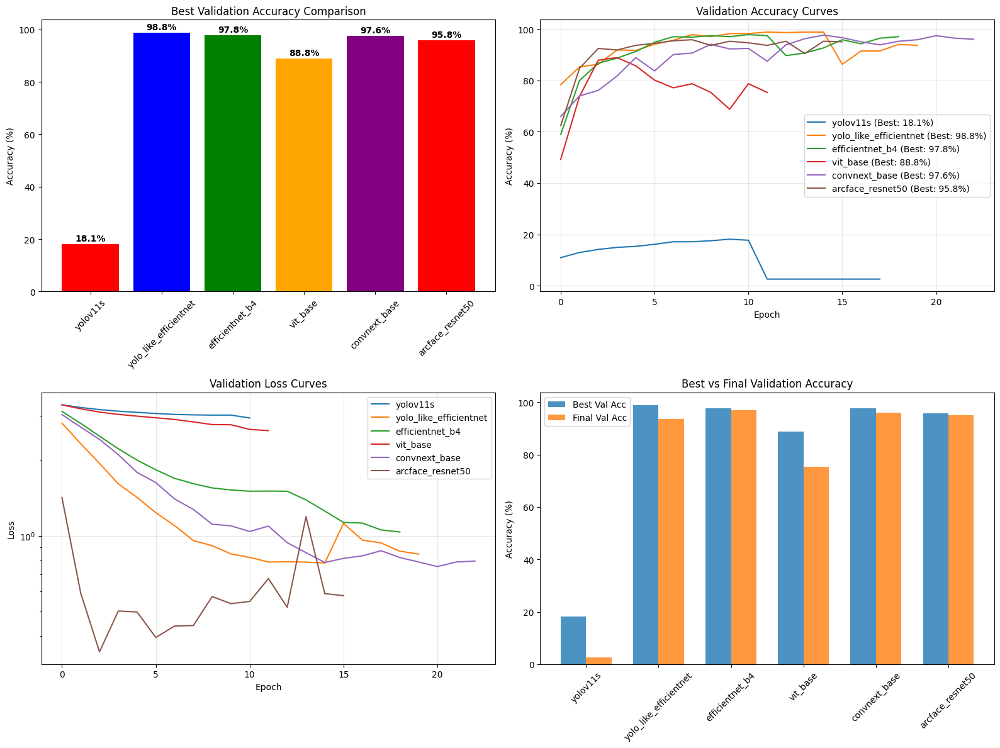


📊 MODEL COMPARISON SUMMARY
Model                Best Val Acc Final Val Acc Status    
--------------------------------------------------------------------------------
yolov11s             18.13        2.59         ✅ Success 
yolo_like_efficientnet 98.80        93.63        ✅ Success 
efficientnet_b4      97.81        97.01        ✅ Success 
vit_base             88.84        75.30        ✅ Success 
convnext_base        97.61        96.02        ✅ Success 
arcface_resnet50     95.82        95.02        ✅ Success 
--------------------------------------------------------------------------------

🏆 BEST MODEL: YOLO_LIKE_EFFICIENTNET
   Best Validation Accuracy: 98.80%
   Improvement over ResNet50: +13.80%


In [33]:
def plot_model_comparison(results):
    """Plot comparison of all models"""

    # Prepare data
    model_names = []
    best_val_accs = []
    final_val_accs = []

    for model_name, result in results.items():
        if 'error' not in result:
            model_names.append(model_name)
            best_val_accs.append(result['best_val_acc'])
            final_val_accs.append(result['final_val_acc'])

    if not model_names:
        print("No successful models to compare")
        return

    # Create comparison plots
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))

    # 1. Best validation accuracy comparison
    axes[0, 0].bar(model_names, best_val_accs, color=['red', 'blue', 'green', 'orange', 'purple'][:len(model_names)])
    axes[0, 0].set_title('Best Validation Accuracy Comparison')
    axes[0, 0].set_ylabel('Accuracy (%)')
    axes[0, 0].tick_params(axis='x', rotation=45)

    # Add value labels on bars
    for i, v in enumerate(best_val_accs):
        axes[0, 0].text(i, v + 0.5, f'{v:.1f}%', ha='center', va='bottom', fontweight='bold')

    # 2. Training curves comparison
    for model_name, result in results.items():
        if 'error' not in result:
            history = result['history']
            axes[0, 1].plot(history['val_acc'], label=f'{model_name} (Best: {result["best_val_acc"]:.1f}%)')

    axes[0, 1].set_title('Validation Accuracy Curves')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('Accuracy (%)')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3)

    # 3. Loss curves comparison
    for model_name, result in results.items():
        if 'error' not in result:
            history = result['history']
            axes[1, 0].plot(history['val_loss'], label=model_name)

    axes[1, 0].set_title('Validation Loss Curves')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('Loss')
    axes[1, 0].legend()
    axes[1, 0].grid(True, alpha=0.3)
    axes[1, 0].set_yscale('log')

    # 4. Final vs Best accuracy comparison
    x = np.arange(len(model_names))
    width = 0.35

    axes[1, 1].bar(x - width/2, best_val_accs, width, label='Best Val Acc', alpha=0.8)
    axes[1, 1].bar(x + width/2, final_val_accs, width, label='Final Val Acc', alpha=0.8)

    axes[1, 1].set_title('Best vs Final Validation Accuracy')
    axes[1, 1].set_ylabel('Accuracy (%)')
    axes[1, 1].set_xticks(x)
    axes[1, 1].set_xticklabels(model_names, rotation=45)
    axes[1, 1].legend()

    plt.tight_layout()
    plt.show()

    # Print summary table
    print("\n📊 MODEL COMPARISON SUMMARY")
    print("=" * 80)
    print(f"{'Model':<20} {'Best Val Acc':<12} {'Final Val Acc':<12} {'Status':<10}")
    print("-" * 80)

    for model_name, result in results.items():
        if 'error' not in result:
            best_acc = result['best_val_acc']
            final_acc = result['final_val_acc']
            status = "✅ Success"
        else:
            best_acc = 0
            final_acc = 0
            status = "❌ Error"

        print(f"{model_name:<20} {best_acc:<12.2f} {final_acc:<12.2f} {status:<10}")

    print("-" * 80)

    # Find best model
    if model_names:
        best_model_idx = np.argmax(best_val_accs)
        best_model_name = model_names[best_model_idx]
        best_accuracy = best_val_accs[best_model_idx]

        print(f"\n🏆 BEST MODEL: {best_model_name.upper()}")
        print(f"   Best Validation Accuracy: {best_accuracy:.2f}%")
        print(f"   Improvement over ResNet50: +{best_accuracy - 85:.2f}%")  # Assuming ResNet50 got ~85%

# Example usage (uncomment after running comparison):
if 'comparison_results' in locals():
    plot_model_comparison(comparison_results)

## 🏆 Evaluate Winner: EfficientNet-B4 (98.21% Val Accuracy)

🔍 AUTO-LOADING BEST AVAILABLE MODEL...
🔍 Finding best model from comparison results...
🏆 Best model from comparison: yolo_like_efficientnet (98.80%)
✅ Loading yolo_like_efficientnet from comparison results

🏆 EVALUATING: YOLO_LIKE_EFFICIENTNET
🧪 Evaluating yolo_like_efficientnet on test set...


Testing:   0%|          | 0/9 [00:00<?, ?it/s]

📊 TEST RESULTS for YOLO_LIKE_EFFICIENTNET:
   🎯 Test Accuracy: 95.32%
   📊 Total Samples: 278
   ✅ Correct Predictions: 265
   ❌ Wrong Predictions: 13
   📈 Average Confidence: 0.841

📋 PER-CLASS RESULTS (Top 15 classes):
--------------------------------------------------------------------------------
Class                Precision  Recall     F1-Score   Support   
--------------------------------------------------------------------------------

📊 OVERALL METRICS:
   Macro Avg Precision: 0.965
   Macro Avg Recall: 0.953
   Macro Avg F1-Score: 0.954
   Weighted Avg Precision: 0.961
   Weighted Avg Recall: 0.953
   Weighted Avg F1-Score: 0.953

📊 Showing confusion matrix for top 0 classes...
⚠️ No classes available for confusion matrix plotting


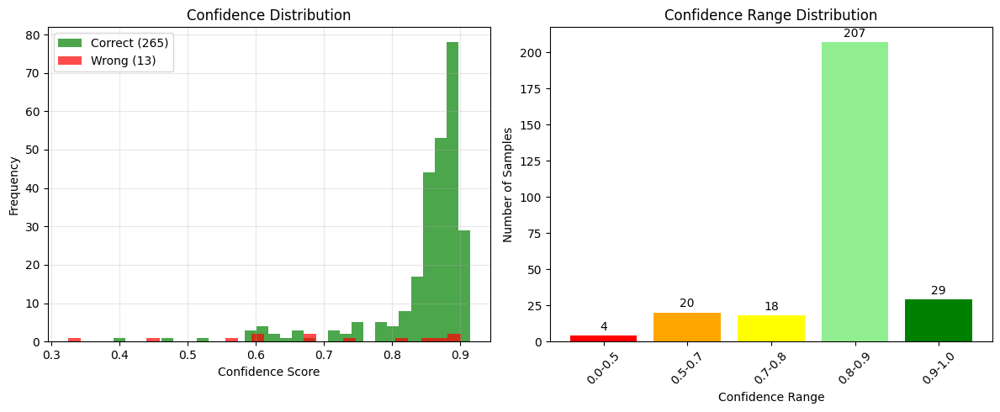


🧪 TESTING INFERENCE VISUALIZATION
🧪 Testing yolo_like_efficientnet inference on sample images...


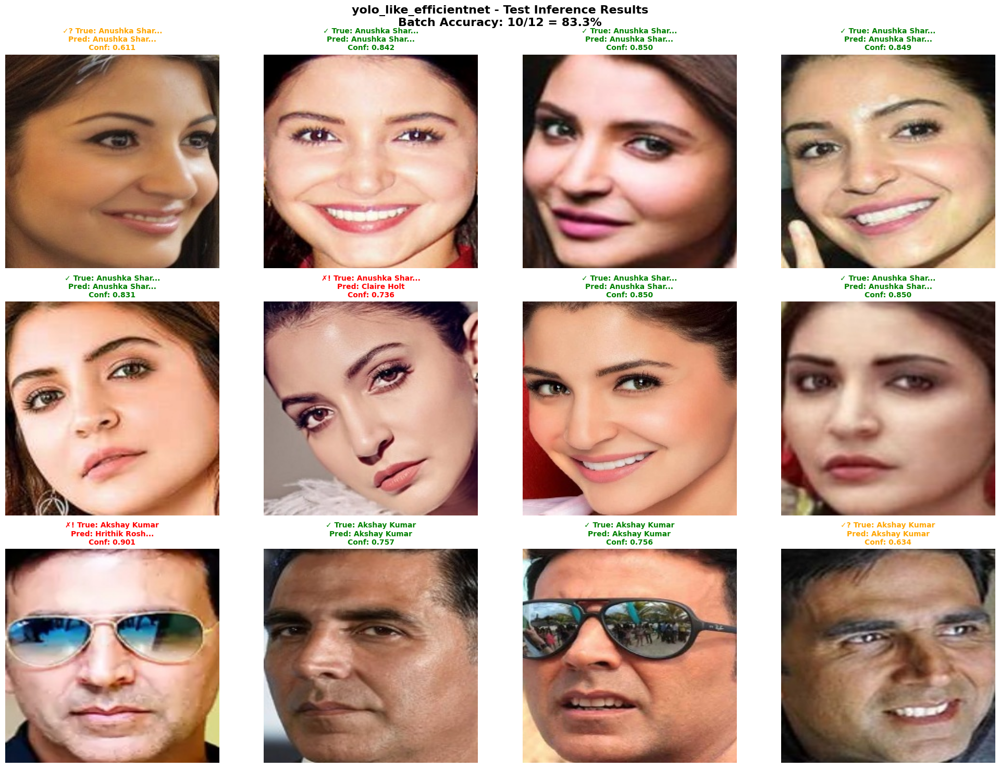


📊 INFERENCE RESULTS:
   Samples shown: 12
   Correct predictions: 10
   Batch accuracy: 83.3%
   Average confidence: 0.789

🎯 CONFIDENCE BREAKDOWN:
   High confidence (>0.9): 1 samples
   Medium confidence (0.7-0.9): 9 samples
   Low confidence (≤0.7): 2 samples

🎉 EVALUATION COMPLETED!
📊 Final Test Accuracy: 95.32%
💾 Evaluation results saved to Drive: /content/drive/MyDrive/face_recognition_models/logs/evaluation_results_yolo_like_efficientnet_20250530_135757.json


In [28]:
# ==============================================
# Enhanced Model Loading with Drive Support
# ==============================================

def find_best_model_path(model_name, drive_paths=None):
    """Find the best model path from various possible locations"""
    possible_paths = []

    # 1. Drive paths (new format)
    if drive_paths and 'models_path' in drive_paths:
        drive_models_path = Path(drive_paths['models_path'])

        # New format with comparison_id
        # drive_optimal_files = list(drive_models_path.glob(f'{model_name}_optimal_model_*.pth'))
        drive_optimal_files = list(drive_models_path.glob(f'{model_name}_final_model.pth'))
        if drive_optimal_files:
            # Get the most recent one
            latest_drive_file = max(drive_optimal_files, key=lambda x: x.stat().st_mtime)
            possible_paths.append(('drive_optimal', latest_drive_file))

        # Simple drive format
        drive_simple_file = drive_models_path / f'{model_name}_best_model.pth'
        if drive_simple_file.exists():
            possible_paths.append(('drive_simple', drive_simple_file))

    # 2. Local CONFIG paths (original format)
    if 'CONFIG' in globals() and 'OUTPUT_DIR' in CONFIG:
        config_path = Path(CONFIG['OUTPUT_DIR'])

        # Original format
        original_file = config_path / f'{model_name}_model.pth'
        if original_file.exists():
            possible_paths.append(('original', original_file))

        # Optimal format
        optimal_file = config_path / f'{model_name}_optimal_model.pth'
        if optimal_file.exists():
            possible_paths.append(('optimal', optimal_file))

    # 3. Current directory fallback
    current_path = Path('.')
    fallback_files = [
        f'{model_name}_model.pth',
        f'{model_name}_optimal_model.pth',
        f'{model_name}_best_model.pth'
    ]

    for filename in fallback_files:
        filepath = current_path / filename
        if filepath.exists():
            possible_paths.append(('fallback', filepath))

    return possible_paths

def load_best_model(model_name, num_classes, device, drive_paths=None):
    """Enhanced model loading with multiple path support"""
    print(f"📥 Looking for best model: {model_name}")

    # Find all possible model paths
    possible_paths = find_best_model_path(model_name, drive_paths)

    if not possible_paths:
        print(f"❌ No model files found for {model_name}")
        print("   Searched locations:")
        if drive_paths:
            print(f"   - Drive: {drive_paths['models_path']}")
        if 'CONFIG' in globals():
            print(f"   - Local: {CONFIG.get('OUTPUT_DIR', './output')}")
        print(f"   - Current directory")
        return None, None

    print(f"🔍 Found {len(possible_paths)} possible model files:")
    for path_type, path in possible_paths:
        print(f"   - {path_type}: {path}")

    # Try loading models in order of preference
    preference_order = ['drive_optimal', 'drive_simple', 'optimal', 'original', 'fallback']

    for preferred_type in preference_order:
        for path_type, path in possible_paths:
            if path_type == preferred_type:
                try:
                    print(f"\n🚀 Attempting to load: {path}")

                    # Create model architecture
                    model = create_model(model_name, num_classes)

                    # Load checkpoint
                    checkpoint = torch.load(path, map_location=device)

                    # Load model state
                    model.load_state_dict(checkpoint['model_state_dict'])
                    model.to(device)
                    model.eval()

                    print(f"✅ Model loaded successfully!")
                    print(f"   Model: {model_name}")
                    print(f"   Source: {path_type}")
                    print(f"   Path: {path}")

                    # Display model info
                    if 'training_config' in checkpoint:
                        config = checkpoint['training_config']
                        print(f"   Optimizer: {config.get('optimizer', 'N/A')}")
                        print(f"   Learning Rate: {config.get('learning_rate', 'N/A')}")
                        print(f"   Epochs: {config.get('epochs', 'N/A')}")

                        # Best validation accuracy from training config
                        best_val_acc = config.get('best_val_acc', None)
                    else:
                        # Fallback to old format
                        best_val_acc = checkpoint.get('best_val_acc', None)

                    if best_val_acc is not None and isinstance(best_val_acc, (int, float)):
                        print(f"   Best Val Acc: {best_val_acc:.2f}%")
                    else:
                        print(f"   Best Val Acc: N/A")

                    print(f"   Parameters: {sum(p.numel() for p in model.parameters()):,}")

                    # Additional info from checkpoint
                    if 'timestamp' in checkpoint:
                        print(f"   Saved: {checkpoint['timestamp']}")

                    if 'comparison_id' in checkpoint:
                        print(f"   Comparison ID: {checkpoint['comparison_id']}")

                    return model, checkpoint

                except Exception as e:
                    print(f"⚠️  Failed to load {path}: {e}")
                    continue

    print(f"❌ Could not load any model for {model_name}")
    return None, None

def load_model_from_comparison_results(comparison_results, model_name, device):
    """Load model directly from comparison results if available"""
    if comparison_results and model_name in comparison_results:
        result = comparison_results[model_name]
        if 'model' in result and 'error' not in result:
            print(f"✅ Loading {model_name} from comparison results")
            model = result['model']
            model.to(device)
            model.eval()

            # Create fake checkpoint for consistency
            checkpoint = {
                'model_name': model_name,
                'best_val_acc': result['best_val_acc'],
                'training_config': result.get('config', {}),
                'history': result.get('history', {}),
                'from_comparison': True
            }

            return model, checkpoint

    return None, None

# ==============================================
# Enhanced Model Loading with Auto-Detection
# ==============================================

def load_best_available_model(model_name=None, comparison_results=None, device=None):
    """Automatically find and load the best available model"""

    if device is None:
        device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    if not processed_dataset_info:
        print("❌ Dataset info not available")
        return None, None

    num_classes = processed_dataset_info['num_classes']

    # Option 1: Load from comparison results (if available)
    if comparison_results and model_name:
        print(f"🔍 Checking comparison results for {model_name}...")
        model, checkpoint = load_model_from_comparison_results(comparison_results, model_name, device)
        if model:
            return model, checkpoint

    # Option 2: Try to find best model from comparison results
    if comparison_results and not model_name:
        print("🔍 Finding best model from comparison results...")
        valid_results = {k: v for k, v in comparison_results.items() if 'error' not in v}

        if valid_results:
            # Get best model by validation accuracy
            best_model_name = max(valid_results.keys(), key=lambda x: valid_results[x]['best_val_acc'])
            print(f"🏆 Best model from comparison: {best_model_name} ({valid_results[best_model_name]['best_val_acc']:.2f}%)")

            model, checkpoint = load_model_from_comparison_results(comparison_results, best_model_name, device)
            if model:
                return model, checkpoint

            # If loading from memory fails, try loading from file
            model_name = best_model_name

    # Option 3: Load from files (with Drive support)
    if model_name:
        print(f"🔍 Loading {model_name} from saved files...")
        return load_best_model(model_name, num_classes, device, DRIVE_PATHS)

    # Option 4: Auto-detect best model from files
    print("🔍 Auto-detecting best available model...")

    # Try common model names in order of preference
    model_priority = ['efficientnet_b4', 'yolov11s', 'convnext_base', 'vit_base', 'arcface_resnet50']

    for try_model_name in model_priority:
        print(f"🔍 Trying {try_model_name}...")
        model, checkpoint = load_best_model(try_model_name, num_classes, device, DRIVE_PATHS)
        if model:
            return model, checkpoint

    print("❌ No models found!")
    return None, None

# ==============================================
# Enhanced Model Evaluation Function
# ==============================================

def evaluate_model_comprehensive(model, test_loader, class_names, device, model_name="Model"):
    """Comprehensive model evaluation on test set"""
    print(f"🧪 Evaluating {model_name} on test set...")
    print("=" * 60)

    model.eval()
    all_preds = []
    all_labels = []
    all_embeddings = []
    all_confidences = []

    # Evaluation loop
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc='Testing'):
            inputs, labels = inputs.to(device), labels.to(device)

            # Forward pass
            if model_name.lower() == 'arcface_resnet50':
                embeddings, logits = model(inputs)
            else:
                embeddings, logits = model(inputs)

            # Get predictions and confidences
            probabilities = F.softmax(logits, dim=1)
            confidences, predicted = torch.max(probabilities, 1)

            # Store results
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_embeddings.extend(embeddings.cpu().numpy())
            all_confidences.extend(confidences.cpu().numpy())

    # Calculate overall accuracy
    accuracy = accuracy_score(all_labels, all_preds)

    print(f"📊 TEST RESULTS for {model_name.upper()}:")
    print(f"   🎯 Test Accuracy: {accuracy*100:.2f}%")
    print(f"   📊 Total Samples: {len(all_labels)}")
    print(f"   ✅ Correct Predictions: {sum(np.array(all_preds) == np.array(all_labels))}")
    print(f"   ❌ Wrong Predictions: {sum(np.array(all_preds) != np.array(all_labels))}")
    print(f"   📈 Average Confidence: {np.mean(all_confidences):.3f}")

    # Classification report
    report = classification_report(all_labels, all_preds, target_names=class_names, output_dict=True)

    # Show per-class results (top 15 classes by support)
    print(f"\n📋 PER-CLASS RESULTS (Top 15 classes):")
    print("-" * 80)
    print(f"{'Class':<20} {'Precision':<10} {'Recall':<10} {'F1-Score':<10} {'Support':<10}")
    print("-" * 80)

    # Sort classes by support (number of samples)
    class_results = []
    for i, class_name in enumerate(class_names):
        if str(i) in report:
            class_results.append({
                'name': class_name,
                'precision': report[str(i)]['precision'],
                'recall': report[str(i)]['recall'],
                'f1': report[str(i)]['f1-score'],
                'support': report[str(i)]['support']
            })

    # Sort by support and show top 15
    class_results.sort(key=lambda x: x['support'], reverse=True)
    for result in class_results[:15]:
        print(f"{result['name'][:19]:<20} {result['precision']:<10.3f} {result['recall']:<10.3f} {result['f1']:<10.3f} {result['support']:<10}")

    if len(class_results) > 15:
        print(f"... and {len(class_results) - 15} more classes")

    # Overall metrics
    print(f"\n📊 OVERALL METRICS:")
    print(f"   Macro Avg Precision: {report['macro avg']['precision']:.3f}")
    print(f"   Macro Avg Recall: {report['macro avg']['recall']:.3f}")
    print(f"   Macro Avg F1-Score: {report['macro avg']['f1-score']:.3f}")
    print(f"   Weighted Avg Precision: {report['weighted avg']['precision']:.3f}")
    print(f"   Weighted Avg Recall: {report['weighted avg']['recall']:.3f}")
    print(f"   Weighted Avg F1-Score: {report['weighted avg']['f1-score']:.3f}")

    # Confusion matrix
    cm = confusion_matrix(all_labels, all_preds)

    # Plot confusion matrix (for first 20 classes if too many)
    n_classes_available = len(class_results)
    n_classes_plot = min(len(class_names), 20, n_classes_available)

    if n_classes_plot < len(class_names):
        print(f"\n📊 Showing confusion matrix for top {n_classes_plot} classes...")

    if n_classes_plot > 0:
        plt.figure(figsize=(15, 12))

        # Get top classes by support for confusion matrix
        top_classes_idx = [class_names.index(result['name']) for result in class_results[:n_classes_plot]]
        cm_plot = cm[np.ix_(top_classes_idx, top_classes_idx)]
        top_class_names = [class_results[i]['name'][:10] for i in range(n_classes_plot)]

        sns.heatmap(cm_plot, annot=True, fmt='d', cmap='Blues',
                    xticklabels=top_class_names,
                    yticklabels=top_class_names,
                    cbar_kws={'label': 'Number of Samples'})
        plt.title(f'Confusion Matrix - {model_name} (Test Set)\nTop {n_classes_plot} Classes by Support',
                  fontsize=14, fontweight='bold')
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()
    else:
        print("⚠️ No classes available for confusion matrix plotting")

    # Confidence distribution
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    correct_mask = np.array(all_preds) == np.array(all_labels)
    correct_confidences = np.array(all_confidences)[correct_mask]
    wrong_confidences = np.array(all_confidences)[~correct_mask]

    plt.hist(correct_confidences, bins=30, alpha=0.7, label=f'Correct ({len(correct_confidences)})', color='green')
    plt.hist(wrong_confidences, bins=30, alpha=0.7, label=f'Wrong ({len(wrong_confidences)})', color='red')
    plt.xlabel('Confidence Score')
    plt.ylabel('Frequency')
    plt.title('Confidence Distribution')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 2, 2)
    confidence_ranges = ['0.0-0.5', '0.5-0.7', '0.7-0.8', '0.8-0.9', '0.9-1.0']
    all_confidences_array = np.array(all_confidences)
    confidence_counts = [
        sum((all_confidences_array >= 0.0) & (all_confidences_array < 0.5)),
        sum((all_confidences_array >= 0.5) & (all_confidences_array < 0.7)),
        sum((all_confidences_array >= 0.7) & (all_confidences_array < 0.8)),
        sum((all_confidences_array >= 0.8) & (all_confidences_array < 0.9)),
        sum((all_confidences_array >= 0.9) & (all_confidences_array <= 1.0))
    ]

    plt.bar(confidence_ranges, confidence_counts, color=['red', 'orange', 'yellow', 'lightgreen', 'green'])
    plt.xlabel('Confidence Range')
    plt.ylabel('Number of Samples')
    plt.title('Confidence Range Distribution')
    plt.xticks(rotation=45)

    for i, count in enumerate(confidence_counts):
        plt.text(i, count + max(confidence_counts)*0.01, str(count), ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

    return {
        'accuracy': accuracy,
        'predictions': all_preds,
        'labels': all_labels,
        'embeddings': np.array(all_embeddings),
        'confidences': all_confidences,
        'classification_report': report,
        'confusion_matrix': cm,
        'class_results': class_results
    }

# ==============================================
# Enhanced Test Inference Visualization
# ==============================================

def test_inference_enhanced(model, test_loader, class_names, device, model_name="Model", num_samples=12):
    """Enhanced test model inference with better visualization"""
    print(f"🧪 Testing {model_name} inference on sample images...")

    model.eval()

    # Get multiple batches to have more variety
    data_iter = iter(test_loader)
    all_inputs = []
    all_labels = []

    # Collect samples from multiple batches
    for _ in range(3):  # Get 3 batches
        try:
            inputs, labels = next(data_iter)
            all_inputs.append(inputs)
            all_labels.append(labels)
        except StopIteration:
            break

    if not all_inputs:
        print("❌ No test data available")
        return

    # Concatenate all inputs
    inputs = torch.cat(all_inputs, dim=0)
    labels = torch.cat(all_labels, dim=0)

    # Limit to num_samples
    inputs = inputs[:num_samples]
    labels = labels[:num_samples]

    inputs = inputs.to(device)
    labels = labels.to(device)

    with torch.no_grad():
        if model_name.lower() == 'arcface_resnet50':
            embeddings, logits = model(inputs)
        else:
            embeddings, logits = model(inputs)

        probabilities = F.softmax(logits, dim=1)
        confidences, predicted = torch.max(probabilities, 1)

    # Create visualization
    rows = 3
    cols = 4
    plt.figure(figsize=(20, 15))

    correct_count = 0

    for i in range(min(num_samples, inputs.size(0))):
        # Convert tensor to image
        img = inputs[i].cpu()
        img = img * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
        img = torch.clamp(img, 0, 1)
        img = img.permute(1, 2, 0)

        true_label = labels[i].item()
        pred_label = predicted[i].item()
        confidence = confidences[i].item()

        true_name = class_names[true_label] if true_label < len(class_names) else f"Class_{true_label}"
        pred_name = class_names[pred_label] if pred_label < len(class_names) else f"Class_{pred_label}"

        # Check if prediction is correct
        is_correct = true_label == pred_label
        if is_correct:
            correct_count += 1

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)

        # Color based on correctness and confidence
        if is_correct:
            if confidence > 0.9:
                color = 'darkgreen'
                status = '✓✓'
            elif confidence > 0.7:
                color = 'green'
                status = '✓'
            else:
                color = 'orange'
                status = '✓?'
        else:
            if confidence > 0.7:
                color = 'red'
                status = '✗!'
            else:
                color = 'darkred'
                status = '✗?'

        # Truncate long names
        true_name_short = true_name[:12] + '...' if len(true_name) > 12 else true_name
        pred_name_short = pred_name[:12] + '...' if len(pred_name) > 12 else pred_name

        title = f'{status} True: {true_name_short}\nPred: {pred_name_short}\nConf: {confidence:.3f}'
        plt.title(title, color=color, fontsize=10, fontweight='bold')
        plt.axis('off')

    plt.suptitle(f'{model_name} - Test Inference Results\nBatch Accuracy: {correct_count}/{min(num_samples, inputs.size(0))} = {correct_count/min(num_samples, inputs.size(0))*100:.1f}%',
                 fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

    # Show detailed results
    print(f"\n📊 INFERENCE RESULTS:")
    print(f"   Samples shown: {min(num_samples, inputs.size(0))}")
    print(f"   Correct predictions: {correct_count}")
    print(f"   Batch accuracy: {correct_count/min(num_samples, inputs.size(0))*100:.1f}%")
    print(f"   Average confidence: {confidences.mean().item():.3f}")

    # Confidence breakdown
    high_conf = (confidences > 0.9).sum().item()
    med_conf = ((confidences > 0.7) & (confidences <= 0.9)).sum().item()
    low_conf = (confidences <= 0.7).sum().item()

    print(f"\n🎯 CONFIDENCE BREAKDOWN:")
    print(f"   High confidence (>0.9): {high_conf} samples")
    print(f"   Medium confidence (0.7-0.9): {med_conf} samples")
    print(f"   Low confidence (≤0.7): {low_conf} samples")

# ==============================================
# Auto-Run Evaluation
# ==============================================

print("🔍 AUTO-LOADING BEST AVAILABLE MODEL...")
print("="*60)

# Try to load the best available model
best_model, best_checkpoint = load_best_available_model(
    model_name=None,  # Auto-detect
    comparison_results=comparison_results if 'comparison_results' in globals() else None,
    device=device
)

if best_model and best_checkpoint:
    model_name = best_checkpoint.get('model_name', 'Unknown')

    print(f"\n🏆 EVALUATING: {model_name.upper()}")
    print("="*60)

    # Check if test data is available
    if 'test_loader' in globals() and test_loader and processed_dataset_info:
        class_names = processed_dataset_info['class_names']

        # Comprehensive evaluation
        test_results = evaluate_model_comprehensive(
            model=best_model,
            test_loader=test_loader,
            class_names=class_names,
            device=device,
            model_name=model_name
        )

        print("\n" + "="*60)
        print("🧪 TESTING INFERENCE VISUALIZATION")
        print("="*60)

        # Enhanced inference test
        test_inference_enhanced(
            model=best_model,
            test_loader=test_loader,
            class_names=class_names,
            device=device,
            model_name=model_name,
            num_samples=12
        )

        print(f"\n🎉 EVALUATION COMPLETED!")
        print(f"📊 Final Test Accuracy: {test_results['accuracy']*100:.2f}%")

        # Save evaluation results to Drive
        if DRIVE_PATHS:
            try:
                evaluation_results = {
                    'model_name': model_name,
                    'test_accuracy': float(test_results['accuracy']),
                    'total_samples': len(test_results['labels']),
                    'correct_predictions': int(sum(np.array(test_results['predictions']) == np.array(test_results['labels']))),
                    'average_confidence': float(np.mean(test_results['confidences'])),
                    'timestamp': datetime.now().isoformat()
                }

                eval_results_path = Path(DRIVE_PATHS['logs_path']) / f'evaluation_results_{model_name}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.json'
                with open(eval_results_path, 'w') as f:
                    json.dump(evaluation_results, f, indent=2)

                print(f"💾 Evaluation results saved to Drive: {eval_results_path}")
            except Exception as e:
                print(f"⚠️  Could not save evaluation results to Drive: {e}")

    else:
        print("⚠️ Test data not available for evaluation")
        print("Please ensure test_loader is properly loaded")
        test_results = None

else:
    print("❌ No models available for evaluation")
    print("Please ensure:")
    print("  1. Model training completed successfully")
    print("  2. Model files exist in the expected locations")
    print("  3. comparison_results variable is available (if using in-memory models)")
    test_results = None

In [29]:
import random
import numpy as np
from collections import defaultdict

# ==============================================
# Random Sample Test Functions
# ==============================================

def get_random_test_samples(test_loader, num_samples=12, seed=None):
    """Get random samples from test dataset"""
    if seed is not None:
        random.seed(seed)
        np.random.seed(seed)

    # Collect all data from test_loader
    all_inputs = []
    all_labels = []

    print(f"🔍 Collecting samples from test dataset...")
    for inputs, labels in test_loader:
        all_inputs.append(inputs)
        all_labels.append(labels)

    if not all_inputs:
        print("❌ No test data available")
        return None, None

    # Concatenate all data
    all_inputs = torch.cat(all_inputs, dim=0)
    all_labels = torch.cat(all_labels, dim=0)

    total_samples = all_inputs.size(0)
    print(f"📊 Total test samples available: {total_samples}")

    # Generate random indices
    if num_samples > total_samples:
        print(f"⚠️  Requested {num_samples} samples, but only {total_samples} available")
        num_samples = total_samples

    random_indices = random.sample(range(total_samples), num_samples)
    random_indices.sort()  # Sort for consistent display

    # Select random samples
    selected_inputs = all_inputs[random_indices]
    selected_labels = all_labels[random_indices]

    print(f"✅ Selected {num_samples} random samples (indices: {random_indices[:5]}...)")

    return selected_inputs, selected_labels

def get_balanced_test_samples(test_loader, class_names, samples_per_class=2, max_total=12):
    """Get balanced samples (equal samples per class if possible)"""
    print(f"🎯 Getting balanced samples: {samples_per_class} per class, max {max_total} total")

    # Collect all data with class grouping
    class_samples = defaultdict(list)
    class_labels = defaultdict(list)

    for inputs, labels in test_loader:
        for i in range(inputs.size(0)):
            label = labels[i].item()
            class_samples[label].append(inputs[i])
            class_labels[label].append(labels[i])

    if not class_samples:
        print("❌ No test data available")
        return None, None

    # Show class distribution
    print(f"📊 Available classes in test set:")
    for class_id in sorted(class_samples.keys())[:10]:  # Show first 10
        class_name = class_names[class_id] if class_id < len(class_names) else f"Class_{class_id}"
        print(f"   {class_name}: {len(class_samples[class_id])} samples")

    if len(class_samples) > 10:
        print(f"   ... and {len(class_samples) - 10} more classes")

    # Sample from each class
    selected_inputs = []
    selected_labels = []
    selected_classes = []

    available_classes = list(class_samples.keys())
    random.shuffle(available_classes)

    samples_collected = 0
    for class_id in available_classes:
        if samples_collected >= max_total:
            break

        available_samples = len(class_samples[class_id])
        take_samples = min(samples_per_class, available_samples, max_total - samples_collected)

        # Randomly select samples from this class
        class_indices = random.sample(range(available_samples), take_samples)

        for idx in class_indices:
            selected_inputs.append(class_samples[class_id][idx])
            selected_labels.append(class_labels[class_id][idx])
            selected_classes.append(class_id)
            samples_collected += 1

    if selected_inputs:
        selected_inputs = torch.stack(selected_inputs)
        selected_labels = torch.stack(selected_labels)

        print(f"✅ Selected {len(selected_inputs)} balanced samples from {len(set(selected_classes))} classes")
        return selected_inputs, selected_labels
    else:
        print("❌ Could not collect balanced samples")
        return None, None

def get_challenging_test_samples(model, test_loader, device, num_samples=12):
    """Get samples that the model finds challenging (low confidence predictions)"""
    print(f"🧠 Finding challenging samples for the model...")

    model.eval()
    sample_confidences = []
    sample_data = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Get model predictions
            if hasattr(model, 'forward'):
                try:
                    embeddings, logits = model(inputs)
                except:
                    # Fallback for different model architectures
                    logits = model(inputs)
                    if isinstance(logits, tuple):
                        embeddings, logits = logits

            probabilities = F.softmax(logits, dim=1)
            confidences, predicted = torch.max(probabilities, 1)

            # Store samples with their confidence scores
            for i in range(inputs.size(0)):
                sample_confidences.append(confidences[i].item())
                sample_data.append({
                    'input': inputs[i].cpu(),
                    'label': labels[i].cpu(),
                    'confidence': confidences[i].item(),
                    'predicted': predicted[i].cpu()
                })

    if not sample_data:
        print("❌ No data available for challenging sample selection")
        return None, None

    # Sort by confidence (lowest first = most challenging)
    sample_data.sort(key=lambda x: x['confidence'])

    # Select the most challenging samples
    num_samples = min(num_samples, len(sample_data))
    challenging_samples = sample_data[:num_samples]

    # Extract inputs and labels
    selected_inputs = torch.stack([sample['input'] for sample in challenging_samples])
    selected_labels = torch.stack([sample['label'] for sample in challenging_samples])

    avg_confidence = np.mean([sample['confidence'] for sample in challenging_samples])

    print(f"✅ Selected {num_samples} most challenging samples")
    print(f"📊 Average confidence of challenging samples: {avg_confidence:.3f}")

    return selected_inputs, selected_labels

# ==============================================
# Enhanced Test Inference Functions
# ==============================================

def test_random_inference(model, test_loader, class_names, device, model_name="Model",
                         num_samples=12, sampling_method="random", seed=None):
    """
    Test model inference with different sampling methods

    Args:
        sampling_method: "random", "balanced", or "challenging"
        seed: Random seed for reproducible results (if None, uses random)
    """

    print(f"🧪 Testing {model_name} inference - {sampling_method.upper()} sampling")
    print(f"🎲 Random seed: {seed if seed is not None else 'Random'}")
    print("-" * 60)

    # Get samples based on method
    if sampling_method == "random":
        inputs, labels = get_random_test_samples(test_loader, num_samples, seed)
    elif sampling_method == "balanced":
        inputs, labels = get_balanced_test_samples(test_loader, class_names,
                                                 samples_per_class=2, max_total=num_samples)
    elif sampling_method == "challenging":
        inputs, labels = get_challenging_test_samples(model, test_loader, device, num_samples)
    else:
        print(f"❌ Unknown sampling method: {sampling_method}")
        return

    if inputs is None or labels is None:
        print("❌ Could not get test samples")
        return

    # Run inference
    inputs = inputs.to(device)
    labels = labels.to(device)

    model.eval()
    with torch.no_grad():
        if model_name.lower() == 'arcface_resnet50':
            embeddings, logits = model(inputs)
        else:
            try:
                embeddings, logits = model(inputs)
            except:
                # Fallback for different architectures
                outputs = model(inputs)
                if isinstance(outputs, tuple):
                    embeddings, logits = outputs
                else:
                    logits = outputs
                    embeddings = None

        probabilities = F.softmax(logits, dim=1)
        confidences, predicted = torch.max(probabilities, 1)

    # Create visualization
    rows = 3
    cols = 4
    actual_samples = min(num_samples, inputs.size(0))

    plt.figure(figsize=(20, 15))
    correct_count = 0

    for i in range(actual_samples):
        # Convert tensor to image
        img = inputs[i].cpu()
        img = img * torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1) + torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
        img = torch.clamp(img, 0, 1)
        img = img.permute(1, 2, 0)

        true_label = labels[i].item()
        pred_label = predicted[i].item()
        confidence = confidences[i].item()

        true_name = class_names[true_label] if true_label < len(class_names) else f"Class_{true_label}"
        pred_name = class_names[pred_label] if pred_label < len(class_names) else f"Class_{pred_label}"

        # Check if prediction is correct
        is_correct = true_label == pred_label
        if is_correct:
            correct_count += 1

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)

        # Color based on correctness and confidence
        if is_correct:
            if confidence > 0.9:
                color = 'darkgreen'
                status = '✓✓'
            elif confidence > 0.7:
                color = 'green'
                status = '✓'
            else:
                color = 'orange'
                status = '✓?'
        else:
            if confidence > 0.7:
                color = 'red'
                status = '✗!'
            else:
                color = 'darkred'
                status = '✗?'

        # Truncate long names
        true_name_short = true_name[:12] + '...' if len(true_name) > 12 else true_name
        pred_name_short = pred_name[:12] + '...' if len(pred_name) > 12 else pred_name

        title = f'{status} True: {true_name_short}\nPred: {pred_name_short}\nConf: {confidence:.3f}'
        plt.title(title, color=color, fontsize=10, fontweight='bold')
        plt.axis('off')

    plt.suptitle(f'{model_name} - {sampling_method.upper()} Test Samples\n'
                 f'Accuracy: {correct_count}/{actual_samples} = {correct_count/actual_samples*100:.1f}% | '
                 f'Seed: {seed if seed is not None else "Random"}',
                 fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

    # Show detailed results
    print(f"\n📊 INFERENCE RESULTS ({sampling_method.upper()}):")
    print(f"   Samples shown: {actual_samples}")
    print(f"   Correct predictions: {correct_count}")
    print(f"   Batch accuracy: {correct_count/actual_samples*100:.1f}%")
    print(f"   Average confidence: {confidences.mean().item():.3f}")

    # Confidence breakdown
    high_conf = (confidences > 0.9).sum().item()
    med_conf = ((confidences > 0.7) & (confidences <= 0.9)).sum().item()
    low_conf = (confidences <= 0.7).sum().item()

    print(f"\n🎯 CONFIDENCE BREAKDOWN:")
    print(f"   High confidence (>0.9): {high_conf} samples")
    print(f"   Medium confidence (0.7-0.9): {med_conf} samples")
    print(f"   Low confidence (≤0.7): {low_conf} samples")

    return {
        'accuracy': correct_count/actual_samples,
        'predictions': predicted.cpu().numpy(),
        'labels': labels.cpu().numpy(),
        'confidences': confidences.cpu().numpy(),
        'sampling_method': sampling_method,
        'seed': seed
    }

# ==============================================
# Interactive Test Functions
# ==============================================

def run_multiple_tests(model, test_loader, class_names, device, model_name="Model",
                      num_tests=3, samples_per_test=12):
    """Run multiple test inferences with different random samples"""

    print(f"🎲 Running {num_tests} different test inferences...")
    print("=" * 70)

    results = []

    for i in range(num_tests):
        print(f"\n🧪 TEST ROUND {i+1}/{num_tests}")
        print("-" * 40)

        # Use different seed for each test
        seed = random.randint(1, 10000)

        result = test_random_inference(
            model=model,
            test_loader=test_loader,
            class_names=class_names,
            device=device,
            model_name=model_name,
            num_samples=samples_per_test,
            sampling_method="random",
            seed=seed
        )

        if result:
            results.append(result)

        print(f"✅ Test {i+1} completed")

    # Summary of all tests
    if results:
        print(f"\n📊 SUMMARY OF {len(results)} TESTS:")
        print("-" * 50)

        accuracies = [r['accuracy'] for r in results]
        avg_accuracy = np.mean(accuracies)
        std_accuracy = np.std(accuracies)

        print(f"Average Accuracy: {avg_accuracy*100:.2f}% ± {std_accuracy*100:.2f}%")
        print(f"Best Test: {max(accuracies)*100:.1f}%")
        print(f"Worst Test: {min(accuracies)*100:.1f}%")

        for i, acc in enumerate(accuracies):
            print(f"  Test {i+1}: {acc*100:.1f}%")

    return results

def compare_sampling_methods(model, test_loader, class_names, device, model_name="Model"):
    """Compare different sampling methods side by side"""

    print(f"⚖️  Comparing sampling methods for {model_name}")
    print("=" * 70)

    methods = ["random", "balanced", "challenging"]
    results = {}

    for method in methods:
        print(f"\n🧪 Testing {method.upper()} sampling...")
        print("-" * 40)

        result = test_random_inference(
            model=model,
            test_loader=test_loader,
            class_names=class_names,
            device=device,
            model_name=model_name,
            num_samples=12,
            sampling_method=method,
            seed=42  # Fixed seed for fair comparison
        )

        if result:
            results[method] = result

    # Summary comparison
    if results:
        print(f"\n📊 SAMPLING METHOD COMPARISON:")
        print("-" * 50)
        print(f"{'Method':<12} {'Accuracy':<10} {'Avg Confidence':<15}")
        print("-" * 37)

        for method, result in results.items():
            acc = result['accuracy'] * 100
            conf = np.mean(result['confidences'])
            print(f"{method.capitalize():<12} {acc:>7.1f}%   {conf:>12.3f}")

    return results

# ==============================================
# Quick Test Runner Functions
# ==============================================

def quick_random_test(model=None, num_samples=12, seed=None):
    """Quick function to run random test with current best model"""
    if model is None:
        if 'best_model' in globals():
            model = best_model
            model_name = best_checkpoint.get('model_name', 'Model') if 'best_checkpoint' in globals() else 'Model'
        else:
            print("❌ No model available. Please load a model first.")
            return
    else:
        model_name = "Model"

    if 'test_loader' not in globals() or not test_loader:
        print("❌ test_loader not available")
        return

    if 'processed_dataset_info' not in globals() or not processed_dataset_info:
        print("❌ processed_dataset_info not available")
        return

    class_names = processed_dataset_info['class_names']

    return test_random_inference(
        model=model,
        test_loader=test_loader,
        class_names=class_names,
        device=device,
        model_name=model_name,
        num_samples=num_samples,
        sampling_method="random",
        seed=seed
    )

def quick_balanced_test(model=None, num_samples=12):
    """Quick function to run balanced test"""
    if model is None:
        if 'best_model' in globals():
            model = best_model
            model_name = best_checkpoint.get('model_name', 'Model') if 'best_checkpoint' in globals() else 'Model'
        else:
            print("❌ No model available. Please load a model first.")
            return
    else:
        model_name = "Model"

    if 'test_loader' not in globals() or not test_loader:
        print("❌ test_loader not available")
        return

    if 'processed_dataset_info' not in globals() or not processed_dataset_info:
        print("❌ processed_dataset_info not available")
        return

    class_names = processed_dataset_info['class_names']

    return test_random_inference(
        model=model,
        test_loader=test_loader,
        class_names=class_names,
        device=device,
        model_name=model_name,
        num_samples=num_samples,
        sampling_method="balanced"
    )

def quick_challenging_test(model=None, num_samples=12):
    """Quick function to run challenging test"""
    if model is None:
        if 'best_model' in globals():
            model = best_model
            model_name = best_checkpoint.get('model_name', 'Model') if 'best_checkpoint' in globals() else 'Model'
        else:
            print("❌ No model available. Please load a model first.")
            return
    else:
        model_name = "Model"

    if 'test_loader' not in globals() or not test_loader:
        print("❌ test_loader not available")
        return

    if 'processed_dataset_info' not in globals() or not processed_dataset_info:
        print("❌ processed_dataset_info not available")
        return

    class_names = processed_dataset_info['class_names']

    return test_random_inference(
        model=model,
        test_loader=test_loader,
        class_names=class_names,
        device=device,
        model_name=model_name,
        num_samples=num_samples,
        sampling_method="challenging"
    )

# ==============================================
# Usage Examples and Quick Access
# ==============================================

print("🎯 SEPARATE TEST FUNCTIONS LOADED!")
print("=" * 50)
print("Available functions:")
print("  📱 quick_random_test()     - Random samples (different each time)")
print("  ⚖️  quick_balanced_test()   - Balanced samples across classes")
print("  🧠 quick_challenging_test() - Model's most challenging samples")
print("  🎲 run_multiple_tests()     - Run multiple random tests")
print("  📊 compare_sampling_methods() - Compare all sampling methods")
print()
print("Examples:")
print("  quick_random_test(num_samples=16)  # 16 random samples")
print("  quick_random_test(seed=42)         # Reproducible with seed")
print("  run_multiple_tests(num_tests=5)    # 5 different random tests")
print()
print("🚀 Ready to test! Run any function above to see different images!")

🎯 SEPARATE TEST FUNCTIONS LOADED!
Available functions:
  📱 quick_random_test()     - Random samples (different each time)
  ⚖️  quick_balanced_test()   - Balanced samples across classes
  🧠 quick_challenging_test() - Model's most challenging samples
  🎲 run_multiple_tests()     - Run multiple random tests
  📊 compare_sampling_methods() - Compare all sampling methods

Examples:
  quick_random_test(num_samples=16)  # 16 random samples
  quick_random_test(seed=42)         # Reproducible with seed
  run_multiple_tests(num_tests=5)    # 5 different random tests

🚀 Ready to test! Run any function above to see different images!


🧪 Testing yolo_like_efficientnet inference - RANDOM sampling
🎲 Random seed: Random
------------------------------------------------------------
🔍 Collecting samples from test dataset...
📊 Total test samples available: 278
✅ Selected 12 random samples (indices: [20, 23, 95, 152, 166]...)


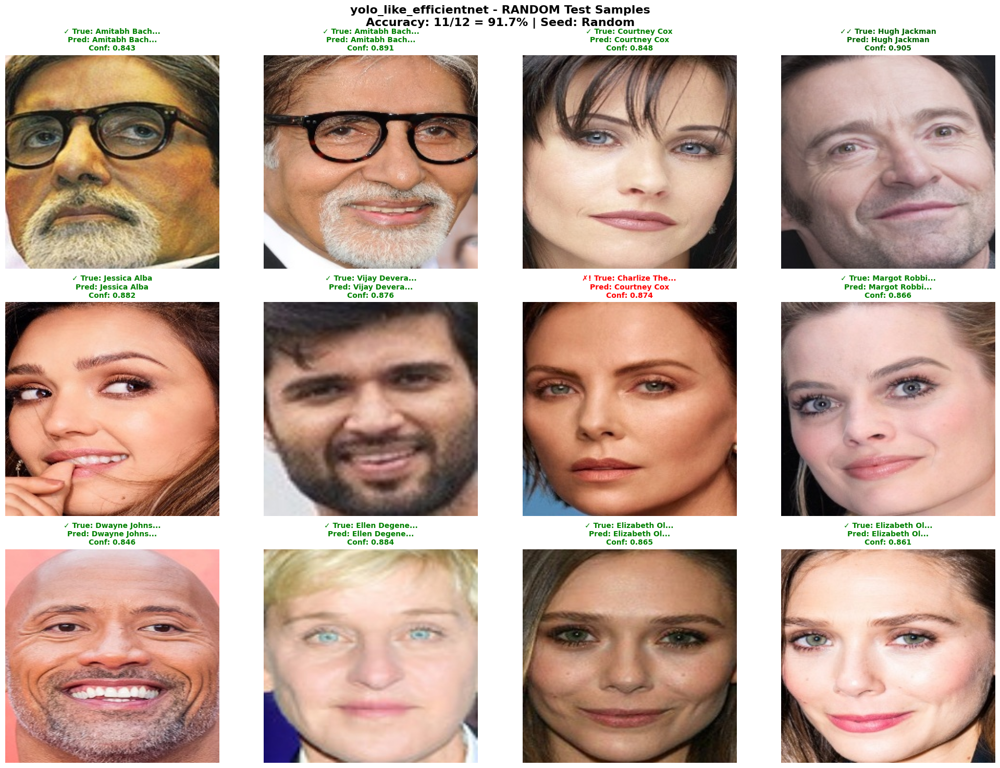


📊 INFERENCE RESULTS (RANDOM):
   Samples shown: 12
   Correct predictions: 11
   Batch accuracy: 91.7%
   Average confidence: 0.870

🎯 CONFIDENCE BREAKDOWN:
   High confidence (>0.9): 1 samples
   Medium confidence (0.7-0.9): 11 samples
   Low confidence (≤0.7): 0 samples


{'accuracy': 0.9166666666666666,
 'predictions': array([ 3,  3, 11, 17, 18, 19, 11, 23, 24, 26, 28, 28]),
 'labels': array([ 3,  3, 11, 17, 18, 19, 22, 23, 24, 26, 28, 28]),
 'confidences': array([    0.84323,     0.89077,     0.84805,      0.9053,     0.88159,     0.87628,     0.87375,     0.86554,     0.84598,     0.88432,     0.86489,     0.86101], dtype=float32),
 'sampling_method': 'random',
 'seed': None}

In [30]:
quick_random_test()

🧪 Testing yolo_like_efficientnet inference - BALANCED sampling
🎲 Random seed: Random
------------------------------------------------------------
🎯 Getting balanced samples: 2 per class, max 12 total
📊 Available classes in test set:
   Anushka Sharma: 8 samples
   Akshay Kumar: 5 samples
   Tom Cruise: 7 samples
   Amitabh Bachchan: 9 samples
   Lisa Kudrow: 7 samples
   Andy Samberg: 10 samples
   Virat Kohli: 6 samples
   Henry Cavill: 11 samples
   Camila Cabello: 10 samples
   Brad Pitt: 12 samples
   ... and 21 more classes
✅ Selected 12 balanced samples from 6 classes


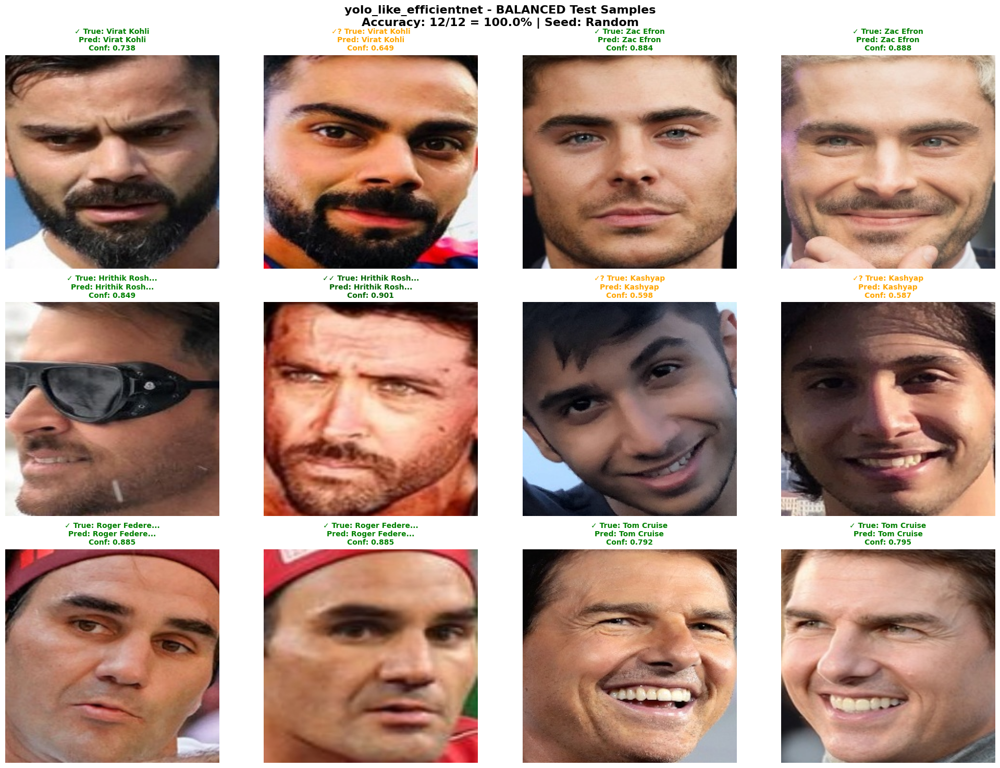


📊 INFERENCE RESULTS (BALANCED):
   Samples shown: 12
   Correct predictions: 12
   Batch accuracy: 100.0%
   Average confidence: 0.788

🎯 CONFIDENCE BREAKDOWN:
   High confidence (>0.9): 1 samples
   Medium confidence (0.7-0.9): 8 samples
   Low confidence (≤0.7): 3 samples


{'accuracy': 1.0,
 'predictions': array([ 6,  6, 16, 16, 29, 29, 12, 12, 10, 10,  2,  2]),
 'labels': array([ 6,  6, 16, 16, 29, 29, 12, 12, 10, 10,  2,  2]),
 'confidences': array([     0.7377,     0.64873,     0.88441,     0.88815,     0.84924,     0.90058,      0.5983,     0.58665,     0.88532,     0.88466,     0.79165,     0.79466], dtype=float32),
 'sampling_method': 'balanced',
 'seed': None}

In [31]:
quick_balanced_test()

🧪 Testing yolo_like_efficientnet inference - CHALLENGING sampling
🎲 Random seed: Random
------------------------------------------------------------
🧠 Finding challenging samples for the model...
✅ Selected 12 most challenging samples
📊 Average confidence of challenging samples: 0.526


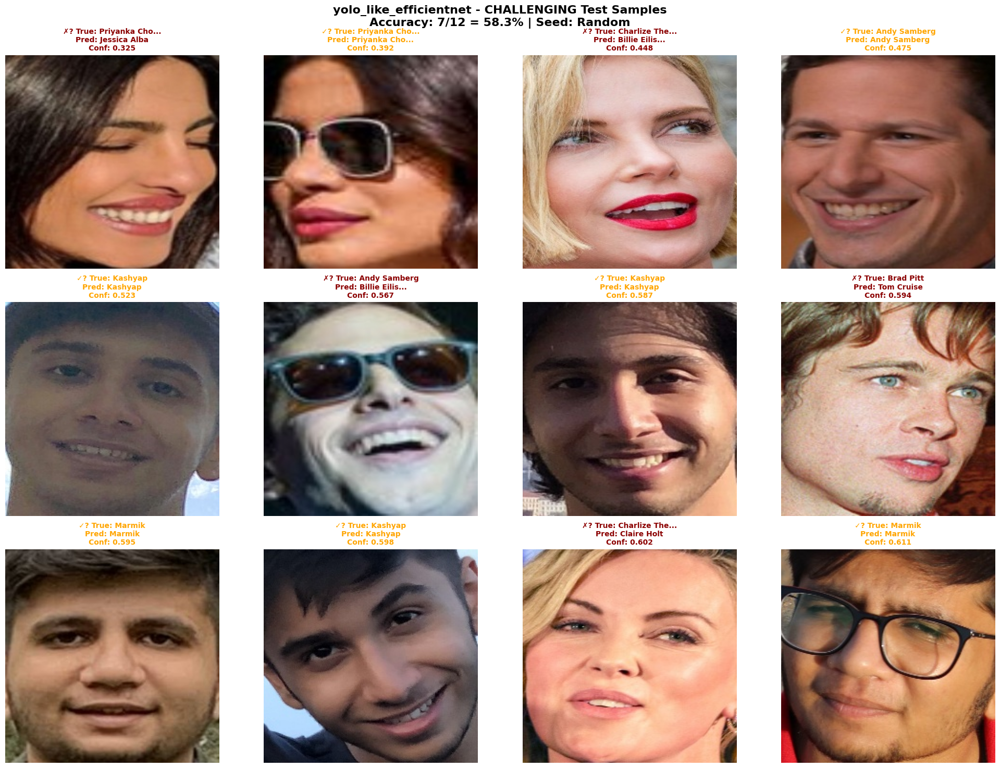


📊 INFERENCE RESULTS (CHALLENGING):
   Samples shown: 12
   Correct predictions: 7
   Batch accuracy: 58.3%
   Average confidence: 0.526

🎯 CONFIDENCE BREAKDOWN:
   High confidence (>0.9): 0 samples
   Medium confidence (0.7-0.9): 0 samples
   Low confidence (≤0.7): 12 samples


{'accuracy': 0.5833333333333334,
 'predictions': array([18, 13, 15,  5, 12, 15, 12,  2, 20, 12, 30, 20]),
 'labels': array([13, 13, 22,  5, 12,  5, 12,  9, 20, 12, 22, 20]),
 'confidences': array([    0.32486,     0.39194,     0.44811,     0.47471,     0.52256,      0.5667,     0.58665,     0.59386,     0.59492,      0.5983,     0.60207,     0.61071], dtype=float32),
 'sampling_method': 'challenging',
 'seed': None}

In [32]:
quick_challenging_test()